# Introduction
This case study aims to give us an idea of applying EDA in a real business scenario. In this case study, we develop a basic understanding of risk analytics in banking and financial services and understand how data is used to minimise the risk of losing money while lending to customers.

# Business Objective

This case study aims to identify patterns which indicate if a client has difficulty paying their installments which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate, etc. This will ensure that the consumers capable of repaying the loan are not rejected. Identification of such applicants using EDA is the aim of this case study.

In other words, the company wants to understand the driving factors (or driver variables) behind loan default, i.e. the variables which are strong indicators of default. The company can utilise this knowledge for its portfolio and risk assessment.

### <font color = black>Importing all the required libraries </font>


In [1]:
# Import Libraries.
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

import sys 

In [2]:
# Filter out the warnings
import warnings
warnings.filterwarnings('ignore')

## Data Sourcing

### <font color = black> Importing the Application data  </font>

In [3]:
#Importing the application data 
app_data = pd.read_csv('application_data.csv')  
app_data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


### <font color = black> Inspecting the Application data  </font>

In [4]:
# Checking the number of rows and columns in the dataframe
app_data.shape

(307511, 122)

In [5]:
app_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [6]:
# Check the summary for the numeric columns
app_data.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


## Data Cleaning

In [7]:
#checking the data types in the application data
app_data.dtypes

SK_ID_CURR                      int64
TARGET                          int64
NAME_CONTRACT_TYPE             object
CODE_GENDER                    object
FLAG_OWN_CAR                   object
                               ...   
AMT_REQ_CREDIT_BUREAU_DAY     float64
AMT_REQ_CREDIT_BUREAU_WEEK    float64
AMT_REQ_CREDIT_BUREAU_MON     float64
AMT_REQ_CREDIT_BUREAU_QRT     float64
AMT_REQ_CREDIT_BUREAU_YEAR    float64
Length: 122, dtype: object

## <font color = black> Fixing the rows and columns in the data :</font>

In [8]:
sorted(app_data)

['AMT_ANNUITY',
 'AMT_CREDIT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_YEAR',
 'APARTMENTS_AVG',
 'APARTMENTS_MEDI',
 'APARTMENTS_MODE',
 'BASEMENTAREA_AVG',
 'BASEMENTAREA_MEDI',
 'BASEMENTAREA_MODE',
 'CNT_CHILDREN',
 'CNT_FAM_MEMBERS',
 'CODE_GENDER',
 'COMMONAREA_AVG',
 'COMMONAREA_MEDI',
 'COMMONAREA_MODE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE',
 'DAYS_REGISTRATION',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'ELEVATORS_AVG',
 'ELEVATORS_MEDI',
 'ELEVATORS_MODE',
 'EMERGENCYSTATE_MODE',
 'ENTRANCES_AVG',
 'ENTRANCES_MEDI',
 'ENTRANCES_MODE',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'FLAG_CONT_MOBILE',
 'FLAG_DOCUMENT_10',
 'FLAG_DOCUMENT_11',
 'FLAG_DOCUMENT_12',
 'FLAG_DOCUMENT_13',
 'FLAG_DOCUMENT_14',
 'FLAG_DOCUMENT_15',
 'FLAG_DOCUMENT

### <font color = black>Deleting unnecessary columns from the Application data </font>


In [9]:
#Columns to be excluded from the analysis from application data table
del_data = app_data[ ['FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE','FLAG_PHONE',
                'FLAG_EMAIL','REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REGION_POPULATION_RELATIVE', 
                'EXT_SOURCE_2', 'EXT_SOURCE_3', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 
                'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE', 'DAYS_LAST_PHONE_CHANGE', 
                'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3','FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6', 
                'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9','FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 
                'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15','FLAG_DOCUMENT_16', 
                'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']]


                
pd.set_option('max_rows', None)
pd.set_option('display.max_colwidth', -1)
del_data.head()

,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,REGION_POPULATION_RELATIVE,EXT_SOURCE_2,...,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21
0,1,1,0,1,1,0,2,2,0.018801,0.262949,...,0,0,0,0,0,0,0,0,0,0
1,1,1,0,1,1,0,1,1,0.003541,0.622246,...,0,0,0,0,0,0,0,0,0,0
2,1,1,1,1,1,0,2,2,0.010032,0.555912,...,0,0,0,0,0,0,0,0,0,0
3,1,1,0,1,0,0,2,2,0.008019,0.650442,...,0,0,0,0,0,0,0,0,0,0
4,1,1,0,1,0,0,2,2,0.028663,0.322738,...,0,0,0,0,0,0,0,0,0,0


In [10]:
#Final application data with columns relevant for our analysis
app_data = app_data[app_data.columns.difference(del_data.columns)]
pd.set_option('max_rows', None)
pd.set_option('display.max_colwidth', -1)
app_data.head()

,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,...,TARGET,TOTALAREA_MODE,WALLSMATERIAL_MODE,WEEKDAY_APPR_PROCESS_START,YEARS_BEGINEXPLUATATION_AVG,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_AVG,YEARS_BUILD_MEDI,YEARS_BUILD_MODE
0,24700.5,406597.5,351000.0,202500.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1,0.0149,"Stone, brick",WEDNESDAY,0.9722,0.9722,0.9722,0.6192,0.6243,0.6341
1,35698.5,1293502.5,1129500.0,270000.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0.0714,Block,MONDAY,0.9851,0.9851,0.9851,0.7960,0.7987,0.8040
2,6750.0,135000.0,135000.0,67500.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,NaN,NaN,MONDAY,NaN,NaN,NaN,NaN,NaN,NaN
3,29686.5,312682.5,297000.0,135000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,0,NaN,NaN,WEDNESDAY,NaN,NaN,NaN,NaN,NaN,NaN
4,21865.5,513000.0,513000.0,121500.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,NaN,NaN,THURSDAY,NaN,NaN,NaN,NaN,NaN,NaN


### <font color = black> Identifying & treating the Null values in the Application data </font>

In [11]:
# Null values in application dataset
app_data.isnull().sum()

AMT_ANNUITY                     12    
AMT_CREDIT                      0     
AMT_GOODS_PRICE                 278   
AMT_INCOME_TOTAL                0     
AMT_REQ_CREDIT_BUREAU_DAY       41519 
AMT_REQ_CREDIT_BUREAU_HOUR      41519 
AMT_REQ_CREDIT_BUREAU_MON       41519 
AMT_REQ_CREDIT_BUREAU_QRT       41519 
AMT_REQ_CREDIT_BUREAU_WEEK      41519 
AMT_REQ_CREDIT_BUREAU_YEAR      41519 
APARTMENTS_AVG                  156061
APARTMENTS_MEDI                 156061
APARTMENTS_MODE                 156061
BASEMENTAREA_AVG                179943
BASEMENTAREA_MEDI               179943
BASEMENTAREA_MODE               179943
CNT_CHILDREN                    0     
CNT_FAM_MEMBERS                 2     
CODE_GENDER                     0     
COMMONAREA_AVG                  214865
COMMONAREA_MEDI                 214865
COMMONAREA_MODE                 214865
DAYS_BIRTH                      0     
DAYS_EMPLOYED                   0     
DAYS_ID_PUBLISH                 0     
DAYS_REGISTRATION        

In [12]:
#Checking the percentage of null values in each column for application data
(app_data.isnull().sum()/len(app_data)) * 100 

AMT_ANNUITY                     0.003902 
AMT_CREDIT                      0.000000 
AMT_GOODS_PRICE                 0.090403 
AMT_INCOME_TOTAL                0.000000 
AMT_REQ_CREDIT_BUREAU_DAY       13.501631
AMT_REQ_CREDIT_BUREAU_HOUR      13.501631
AMT_REQ_CREDIT_BUREAU_MON       13.501631
AMT_REQ_CREDIT_BUREAU_QRT       13.501631
AMT_REQ_CREDIT_BUREAU_WEEK      13.501631
AMT_REQ_CREDIT_BUREAU_YEAR      13.501631
APARTMENTS_AVG                  50.749729
APARTMENTS_MEDI                 50.749729
APARTMENTS_MODE                 50.749729
BASEMENTAREA_AVG                58.515956
BASEMENTAREA_MEDI               58.515956
BASEMENTAREA_MODE               58.515956
CNT_CHILDREN                    0.000000 
CNT_FAM_MEMBERS                 0.000650 
CODE_GENDER                     0.000000 
COMMONAREA_AVG                  69.872297
COMMONAREA_MEDI                 69.872297
COMMONAREA_MODE                 69.872297
DAYS_BIRTH                      0.000000 
DAYS_EMPLOYED                   0.

In [13]:
app_data.shape

(307511, 86)

In [14]:
# Drop columns which has more than 30% null values
app_data = app_data.loc[:, (app_data.isnull().sum() / len(app_data) * 100) <= 30]
(app_data.isnull().sum()/len(app_data)) * 100 

AMT_ANNUITY                    0.003902 
AMT_CREDIT                     0.000000 
AMT_GOODS_PRICE                0.090403 
AMT_INCOME_TOTAL               0.000000 
AMT_REQ_CREDIT_BUREAU_DAY      13.501631
AMT_REQ_CREDIT_BUREAU_HOUR     13.501631
AMT_REQ_CREDIT_BUREAU_MON      13.501631
AMT_REQ_CREDIT_BUREAU_QRT      13.501631
AMT_REQ_CREDIT_BUREAU_WEEK     13.501631
AMT_REQ_CREDIT_BUREAU_YEAR     13.501631
CNT_CHILDREN                   0.000000 
CNT_FAM_MEMBERS                0.000650 
CODE_GENDER                    0.000000 
DAYS_BIRTH                     0.000000 
DAYS_EMPLOYED                  0.000000 
DAYS_ID_PUBLISH                0.000000 
DAYS_REGISTRATION              0.000000 
FLAG_OWN_CAR                   0.000000 
FLAG_OWN_REALTY                0.000000 
HOUR_APPR_PROCESS_START        0.000000 
LIVE_CITY_NOT_WORK_CITY        0.000000 
LIVE_REGION_NOT_WORK_REGION    0.000000 
NAME_CONTRACT_TYPE             0.000000 
NAME_EDUCATION_TYPE            0.000000 
NAME_FAMILY_STAT

In [15]:
#checking the shape of data after removing columns having null values greater than 30%
app_data.shape

(307511, 36)

#### AMT_ANNUITY                    

In [16]:
app_data['AMT_ANNUITY'].dtype

dtype('float64')

In [17]:
#checking number of null values in AMT_ANNUITY column.
app_data['AMT_ANNUITY'].isnull().sum()

12

In [18]:
#checking descriptive summary of AMT_ANNUITY column
app_data['AMT_ANNUITY'].describe()

count    307499.000000
mean     27108.573909 
std      14493.737315 
min      1615.500000  
25%      16524.000000 
50%      24903.000000 
75%      34596.000000 
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

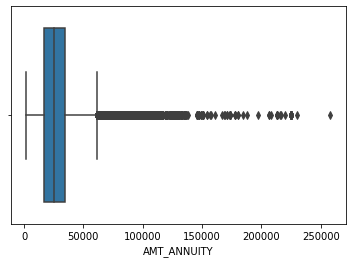

In [19]:
# box plot for AMT_ANNUITY
sns.boxplot(app_data['AMT_ANNUITY'])
plt.show()

**Inference** : By observing the graph , mean value falls after the IQR range , so median is used for filling the null values instead of mean.

In [20]:
# fill null values with median value of AMT_GOODS_PRICE

app_data['AMT_ANNUITY'].fillna(value=app_data['AMT_ANNUITY'].median(), inplace=True)

In [21]:
#Checking if the null values in AMT_ANNUITY Columns are deleted
app_data['AMT_ANNUITY'].isnull().sum()

0

#### AMT_GOODS_PRICE                

In [22]:
app_data['AMT_GOODS_PRICE'].dtype

dtype('float64')

In [23]:
#checking number of null values in AMT_GOODS_PRICE column.
app_data['AMT_GOODS_PRICE'].isnull().sum()

278

In [24]:
#checking descriptive summary of AMT_GOODS_PRICE column
round(app_data['AMT_GOODS_PRICE'].describe())

count    307233.0 
mean     538396.0 
std      369446.0 
min      40500.0  
25%      238500.0 
50%      450000.0 
75%      679500.0 
max      4050000.0
Name: AMT_GOODS_PRICE, dtype: float64

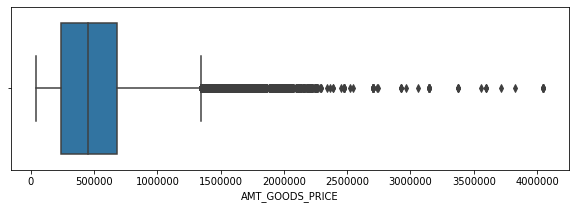

In [25]:
# box plot for AMT_GOODS_PRICE
plt.figure(figsize=[10,3])
sns.boxplot(app_data['AMT_GOODS_PRICE'])
plt.show()

**Inference** : In the above boxplot of AMT_GOODS_PRICE, outliers are clearly visible from the range 2.0-2.5 till 4.0 and above.Using mean might not be the appropriate one if it's about filling up the missing values. So, median will be used here

In [26]:
# fill null values with median value of AMT_GOODS_PRICE

app_data['AMT_GOODS_PRICE'].fillna(value=app_data['AMT_GOODS_PRICE'].median(), inplace=True)

In [27]:
#Checking if the null values in AMT_GOODS_PRICE Columns are deleted

app_data['AMT_GOODS_PRICE'].isnull().sum()

0

#### NAME_TYPE_SUITE                

In [28]:
app_data['NAME_TYPE_SUITE'].dtype

dtype('O')

In [29]:
#checking the null values
app_data['NAME_TYPE_SUITE'].isnull().sum()

1292

In [30]:
# checking the mode of column NAME_TYPE_SUITE
app_data['NAME_TYPE_SUITE'].mode()


0    Unaccompanied
dtype: object

In [31]:
# fill null values with mode value of NAME_TYPE_SUITE
name_type_suite_mode_ = app_data['NAME_TYPE_SUITE'].mode().iloc[0]

app_data['NAME_TYPE_SUITE'].fillna(value=name_type_suite_mode_, inplace=True)


In [32]:
#Checking if the null values in NAME_TYPE_SUITE Columns are deleted

app_data['NAME_TYPE_SUITE'].isnull().sum()

0

#### CNT_FAM_MEMBERS                

In [33]:
app_data['CNT_FAM_MEMBERS'].dtype

dtype('float64')

In [34]:
#checking null values
app_data['CNT_FAM_MEMBERS'].isnull().sum()

2

In [35]:
# checking descriptive summary
round(app_data['CNT_FAM_MEMBERS'].describe())

count    307509.0
mean     2.0     
std      1.0     
min      1.0     
25%      2.0     
50%      2.0     
75%      3.0     
max      20.0    
Name: CNT_FAM_MEMBERS, dtype: float64

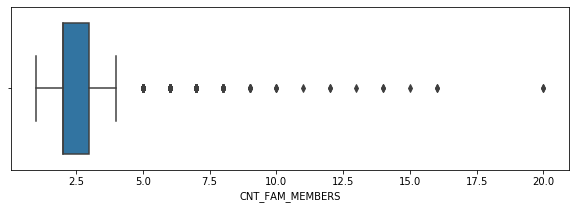

In [36]:
#box plot of the column CNT_FAM_MEMBERS
plt.figure(figsize=[10,3])
sns.boxplot(app_data['CNT_FAM_MEMBERS'])
plt.show()

**Inference** : By observing the graph , we can replace the null values either with mean or with median values.

In [37]:
# fill null values with median value of CNT_FAM_MEMBERS
app_data['CNT_FAM_MEMBERS'].fillna(value=app_data['CNT_FAM_MEMBERS'].median(), inplace=True)

In [38]:
#Checking if the null values in AMT_GOODS_PRICE Columns are deleted

app_data['CNT_FAM_MEMBERS'].isnull().sum()

0

#### AMT_REQ_CREDIT_BUREAU_DAY

In [39]:
app_data['AMT_REQ_CREDIT_BUREAU_DAY'].dtype

dtype('float64')

In [40]:
#checking the null values
app_data['AMT_REQ_CREDIT_BUREAU_DAY'].isnull().sum()

41519

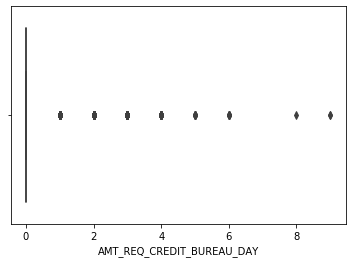

In [41]:
#box plot of the column AMT_REQ_CREDIT_BUREAU_DAY
sns.boxplot(app_data['AMT_REQ_CREDIT_BUREAU_DAY'])
plt.show()

**Inference** : By observing the graph ,its better to fill 0 in the place of null values.

In [42]:
round(app_data['AMT_REQ_CREDIT_BUREAU_DAY'].describe())

count    265992.0
mean     0.0     
std      0.0     
min      0.0     
25%      0.0     
50%      0.0     
75%      0.0     
max      9.0     
Name: AMT_REQ_CREDIT_BUREAU_DAY, dtype: float64

In [43]:
# fill NaN Value with (0)
app_data['AMT_REQ_CREDIT_BUREAU_DAY'].fillna(value=0, inplace=True)

In [44]:
#Checking if the null values in AMT_REQ_CREDIT_BUREAU_DAY Columns are deleted
app_data['AMT_REQ_CREDIT_BUREAU_DAY'].isnull().sum()

0

#### Check the remaining AMT_REQ_CREDIT_BUREAU columns

In [45]:
# describe AMT_REQ_CREDIT_BUREAU
app_data.loc[:,'AMT_REQ_CREDIT_BUREAU_HOUR' : 'AMT_REQ_CREDIT_BUREAU_YEAR'].describe()

,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR
count,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,0.006402,0.267395,0.265474,0.034362,1.899974
std,0.083849,0.916002,0.794056,0.204685,1.869295
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.000000,0.000000,0.000000,0.000000,3.000000
max,4.000000,27.000000,261.000000,8.000000,25.000000


In [46]:
# fill NaN Value with (0)
app_data['AMT_REQ_CREDIT_BUREAU_HOUR'].fillna(value=0, inplace=True)
app_data['AMT_REQ_CREDIT_BUREAU_MON'].fillna(value=0, inplace=True)
app_data['AMT_REQ_CREDIT_BUREAU_QRT'].fillna(value=0, inplace=True)
app_data['AMT_REQ_CREDIT_BUREAU_WEEK'].fillna(value=0, inplace=True)
app_data['AMT_REQ_CREDIT_BUREAU_YEAR'].fillna(value=0, inplace=True)

In [47]:
#Checking if the null values in remaining AMT_REQ_CREDIT_BUREAU Columns are deleted
app_data.loc[:,'AMT_REQ_CREDIT_BUREAU_HOUR' : 'AMT_REQ_CREDIT_BUREAU_YEAR'].isnull().sum()

AMT_REQ_CREDIT_BUREAU_HOUR    0
AMT_REQ_CREDIT_BUREAU_MON     0
AMT_REQ_CREDIT_BUREAU_QRT     0
AMT_REQ_CREDIT_BUREAU_WEEK    0
AMT_REQ_CREDIT_BUREAU_YEAR    0
dtype: int64

In [48]:
# checking Null values in application dataset are cleared
app_data.isnull().sum()

AMT_ANNUITY                    0
AMT_CREDIT                     0
AMT_GOODS_PRICE                0
AMT_INCOME_TOTAL               0
AMT_REQ_CREDIT_BUREAU_DAY      0
AMT_REQ_CREDIT_BUREAU_HOUR     0
AMT_REQ_CREDIT_BUREAU_MON      0
AMT_REQ_CREDIT_BUREAU_QRT      0
AMT_REQ_CREDIT_BUREAU_WEEK     0
AMT_REQ_CREDIT_BUREAU_YEAR     0
CNT_CHILDREN                   0
CNT_FAM_MEMBERS                0
CODE_GENDER                    0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_ID_PUBLISH                0
DAYS_REGISTRATION              0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
HOUR_APPR_PROCESS_START        0
LIVE_CITY_NOT_WORK_CITY        0
LIVE_REGION_NOT_WORK_REGION    0
NAME_CONTRACT_TYPE             0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
NAME_INCOME_TYPE               0
NAME_TYPE_SUITE                0
ORGANIZATION_TYPE              0
REG_CITY_NOT_LIVE_CITY         0
REG_CITY_N

## Imputing the values


### Imputing the values in application data


In [49]:
app_data.dtypes

AMT_ANNUITY                    float64
AMT_CREDIT                     float64
AMT_GOODS_PRICE                float64
AMT_INCOME_TOTAL               float64
AMT_REQ_CREDIT_BUREAU_DAY      float64
AMT_REQ_CREDIT_BUREAU_HOUR     float64
AMT_REQ_CREDIT_BUREAU_MON      float64
AMT_REQ_CREDIT_BUREAU_QRT      float64
AMT_REQ_CREDIT_BUREAU_WEEK     float64
AMT_REQ_CREDIT_BUREAU_YEAR     float64
CNT_CHILDREN                   int64  
CNT_FAM_MEMBERS                float64
CODE_GENDER                    object 
DAYS_BIRTH                     int64  
DAYS_EMPLOYED                  int64  
DAYS_ID_PUBLISH                int64  
DAYS_REGISTRATION              float64
FLAG_OWN_CAR                   object 
FLAG_OWN_REALTY                object 
HOUR_APPR_PROCESS_START        int64  
LIVE_CITY_NOT_WORK_CITY        int64  
LIVE_REGION_NOT_WORK_REGION    int64  
NAME_CONTRACT_TYPE             object 
NAME_EDUCATION_TYPE            object 
NAME_FAMILY_STATUS             object 
NAME_HOUSING_TYPE        

#### CODE_GENDER

In [50]:
#checking value counts
app_data['CODE_GENDER'].value_counts(normalize=True) * 100

F      65.834393
M      34.164306
XNA    0.001301 
Name: CODE_GENDER, dtype: float64

In [51]:
# replace XNA with mode (F)
app_data['CODE_GENDER'] = app_data['CODE_GENDER'].replace('XNA', 'F')

In [52]:
#checking whether the XNA are replaced 
app_data['CODE_GENDER'].value_counts(normalize=True) * 100

F    65.835694
M    34.164306
Name: CODE_GENDER, dtype: float64

#### ORGANIZATION_TYPE

In [53]:
#checking value counts
app_data['ORGANIZATION_TYPE'].value_counts(normalize=True) * 100

Business Entity Type 3    22.110429
XNA                       18.007161
Self-employed             12.491260
Other                     5.425172 
Medicine                  3.639870 
Business Entity Type 2    3.431747 
Government                3.383294 
School                    2.891929 
Trade: type 7             2.546576 
Kindergarten              2.237318 
Construction              2.185613 
Business Entity Type 1    1.945947 
Transport: type 4         1.755384 
Trade: type 3             1.135569 
Industry: type 9          1.095245 
Industry: type 3          1.065978 
Security                  1.055897 
Housing                   0.961917 
Industry: type 11         0.879318 
Military                  0.856555 
Bank                      0.815255 
Agriculture               0.798020 
Police                    0.761274 
Transport: type 2         0.716722 
Postal                    0.701438 
Security Ministries       0.641928 
Trade: type 2             0.617864 
Restaurant                0.

In [54]:
# replace XNA with Other
app_data['ORGANIZATION_TYPE'] = app_data['ORGANIZATION_TYPE'].replace('XNA', 'Other')

In [55]:
#checking again the organization type
app_data['ORGANIZATION_TYPE'].value_counts(normalize=True) * 100

Other                     23.432333
Business Entity Type 3    22.110429
Self-employed             12.491260
Medicine                  3.639870 
Business Entity Type 2    3.431747 
Government                3.383294 
School                    2.891929 
Trade: type 7             2.546576 
Kindergarten              2.237318 
Construction              2.185613 
Business Entity Type 1    1.945947 
Transport: type 4         1.755384 
Trade: type 3             1.135569 
Industry: type 9          1.095245 
Industry: type 3          1.065978 
Security                  1.055897 
Housing                   0.961917 
Industry: type 11         0.879318 
Military                  0.856555 
Bank                      0.815255 
Agriculture               0.798020 
Police                    0.761274 
Transport: type 2         0.716722 
Postal                    0.701438 
Security Ministries       0.641928 
Trade: type 2             0.617864 
Restaurant                0.588922 
Services                  0.

## <font color = black>Handling Outliers :</font>

### <font color = black>Handling Outliers in Application Data :</font>

In [56]:
round(app_data.describe())

,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,...,DAYS_REGISTRATION,HOUR_APPR_PROCESS_START,LIVE_CITY_NOT_WORK_CITY,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,SK_ID_CURR,TARGET
count,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,...,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0
mean,27108.0,599026.0,538316.0,168798.0,0.0,0.0,0.0,0.0,0.0,2.0,...,-4986.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,278181.0,0.0
std,14493.0,402491.0,369289.0,237123.0,0.0,0.0,1.0,1.0,0.0,2.0,...,3523.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,102790.0,0.0
min,1616.0,45000.0,40500.0,25650.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-24672.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,100002.0,0.0
25%,16524.0,270000.0,238500.0,112500.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-7480.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,189146.0,0.0
50%,24903.0,513531.0,450000.0,147150.0,0.0,0.0,0.0,0.0,0.0,1.0,...,-4504.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,278202.0,0.0
75%,34596.0,808650.0,679500.0,202500.0,0.0,0.0,0.0,0.0,0.0,3.0,...,-2010.0,14.0,0.0,0.0,0.0,0.0,0.0,0.0,367142.0,0.0
max,258026.0,4050000.0,4050000.0,117000000.0,9.0,4.0,27.0,261.0,8.0,25.0,...,0.0,23.0,1.0,1.0,1.0,1.0,1.0,1.0,456255.0,1.0


In [57]:
app_data.dtypes

AMT_ANNUITY                    float64
AMT_CREDIT                     float64
AMT_GOODS_PRICE                float64
AMT_INCOME_TOTAL               float64
AMT_REQ_CREDIT_BUREAU_DAY      float64
AMT_REQ_CREDIT_BUREAU_HOUR     float64
AMT_REQ_CREDIT_BUREAU_MON      float64
AMT_REQ_CREDIT_BUREAU_QRT      float64
AMT_REQ_CREDIT_BUREAU_WEEK     float64
AMT_REQ_CREDIT_BUREAU_YEAR     float64
CNT_CHILDREN                   int64  
CNT_FAM_MEMBERS                float64
CODE_GENDER                    object 
DAYS_BIRTH                     int64  
DAYS_EMPLOYED                  int64  
DAYS_ID_PUBLISH                int64  
DAYS_REGISTRATION              float64
FLAG_OWN_CAR                   object 
FLAG_OWN_REALTY                object 
HOUR_APPR_PROCESS_START        int64  
LIVE_CITY_NOT_WORK_CITY        int64  
LIVE_REGION_NOT_WORK_REGION    int64  
NAME_CONTRACT_TYPE             object 
NAME_EDUCATION_TYPE            object 
NAME_FAMILY_STATUS             object 
NAME_HOUSING_TYPE        

#### AMT_ANNUITY

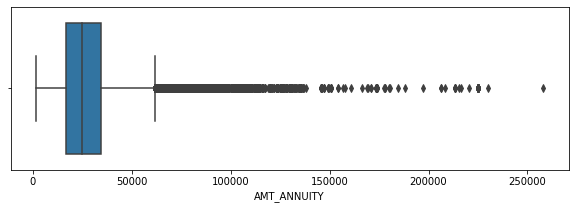

In [58]:
#box plot to check the outliers
plt.figure(figsize=[10,3])
sns.boxplot(app_data['AMT_ANNUITY'])
plt.show()

In [59]:
app_data['AMT_ANNUITY'].describe()

count    307511.000000
mean     27108.487841 
std      14493.461065 
min      1615.500000  
25%      16524.000000 
50%      24903.000000 
75%      34596.000000 
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

In [60]:
app_data.AMT_ANNUITY.quantile([0.75,0.80,0.85,0.90,0.95,0.98,0.99])

0.75    34596.0
0.80    37516.5
0.85    40806.0
0.90    45954.0
0.95    53325.0
0.98    62964.0
0.99    70006.5
Name: AMT_ANNUITY, dtype: float64

**Inference** : Here, in the coloumn 'AMT_ANNUITY' which tells the loan annuity. We observe a value which is greater than 258000 which is surely an outlier.

#### AMT_CREDIT

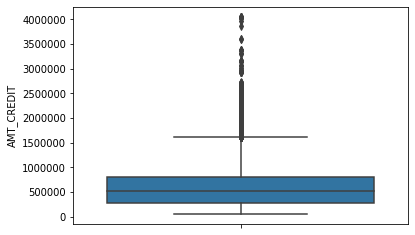

In [61]:
#Analysing the outliers in app_data table (AMT_CREDIT)
sns.boxplot(data=app_data,y='AMT_CREDIT');

In [62]:
round(app_data['AMT_CREDIT'].describe())

count    307511.0 
mean     599026.0 
std      402491.0 
min      45000.0  
25%      270000.0 
50%      513531.0 
75%      808650.0 
max      4050000.0
Name: AMT_CREDIT, dtype: float64

In [63]:
app_data.AMT_CREDIT.quantile([0.75,0.80,0.85,0.90,0.95,0.98,0.99])

0.75    808650.0 
0.80    900000.0 
0.85    1024740.0
0.90    1133748.0
0.95    1350000.0
0.98    1661418.0
0.99    1854000.0
Name: AMT_CREDIT, dtype: float64

**Inference** :  Here, in the coloumn 'AMT_CREDIT' which tells the loan credit. We observe a value which are greater than the 99  qunatile are surely an outliers.

#### AMT_GOODS_PRICE

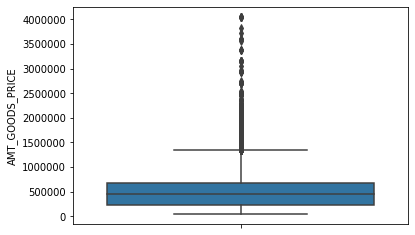

In [64]:
#Analysing the outliers in app_data table (AMT_GOODS_PRICE)
sns.boxplot(data=app_data,y='AMT_GOODS_PRICE');

In [65]:
round(app_data['AMT_GOODS_PRICE'].describe())

count    307511.0 
mean     538316.0 
std      369289.0 
min      40500.0  
25%      238500.0 
50%      450000.0 
75%      679500.0 
max      4050000.0
Name: AMT_GOODS_PRICE, dtype: float64

In [66]:
app_data.AMT_GOODS_PRICE.quantile([0.75,0.80,0.85,0.90,0.95,0.98,0.99])

0.75    679500.0 
0.80    814500.0 
0.85    900000.0 
0.90    1093500.0
0.95    1305000.0
0.98    1575000.0
0.99    1800000.0
Name: AMT_GOODS_PRICE, dtype: float64

**Inference** :  Here, in the coloumn 'AMT_CREDIT' which tells the loan credit. We observe a value which are greater than the 90  qunatile are surely an outliers.

#### AMT_INCOME_TOTAL

In [67]:
round(app_data['AMT_INCOME_TOTAL'].describe())

count    307511.0   
mean     168798.0   
std      237123.0   
min      25650.0    
25%      112500.0   
50%      147150.0   
75%      202500.0   
max      117000000.0
Name: AMT_INCOME_TOTAL, dtype: float64

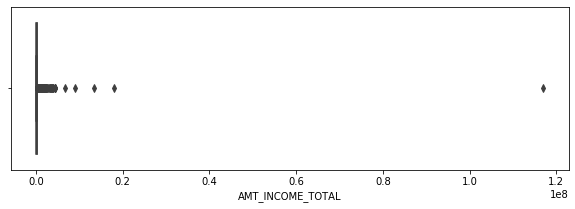

In [68]:
#Analysing the outliers in app_data table (AMT_INCOME_TOTAL)

plt.figure(figsize=[10,3])
sns.boxplot(app_data['AMT_INCOME_TOTAL'])
plt.show()

In [69]:
app_data.AMT_INCOME_TOTAL.quantile([0.75,0.80,0.85,0.90,0.95,0.98,0.99])

0.75    202500.0
0.80    225000.0
0.85    234000.0
0.90    270000.0
0.95    337500.0
0.98    427500.0
0.99    472500.0
Name: AMT_INCOME_TOTAL, dtype: float64

**Inference** : Here, in the coloumn 'AMT_INCOME_TOTAL' which tells us the income of the client. We observe a value of 117M which is surely an outlier.

#### CNT_CHILDREN

In [70]:
round(app_data['CNT_CHILDREN'].describe())

count    307511.0
mean     0.0     
std      1.0     
min      0.0     
25%      0.0     
50%      0.0     
75%      1.0     
max      19.0    
Name: CNT_CHILDREN, dtype: float64

In [71]:
app_data.CNT_CHILDREN.quantile([0.75,0.80,0.85,0.90,0.95,0.98,0.99,1])

0.75    1.0 
0.80    1.0 
0.85    1.0 
0.90    2.0 
0.95    2.0 
0.98    2.0 
0.99    3.0 
1.00    19.0
Name: CNT_CHILDREN, dtype: float64

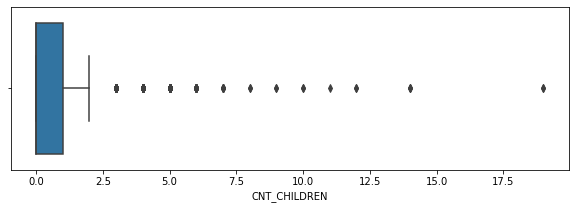

In [72]:
#Analysing the outliers in app_data table (CNT_CHILDREN)

plt.figure(figsize=[10,3])
sns.boxplot(app_data['CNT_CHILDREN'])
plt.show()

**Inference** : By observing the graph , there are outliers after the 0.99 percentile . beacuse the maximum value is 19 and the 0.99 percentile value is 3 .

## <font color = black>Standardising Values :</font>

### <font color = black>Standardising Values in Application data :</font>

In [73]:
app_data.head()

,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,...,NAME_INCOME_TYPE,NAME_TYPE_SUITE,ORGANIZATION_TYPE,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,SK_ID_CURR,TARGET,WEEKDAY_APPR_PROCESS_START
0,24700.5,406597.5,351000.0,202500.0,0.0,0.0,0.0,0.0,0.0,1.0,...,Working,Unaccompanied,Business Entity Type 3,0,0,0,0,100002,1,WEDNESDAY
1,35698.5,1293502.5,1129500.0,270000.0,0.0,0.0,0.0,0.0,0.0,0.0,...,State servant,Family,School,0,0,0,0,100003,0,MONDAY
2,6750.0,135000.0,135000.0,67500.0,0.0,0.0,0.0,0.0,0.0,0.0,...,Working,Unaccompanied,Government,0,0,0,0,100004,0,MONDAY
3,29686.5,312682.5,297000.0,135000.0,0.0,0.0,0.0,0.0,0.0,0.0,...,Working,Unaccompanied,Business Entity Type 3,0,0,0,0,100006,0,WEDNESDAY
4,21865.5,513000.0,513000.0,121500.0,0.0,0.0,0.0,0.0,0.0,0.0,...,Working,Unaccompanied,Religion,0,1,0,0,100007,0,THURSDAY


In [74]:
sorted(app_data.columns)

['AMT_ANNUITY',
 'AMT_CREDIT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_YEAR',
 'CNT_CHILDREN',
 'CNT_FAM_MEMBERS',
 'CODE_GENDER',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_ID_PUBLISH',
 'DAYS_REGISTRATION',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'HOUR_APPR_PROCESS_START',
 'LIVE_CITY_NOT_WORK_CITY',
 'LIVE_REGION_NOT_WORK_REGION',
 'NAME_CONTRACT_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'NAME_INCOME_TYPE',
 'NAME_TYPE_SUITE',
 'ORGANIZATION_TYPE',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'SK_ID_CURR',
 'TARGET',
 'WEEKDAY_APPR_PROCESS_START']

#### DAYS_BIRTH

In [75]:
app_data.DAYS_BIRTH.head()

0   -9461 
1   -16765
2   -19046
3   -19005
4   -19932
Name: DAYS_BIRTH, dtype: int64

In [76]:
# remove sign (-) from DAYS_BIRTH
app_data['DAYS_BIRTH'] = app_data['DAYS_BIRTH'].apply(lambda x: abs(x))
app_data.DAYS_BIRTH.head()

0    9461 
1    16765
2    19046
3    19005
4    19932
Name: DAYS_BIRTH, dtype: int64

#### DAYS_EMPLOYED

In [77]:
app_data.DAYS_EMPLOYED.head()

0   -637 
1   -1188
2   -225 
3   -3039
4   -3038
Name: DAYS_EMPLOYED, dtype: int64

In [78]:
# remove sign (-) from DAYS_EMPLOYED
app_data['DAYS_EMPLOYED'] = app_data['DAYS_EMPLOYED'].apply(lambda x: abs(x))
app_data.DAYS_EMPLOYED.head()

0    637 
1    1188
2    225 
3    3039
4    3038
Name: DAYS_EMPLOYED, dtype: int64

#### DAYS_ID_PUBLISH

In [79]:
app_data.DAYS_ID_PUBLISH.head()

0   -2120
1   -291 
2   -2531
3   -2437
4   -3458
Name: DAYS_ID_PUBLISH, dtype: int64

In [80]:
# remove sign (-) from DAYS_ID_PUBLISH
app_data['DAYS_ID_PUBLISH'] = app_data['DAYS_ID_PUBLISH'].apply(lambda x: abs(x))
app_data.DAYS_ID_PUBLISH.head()

0    2120
1    291 
2    2531
3    2437
4    3458
Name: DAYS_ID_PUBLISH, dtype: int64

#### DAYS_REGISTRATION

In [81]:
app_data.DAYS_REGISTRATION.head()

0   -3648.0
1   -1186.0
2   -4260.0
3   -9833.0
4   -4311.0
Name: DAYS_REGISTRATION, dtype: float64

In [82]:
# remove sign (-) from DAYS_REGISTRATION
app_data['DAYS_REGISTRATION'] = app_data['DAYS_REGISTRATION'].apply(lambda x: abs(x))
app_data.DAYS_REGISTRATION.head()

0    3648.0
1    1186.0
2    4260.0
3    9833.0
4    4311.0
Name: DAYS_REGISTRATION, dtype: float64

In [83]:
app_data.head()

,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,...,NAME_INCOME_TYPE,NAME_TYPE_SUITE,ORGANIZATION_TYPE,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,SK_ID_CURR,TARGET,WEEKDAY_APPR_PROCESS_START
0,24700.5,406597.5,351000.0,202500.0,0.0,0.0,0.0,0.0,0.0,1.0,...,Working,Unaccompanied,Business Entity Type 3,0,0,0,0,100002,1,WEDNESDAY
1,35698.5,1293502.5,1129500.0,270000.0,0.0,0.0,0.0,0.0,0.0,0.0,...,State servant,Family,School,0,0,0,0,100003,0,MONDAY
2,6750.0,135000.0,135000.0,67500.0,0.0,0.0,0.0,0.0,0.0,0.0,...,Working,Unaccompanied,Government,0,0,0,0,100004,0,MONDAY
3,29686.5,312682.5,297000.0,135000.0,0.0,0.0,0.0,0.0,0.0,0.0,...,Working,Unaccompanied,Business Entity Type 3,0,0,0,0,100006,0,WEDNESDAY
4,21865.5,513000.0,513000.0,121500.0,0.0,0.0,0.0,0.0,0.0,0.0,...,Working,Unaccompanied,Religion,0,1,0,0,100007,0,THURSDAY


## Fixing Invalid Values and Filter Data :

In [84]:
sorted(app_data.columns)

['AMT_ANNUITY',
 'AMT_CREDIT',
 'AMT_GOODS_PRICE',
 'AMT_INCOME_TOTAL',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_YEAR',
 'CNT_CHILDREN',
 'CNT_FAM_MEMBERS',
 'CODE_GENDER',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_ID_PUBLISH',
 'DAYS_REGISTRATION',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'HOUR_APPR_PROCESS_START',
 'LIVE_CITY_NOT_WORK_CITY',
 'LIVE_REGION_NOT_WORK_REGION',
 'NAME_CONTRACT_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'NAME_INCOME_TYPE',
 'NAME_TYPE_SUITE',
 'ORGANIZATION_TYPE',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'SK_ID_CURR',
 'TARGET',
 'WEEKDAY_APPR_PROCESS_START']

### Convert AMT_INCOME_TOTAL values into Categorical values

In [85]:
#Creating bin variable

app_data['AMT_INCOME_TOTAL'] =pd.qcut(app_data.AMT_INCOME_TOTAL, q=[0, 0.2, 0.5, 0.8, 0.95, 1],
                                      labels=['VERY_LOW', 'LOW', "MEDIUM", 'HIGH', 'VERY_HIGH']
                                      )

In [86]:
app_data['AMT_INCOME_TOTAL'].values

[MEDIUM, HIGH, VERY_LOW, LOW, LOW, ..., MEDIUM, VERY_LOW, MEDIUM, MEDIUM, MEDIUM]
Length: 307511
Categories (5, object): [VERY_LOW < LOW < MEDIUM < HIGH < VERY_HIGH]

### Create Age Column using DAYS_BIRTH

In [87]:
# Converting days of birth into years
app_data['AGE'] = (app_data['DAYS_BIRTH'] // 365.25)

In [88]:
app_data.drop(['DAYS_BIRTH'], axis=1, inplace=True)

In [89]:
#Creating binned variable for AGE
app_data['AGE_GROUP'] = pd.cut(app_data['AGE'],bins=[20,30,40,50,60,100],labels=['20-30', '30-40', '40-50', '50-60', '60_above'])
app_data['AGE_GROUP'].value_counts()

30-40       83212
40-50       74347
50-60       67864
20-30       52963
60_above    29124
Name: AGE_GROUP, dtype: int64

### Converting the DAYS_EMPLOYED columns in Years


In [90]:
#Converting the DAYS_EMPLOYED columns in Years
app_data['DAYS_EMPLOYED'] = app_data['DAYS_EMPLOYED'].apply(lambda x:(x/365))

In [91]:
#Renaming the DAYS_EMPLOYED column
app_data.rename(columns = {'DAYS_EMPLOYED':'YRS_EMPLOYED'}, inplace = True) 

In [92]:
#Analysing the YRS_EMPLOYED column from app_data dataframe
app_data['YRS_EMPLOYED'].head()

0    1.745205
1    3.254795
2    0.616438
3    8.326027
4    8.323288
Name: YRS_EMPLOYED, dtype: float64

### Converting the DAYS_ID_PUBLISH columns in Years


In [93]:
app_data['DAYS_ID_PUBLISH']

0         2120
1         291 
2         2531
3         2437
4         3458
5         477 
6         619 
7         2379
8         3514
9         3992
10        738 
11        2512
12        3227
13        4911
14        2056
15        1368
16        3866
17        2427
18        1259
19        3964
20        1800
21        2299
22        2518
23        3684
24        3729
25        2893
26        1827
27        3153
28        2661
29        3015
30        3787
31        2904
32        4464
33        3557
34        4067
35        2009
36        735 
37        4270
38        4969
39        4292
40        1029
41        513 
42        4409
43        4576
44        2380
45        642 
46        1993
47        3283
48        3199
49        1797
50        2576
51        1937
52        1992
53        1240
54        2142
55        5164
56        1344
57        1721
58        4982
59        566 
60        2177
61        586 
62        3967
63        4541
64        4097
65        1   
66        

In [94]:
app_data['DAYS_ID_PUBLISH_ORIGINAL'] = app_data['DAYS_ID_PUBLISH']
app_data['DAYS_ID_PUBLISH'] = app_data['DAYS_ID_PUBLISH_ORIGINAL'].apply(lambda x:(x/365))
app_data.rename(columns = {'DAYS_ID_PUBLISH':'YRS_ID_PUBLISH'}, inplace = True) 
app_data['YRS_ID_PUBLISH'].head()

0    5.808219
1    0.797260
2    6.934247
3    6.676712
4    9.473973
Name: YRS_ID_PUBLISH, dtype: float64

### Converting the DAYS_REGISTRATION columns in Years


In [95]:
app_data['DAYS_REGISTRATION']

0         3648.00000 
1         1186.00000 
2         4260.00000 
3         9833.00000 
4         4311.00000 
5         4970.00000 
6         1213.00000 
7         4597.00000 
8         7427.00000 
9         14437.00000
10        4427.00000 
11        5246.00000 
12        311.00000  
13        643.00000  
14        615.00000  
15        3494.00000 
16        6392.00000 
17        4143.00000 
18        8751.00000 
19        1021.00000 
20        298.00000  
21        2299.00000 
22        114.00000  
23        9012.00000 
24        108.00000  
25        2419.00000 
26        6573.00000 
27        5782.00000 
28        4668.00000 
29        4799.00000 
30        5266.00000 
31        7846.00000 
32        7123.00000 
33        3557.00000 
34        5735.00000 
35        6265.00000 
36        63.00000   
37        5474.00000 
38        9817.00000 
39        8236.00000 
40        1182.00000 
41        3148.00000 
42        45.00000   
43        5745.00000 
44        4166.00000 
45        

In [96]:
app_data['DAYS_REGISTRATION_ORIGINAL'] = app_data['DAYS_REGISTRATION']
app_data['DAYS_REGISTRATION'] = app_data['DAYS_REGISTRATION_ORIGINAL'].apply(lambda x:(x/365))
app_data.rename(columns = {'DAYS_REGISTRATION':'YRS_REGISTRATION'}, inplace = True) 
app_data['YRS_REGISTRATION'].head()

0    9.994521 
1    3.249315 
2    11.671233
3    26.939726
4    11.810959
Name: YRS_REGISTRATION, dtype: float64

In [97]:
app_data.columns

Index(['AMT_ANNUITY', 'AMT_CREDIT', 'AMT_GOODS_PRICE', 'AMT_INCOME_TOTAL',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_YEAR',
       'CNT_CHILDREN', 'CNT_FAM_MEMBERS', 'CODE_GENDER', 'YRS_EMPLOYED',
       'YRS_ID_PUBLISH', 'YRS_REGISTRATION', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'HOUR_APPR_PROCESS_START', 'LIVE_CITY_NOT_WORK_CITY',
       'LIVE_REGION_NOT_WORK_REGION', 'NAME_CONTRACT_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'NAME_INCOME_TYPE', 'NAME_TYPE_SUITE', 'ORGANIZATION_TYPE',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'SK_ID_CURR', 'TARGET', 'WEEKDAY_APPR_PROCESS_START', 'AGE',
       'AGE_GROUP', 'DAYS_ID_PUBLISH_ORIGINAL', 'DAYS_REGISTRATION_ORIGINAL'],
      dtype='object')

## Data Imbalance

In [98]:
app_data['TARGET'].value_counts()

0    282686
1    24825 
Name: TARGET, dtype: int64

In [99]:
# imbalance ratio
count0=(app_data['TARGET'] == 0).sum()
count1=(app_data['TARGET'] == 1).sum()

count0 = (count0/len(app_data['TARGET']))*100
count1 = (count1/len(app_data['TARGET']))*100

In [100]:
# imbalance ratio

ratio = count0 / count1
round(ratio, 1)

11.4

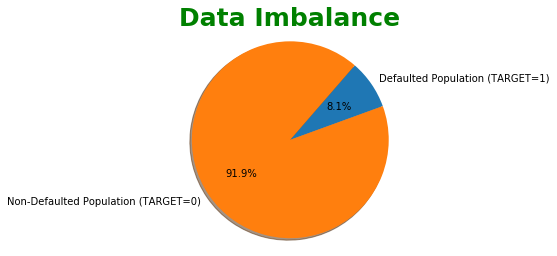

In [101]:
# pie chart for data imbalance 
x = ['Defaulted Population (TARGET=1)','Non-Defaulted Population (TARGET=0)']
y = [count1, count0]

fig1, ax1 = plt.subplots()
ax1.pie(y, labels=x, autopct='%1.1f%%',shadow=True, startangle=20)
ax1.axis('equal') 
plt.title('Data Imbalance',fontsize=25, color='green', fontweight='bold')
plt.show()

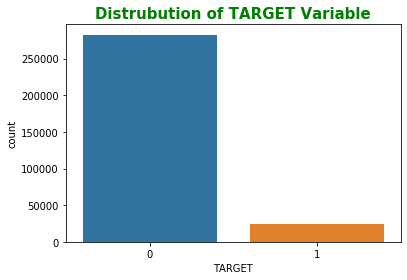

In [102]:
# distribution of target variable using countplot

sns.countplot(app_data['TARGET'])
plt.title('Distrubution of TARGET Variable', fontsize=15, color='green', fontweight='bold')
plt.show()

 ## Univariate Analysis

In [103]:
app_data.dtypes

AMT_ANNUITY                    float64 
AMT_CREDIT                     float64 
AMT_GOODS_PRICE                float64 
AMT_INCOME_TOTAL               category
AMT_REQ_CREDIT_BUREAU_DAY      float64 
AMT_REQ_CREDIT_BUREAU_HOUR     float64 
AMT_REQ_CREDIT_BUREAU_MON      float64 
AMT_REQ_CREDIT_BUREAU_QRT      float64 
AMT_REQ_CREDIT_BUREAU_WEEK     float64 
AMT_REQ_CREDIT_BUREAU_YEAR     float64 
CNT_CHILDREN                   int64   
CNT_FAM_MEMBERS                float64 
CODE_GENDER                    object  
YRS_EMPLOYED                   float64 
YRS_ID_PUBLISH                 float64 
YRS_REGISTRATION               float64 
FLAG_OWN_CAR                   object  
FLAG_OWN_REALTY                object  
HOUR_APPR_PROCESS_START        int64   
LIVE_CITY_NOT_WORK_CITY        int64   
LIVE_REGION_NOT_WORK_REGION    int64   
NAME_CONTRACT_TYPE             object  
NAME_EDUCATION_TYPE            object  
NAME_FAMILY_STATUS             object  
NAME_HOUSING_TYPE              object  


### Categorical  univariate analysis for Application data


In [104]:
target_0 = app_data[app_data['TARGET']==0]
target_1 = app_data[app_data['TARGET']==1]
# function of plot for categorical variables
def univariate_categorical(column):
    plt.figure(figsize=[17,5])

    plt.subplot(1,2,1)
    sns.countplot(data=target_1, x=sorted(target_1[column]))
    plt.title('Distribution of '+ '%s' %column +' on Defaulters',
              fontdict={'size':12, 'color':'red', 'fontweight':'bold'})
    plt.xticks(rotation=90)

    plt.subplot(1,2,2)
    sns.countplot(data=target_0, x=sorted(target_0[column]))
    plt.title('Distribution of '+ '%s' %column +' on Non-Defaulters',
              fontdict={'size':12, 'color':'red', 'fontweight':'bold'})
    plt.xticks(rotation=90)

    plt.show()
def univariate_categorical_per(column):
    plt.figure(0,figsize=(17,5))
    plt.subplot(1,2,1)
    y = list(pd.DataFrame(100*(target_1.groupby(column)[column].count()/len(target_1.index))).transpose().columns)
    x = list(pd.DataFrame(100*(target_1.groupby(column)[column].count()/len(target_1.index))).transpose().iloc[0,:])
    ax = sns.barplot(x=y, y=x)
    plt.title('% contribution of each category of '+ '%s' %column +' on Defaulters',
              fontdict={'size':12, 'color':'red', 'fontweight':'bold'})
    
    plt.ylim([0,100])
    plt.xticks(rotation=90)


    plt.subplot(1,2,2)
    y1 = list(pd.DataFrame(100*(target_0.groupby(column)[column].count()/len(target_0.index))).transpose().columns)
    x1 = list(pd.DataFrame(100*(target_0.groupby(column)[column].count()/len(target_0.index))).transpose().iloc[0,:])
    ax = sns.barplot(x=y1, y=x1)
    plt.title('% contribution of each category of '+ '%s' %column +' on non Defaulters',
              fontdict={'size':12, 'color':'red', 'fontweight':'bold'})
    plt.ylim([0,100])
    plt.xticks(rotation=90)


    plt.show()    

#### NAME_FAMILY_STATUS

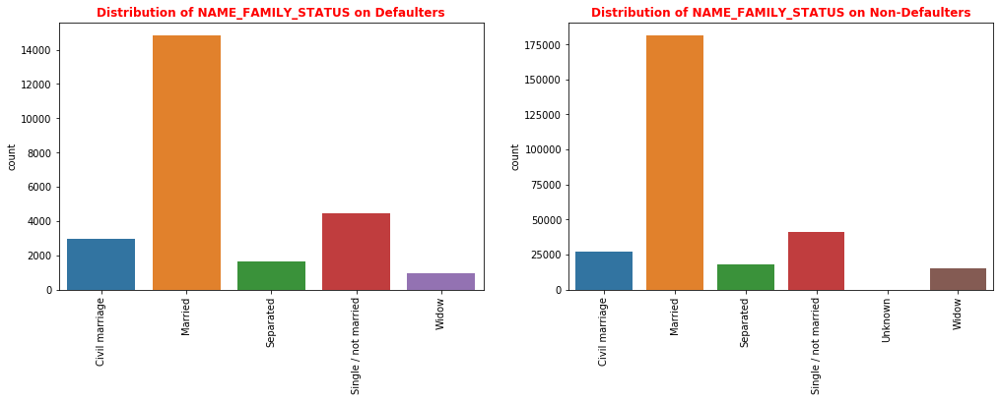

In [105]:
# Analysis of Family Status
univariate_categorical('NAME_FAMILY_STATUS')

**`Inference:`** Most of population are Married. Single / not married is proportionally higher in dafaulted population as compared to non defaulted population. This concludes that Single applicants have higher defaults.

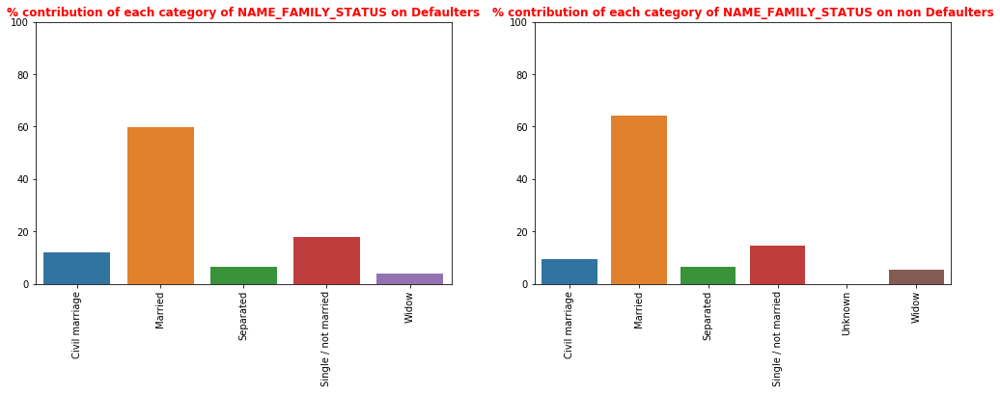

In [106]:

univariate_categorical_per('NAME_FAMILY_STATUS')

**`Inference:`** We observe a decrease in the percentage of married and widowed with Loan Payment Difficulties and an increase in the the percentage of single and civil married with Loan Payment Difficulties when comapred with the percentages of both Loan Payment Difficulties and Loan Non-Payment Difficulties

#### NAME_HOUSING_TYPE

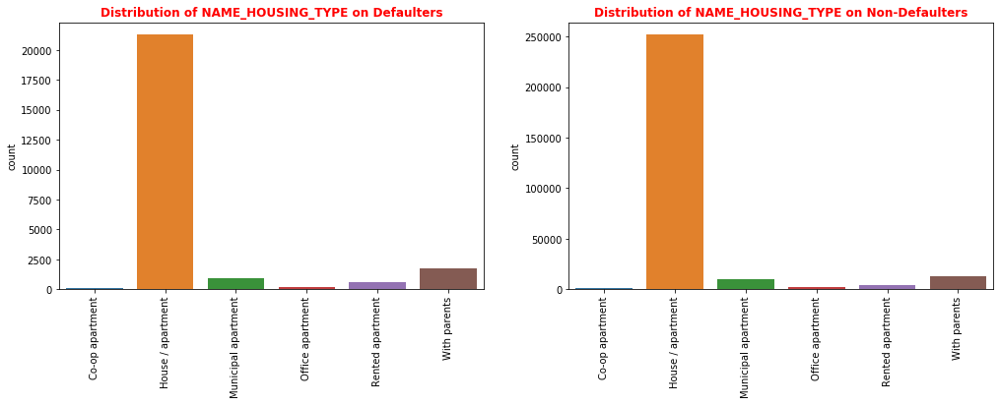

In [107]:
#Analysis of Housing Type
univariate_categorical('NAME_HOUSING_TYPE')

**`Inference:`**
1.Population living in Rented apartments have higher default rate. Those population living in rental apartment means a cash outflow towards rent is more thus less cash left for repayment of loan.

2.Population living in with parents have higher default rate. Those population living with parents may suggest that the income is not too high thus they face difficulty in repayment of loan.

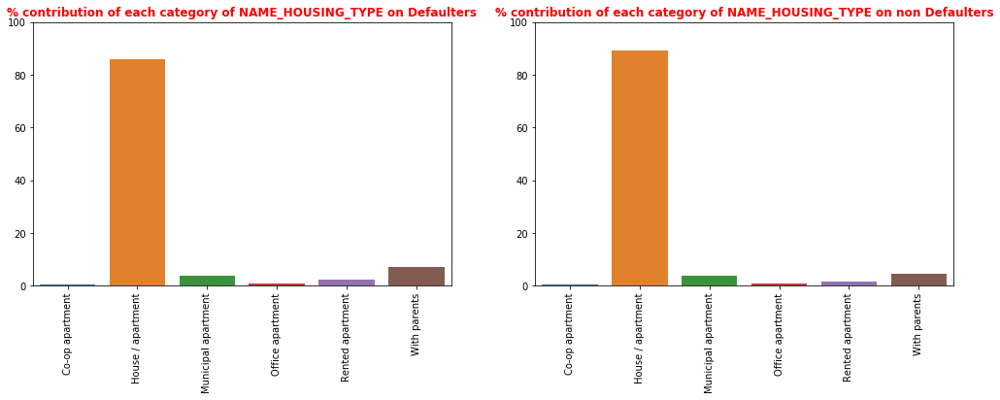

In [108]:
univariate_categorical_per("NAME_HOUSING_TYPE")

**`Inference:`**
We observe an increase in the percentage of Payment Difficulties who live with their parents when compared to the percentages of Payment Difficulties and non-Payment Difficulties
    

#### NAME_INCOME_TYPE

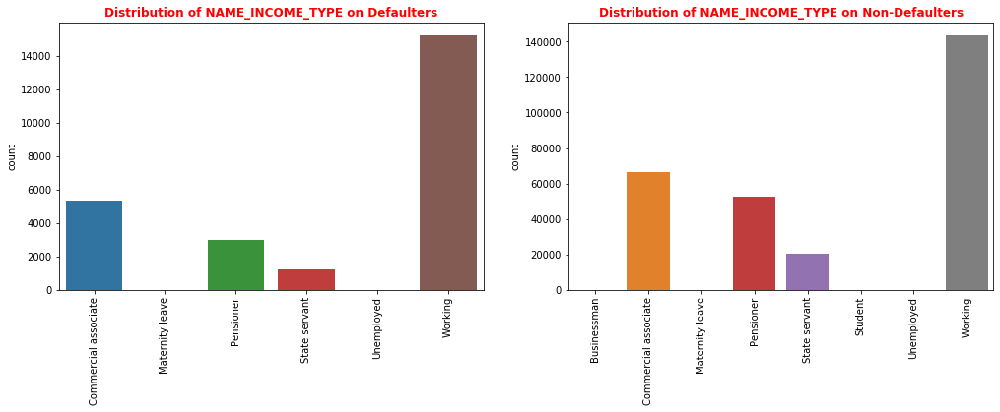

In [109]:
#Analysis of Income Type
univariate_categorical('NAME_INCOME_TYPE')

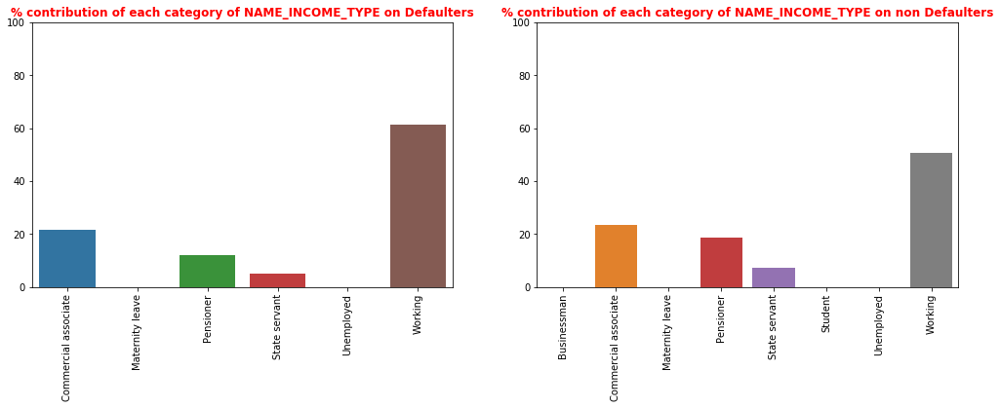

In [110]:
univariate_categorical_per('NAME_INCOME_TYPE')

**`Inference`** :
- It seems like most of the defaulters are the working people, so as in Non-Defaulter.And there seems to be moderate rate in Commercial associate, Pensioner and state servant. 

- Least count to be seen in Unemployed, Maternity Leave, Businessman and Student.

#### NAME_TYPE_SUITE

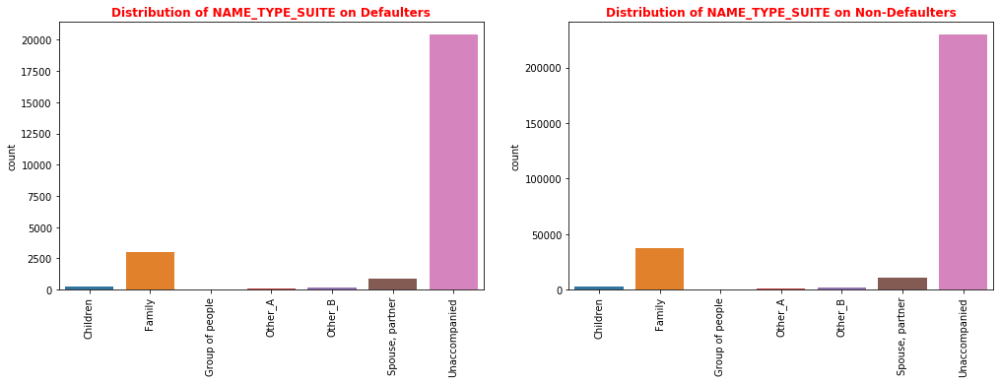

In [111]:
#Analysis of Suite Type
univariate_categorical('NAME_TYPE_SUITE')

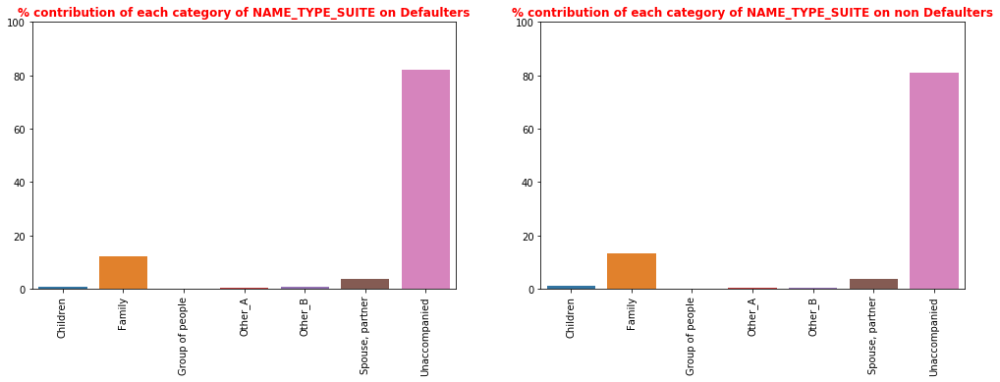

In [112]:
univariate_categorical_per('NAME_TYPE_SUITE')

**`Inference`** :
We do not observe any major changes here.

#### AMT_INCOME_TOTAL 

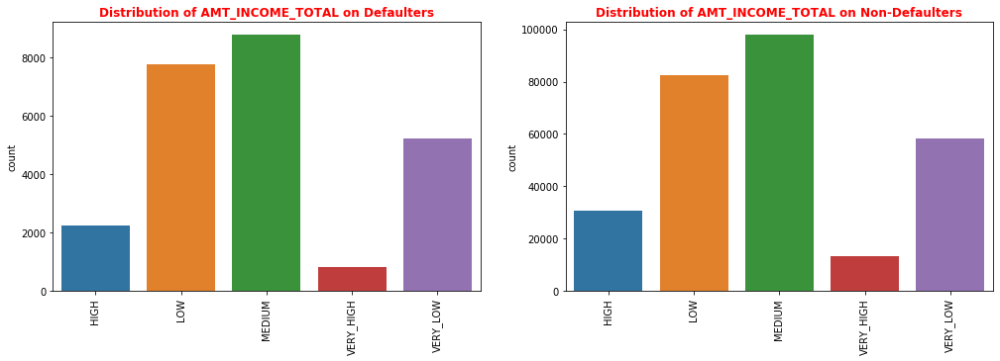

In [113]:
# Analysis of Income Total
univariate_categorical('AMT_INCOME_TOTAL')

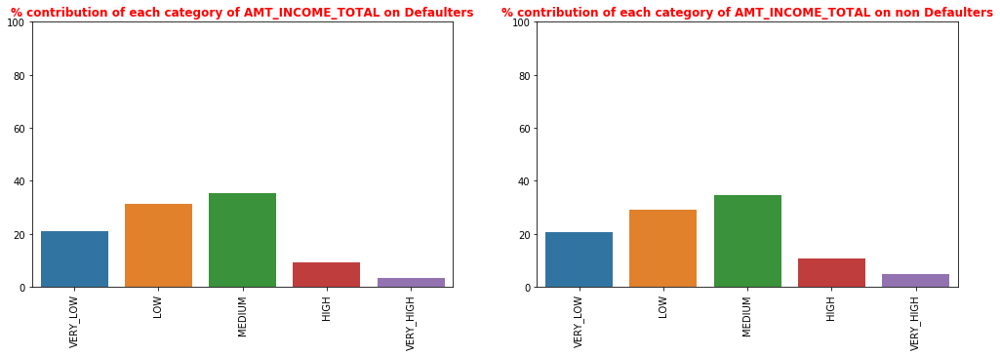

In [114]:
univariate_categorical_per('AMT_INCOME_TOTAL')

**`Inference`** :
We observe an increase in the percentage of Loan Payment Difficulties whose income is medium when compared with the percentages of Payment Difficulties and Loan-Non Payment Difficulties

#### CODE_GENDER

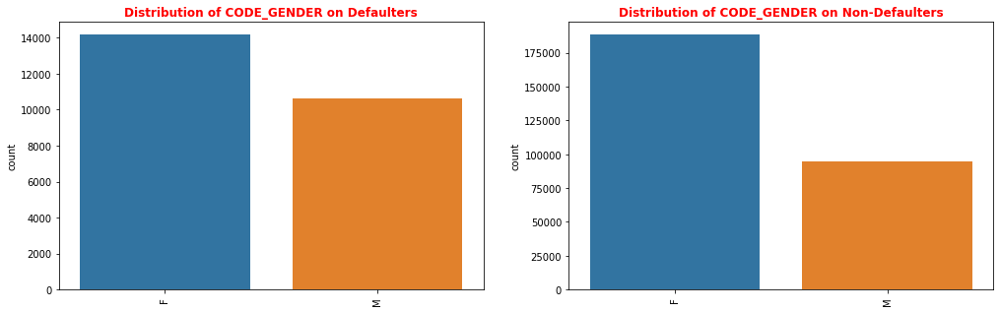

In [115]:
# Gender Analysis
univariate_categorical('CODE_GENDER')

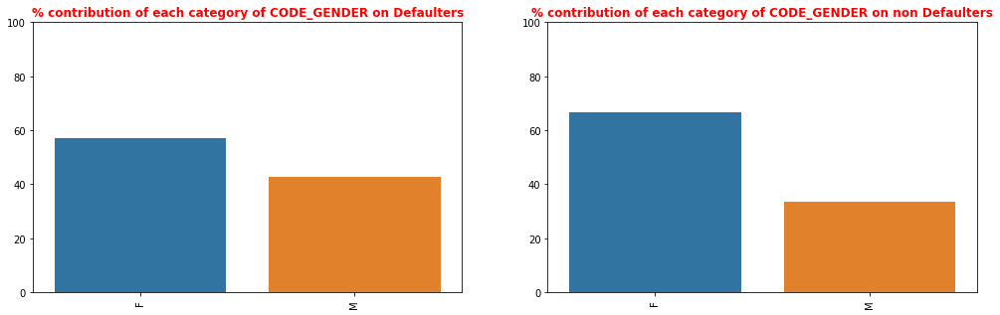

In [116]:
univariate_categorical_per('CODE_GENDER')

**`Inference`** :
Comaparing the Payment Difficulties and Non Payment Difficulties on the basis of Gender, we observe that Females are the majority in both the cases although there is an increase in the percentage in Male Payment Difficulties from Non-Payment Difficulties.
Undoubtedly, most females have applied for loan than males.

#### AGE_GROUP

In [117]:
app_data['AGE_GROUP'].value_counts()

30-40       83212
40-50       74347
50-60       67864
20-30       52963
60_above    29124
Name: AGE_GROUP, dtype: int64

In [118]:
target_0['AGE_GROUP'].value_counts()

30-40       75493
40-50       68730
50-60       63840
20-30       46929
60_above    27693
Name: AGE_GROUP, dtype: int64

In [119]:
target_1['AGE_GROUP'].value_counts()

30-40       7719
20-30       6034
40-50       5617
50-60       4024
60_above    1431
Name: AGE_GROUP, dtype: int64

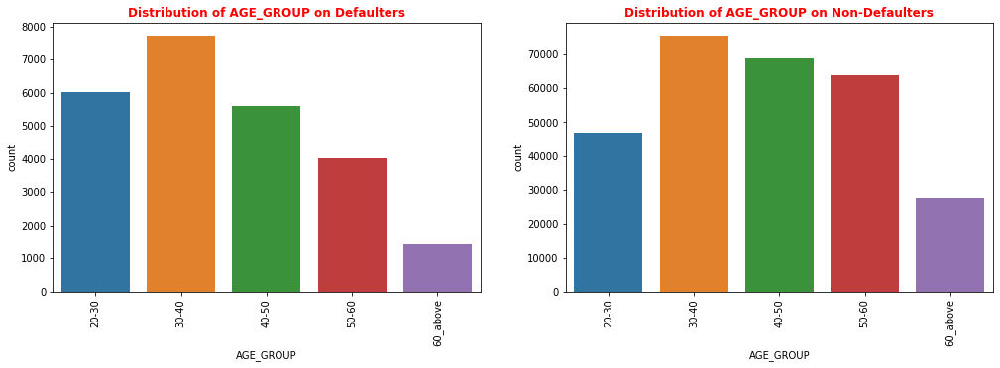

In [120]:
plt.figure(figsize=[17,5])

plt.subplot(1,2,1)
sns.countplot(data=target_1, x=target_1['AGE_GROUP'])
plt.title('Distribution of AGE_GROUP on Defaulters',
              fontdict={'size':12, 'color':'red', 'fontweight':'bold'})
plt.xticks(rotation=90)

plt.subplot(1,2,2)
sns.countplot(data=target_0, x=target_0['AGE_GROUP'])
plt.title('Distribution of AGE_GROUP on Non-Defaulters',
              fontdict={'size':12, 'color':'red', 'fontweight':'bold'})
plt.xticks(rotation=90)

plt.show()

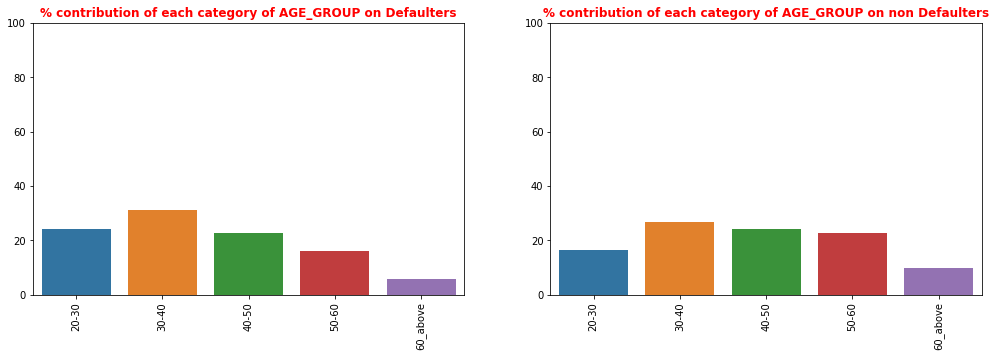

In [121]:
univariate_categorical_per('AGE_GROUP')

**`Inference`** :
We observe that there is an increase in the percentage of Loan Payment Difficulties who are young in age when compared to the percentages of Payment Difficulties and Loan-Non Payment Difficulties.

#### NAME_CONTRACT_TYPE

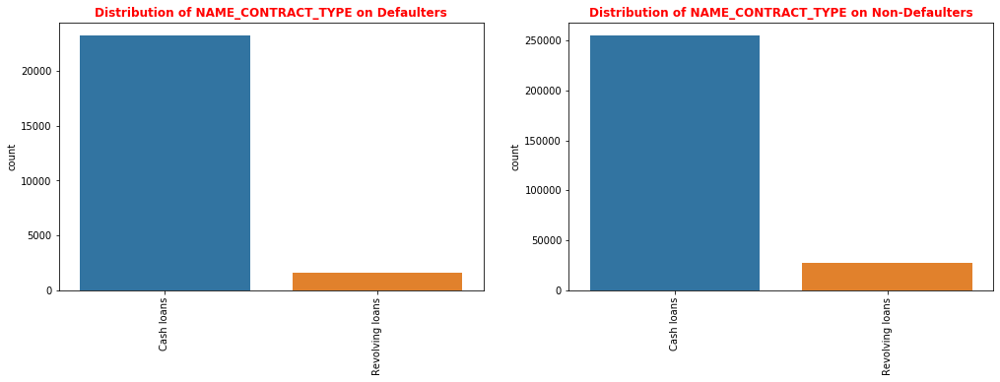

In [122]:
#Contract Type Analysis
univariate_categorical('NAME_CONTRACT_TYPE')

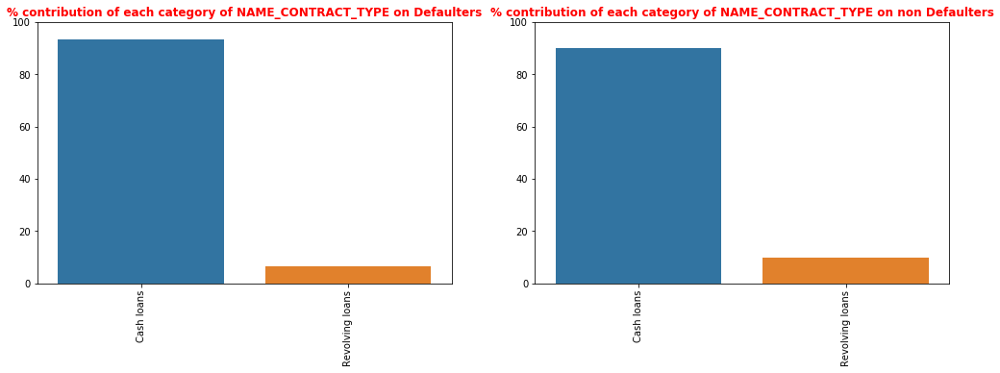

In [123]:
univariate_categorical_per('NAME_CONTRACT_TYPE')

**`Inference:`** Most of applications of Cash loans but Revolving loans are lesser in the defaulted population. Hence revolving loans are comparatively safer.

#### NAME_EDUCATION_TYPE

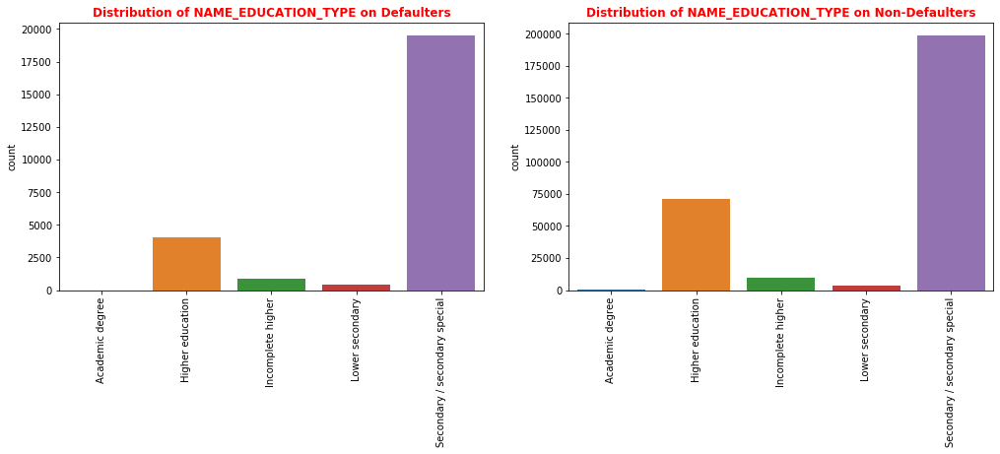

In [124]:
# Education Type analysis
univariate_categorical('NAME_EDUCATION_TYPE')

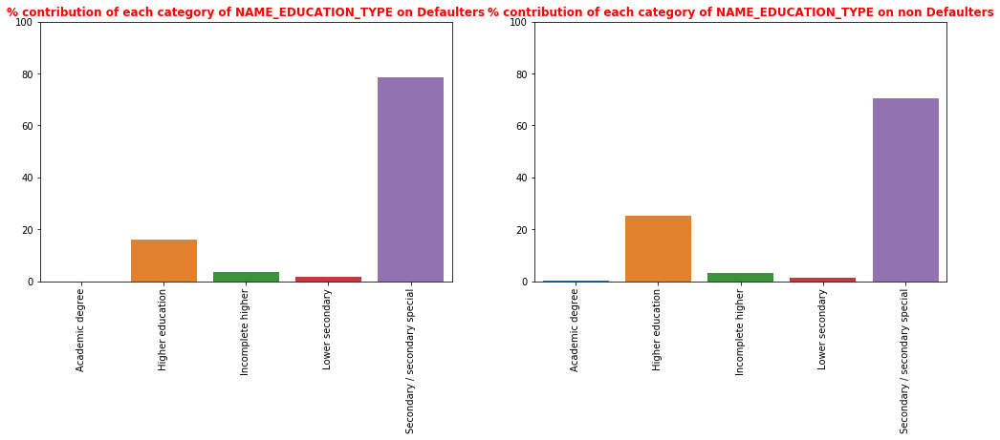

In [125]:
univariate_categorical_per('NAME_EDUCATION_TYPE')

**`Inference:`** We observe an increase in percentage of Loan Payment Difficulties whose educational qualifications are secondary/secondary special and a decrease in the percentage of Loan Payment Difficulties who have completed higher education when compared with the percentages of Loan Payment Difficulties and Loan Non-Payment Difficulties

#### ORGANIZATION_TYPE              

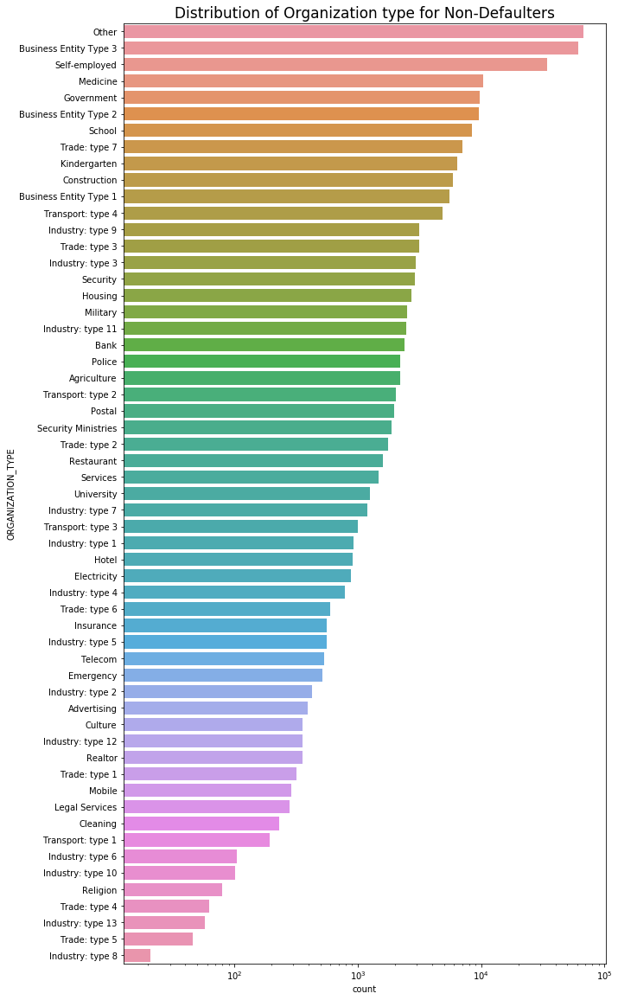

In [126]:
plt.figure(figsize=(10,20))
plt.title("Distribution of Organization type for Non-Defaulters", fontsize=17)
plt.xscale('log')
sns.countplot(data=target_0,y='ORGANIZATION_TYPE',
              order=target_0['ORGANIZATION_TYPE'].value_counts().index
             )
plt.show()

**`Inference`**: 
1. Highest number of loan applications are from most of the organization type ‘Other’ , ‘Business entity Type 3’ , ‘Self employed’ , ‘Medicine’ and ‘Government’.
2. Less applications are from Industry type 8,type 5, type 13, type 4 and religion.

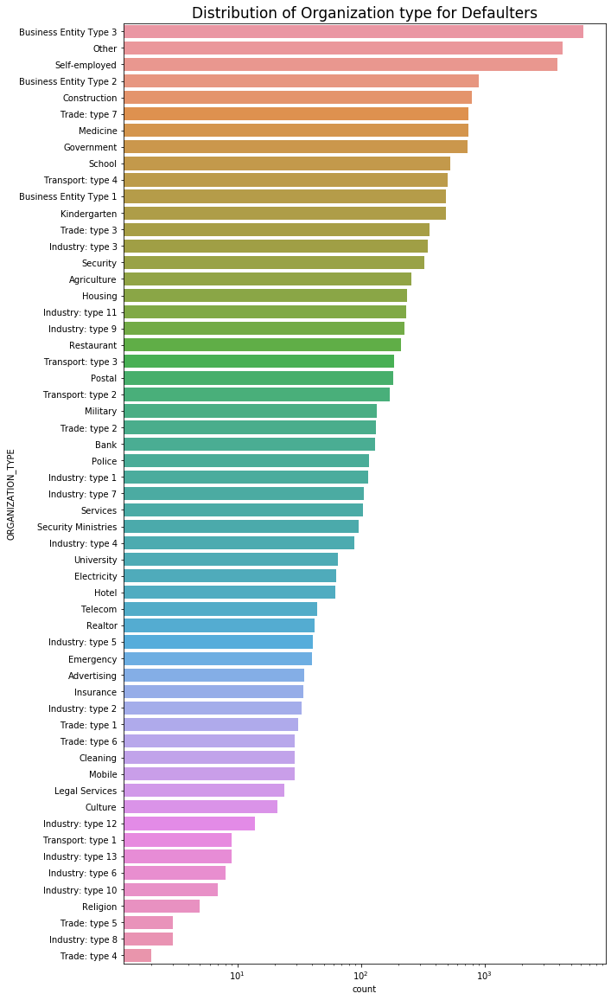

In [127]:

plt.figure(figsize=(10,20))

plt.title("Distribution of Organization type for Defaulters", fontsize=17)
plt.xscale('log')
sns.countplot(data=target_1, y='ORGANIZATION_TYPE', 
              order=target_1['ORGANIZATION_TYPE'].value_counts().index
             )

plt.show()

**`Inference`**:
1. Highest number of loan applications are from most of the organization type 'Business entity Type 3', 'Other' , 'Self employed' , 'Business entity Type 2' and 'Construction'.
2. Less applications are from Industry type 4,type 8, type 5, type 10 and religion.

### Statistics on the numerical variable


In [128]:
app_data.describe()

,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,...,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,SK_ID_CURR,TARGET,AGE,DAYS_ID_PUBLISH_ORIGINAL,DAYS_REGISTRATION_ORIGINAL
count,307511.000000,3.075110e+05,3.075110e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000
mean,27108.487841,5.990260e+05,5.383163e+05,0.006055,0.005538,0.231293,0.229631,0.029723,1.643447,0.417052,...,0.040659,0.078173,0.230454,0.015144,0.050769,278180.518577,0.080729,43.405137,2994.202373,4986.120328
std,14493.461065,4.024908e+05,3.692890e+05,0.103037,0.078014,0.856810,0.744059,0.190728,1.855821,0.722121,...,0.197499,0.268444,0.421124,0.122126,0.219526,102790.175348,0.272419,11.945779,1509.450419,3522.886321
min,1615.500000,4.500000e+04,4.050000e+04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,100002.000000,0.000000,20.000000,0.000000,0.000000
25%,16524.000000,2.700000e+05,2.385000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,189145.500000,0.000000,33.000000,1720.000000,2010.000000
50%,24903.000000,5.135310e+05,4.500000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,278202.000000,0.000000,43.000000,3254.000000,4504.000000
75%,34596.000000,8.086500e+05,6.795000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,367142.500000,0.000000,53.000000,4299.000000,7479.500000
max,258025.500000,4.050000e+06,4.050000e+06,9.000000,4.000000,27.000000,261.000000,8.000000,25.000000,19.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,456255.000000,1.000000,69.000000,7197.000000,24672.000000


### Numerical variable univariate analysis

In [129]:
# function of plot for numerical variables
def univariate_numerical(column):
    plt.figure(figsize=[20,17])

    plt.subplot(3,2,1)
    sns.distplot(target_1[column].dropna(),bins=3)
    plt.title('Distribution Plot for '+ '%s' %column +' on Defaulters',
              fontdict={'size':15, 'color':'blue', 'fontweight':'bold'})    
    plt.grid(True)

    plt.subplot(3,2,2)
    sns.boxplot(data = target_1, x=[column],orient='v')
    plt.title('Boxplot for '+ '%s' %column +' on Defaulters',
              fontdict={'size':15, 'color':'blue', 'fontweight':'bold'})
    plt.yscale('log')
    plt.grid(True)

    
    plt.subplot(3,2,3)
    sns.distplot(target_0[column].dropna(),bins=3)
    plt.title('Distribution Plot for '+ '%s' %column +' on Non-Defaulters',
              fontdict={'size':15, 'color':'red', 'fontweight':'bold'})    
    plt.grid(True)

    
    plt.subplot(3,2,4)
    sns.boxplot(data = target_0, x=[column],orient='v')
    plt.title('Boxplot for '+ '%s' %column +' on Non-Defaulters',
              fontdict={'size':15, 'color':'red', 'fontweight':'bold'})
    plt.yscale('log')
    plt.grid(True)
    
    
    plt.figure(figsize=[20,17])
    plt.subplot(3,2,5)
    sns.scatterplot(data=app_data, x=column, y=app_data.index, hue='TARGET')
    plt.title('Distribution of '+ '%s' %column +' for Defaulters  and Non-Defaulters', 
              fontdict={'size':15, 'color':'purple', 'fontweight':'bold'})
    
    
    plt.show()


#### Loan Annuity

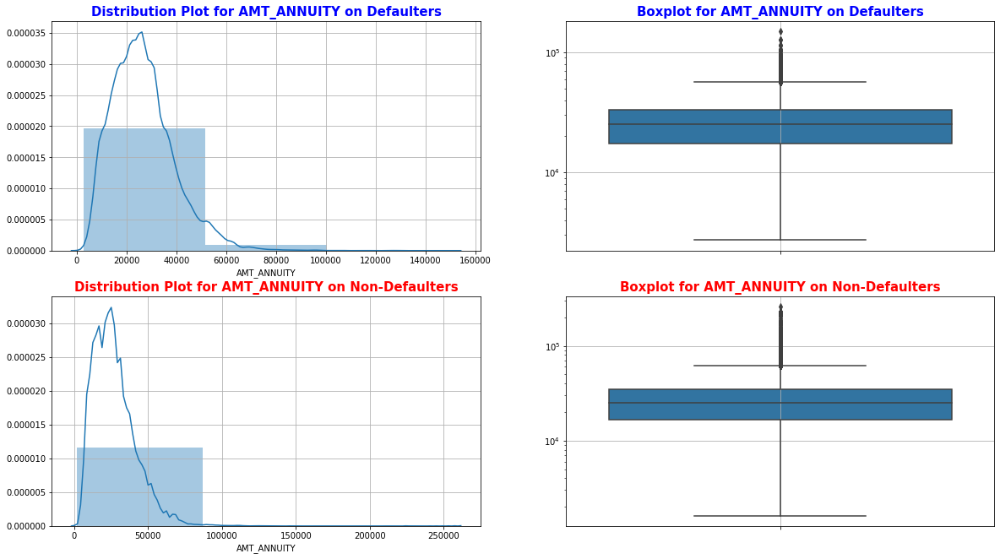

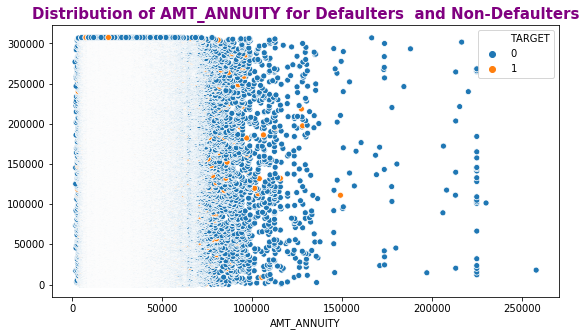

In [130]:
# Annuity Analysis
univariate_numerical('AMT_ANNUITY')

**`Inference`**:
We can observe some outliers and the first quartile is bigger than third quartile for annuity amount which means most of the annuity clients are from first quartile

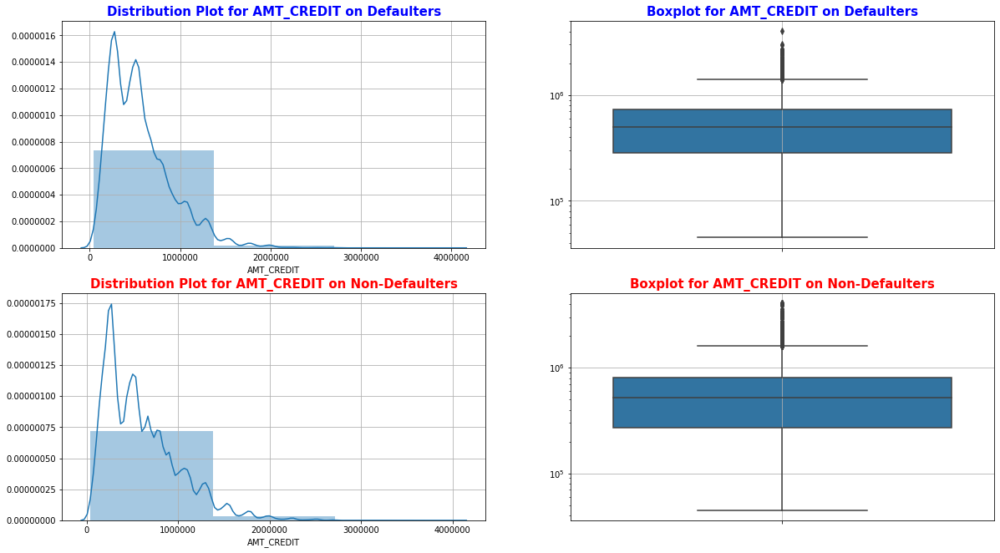

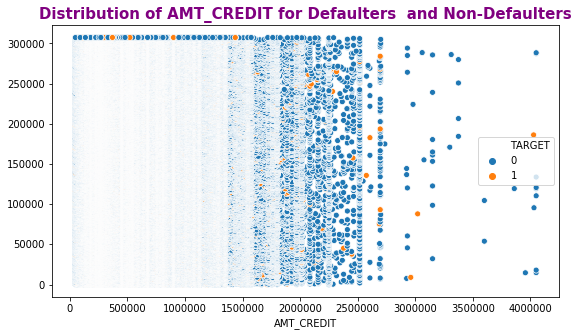

In [131]:
# Amount Credit Analysis
univariate_numerical('AMT_CREDIT')

**`Inference`** : In the above scatterplot, there's a visibility of outliers and most of values are in between (0.1 lakh to 2 lakh).

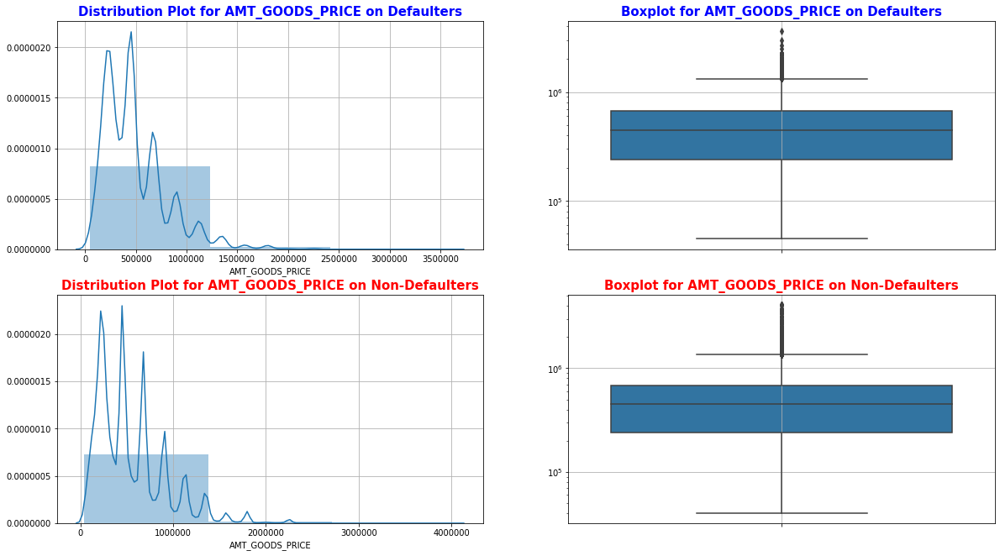

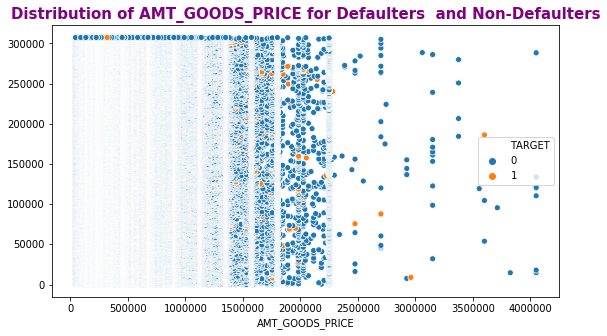

In [132]:
#Good Price analysis
univariate_numerical('AMT_GOODS_PRICE')

**`Inference`** : In the above scatterplot, there's a visibility of outliers and most of values are upto 1.5 lakh.

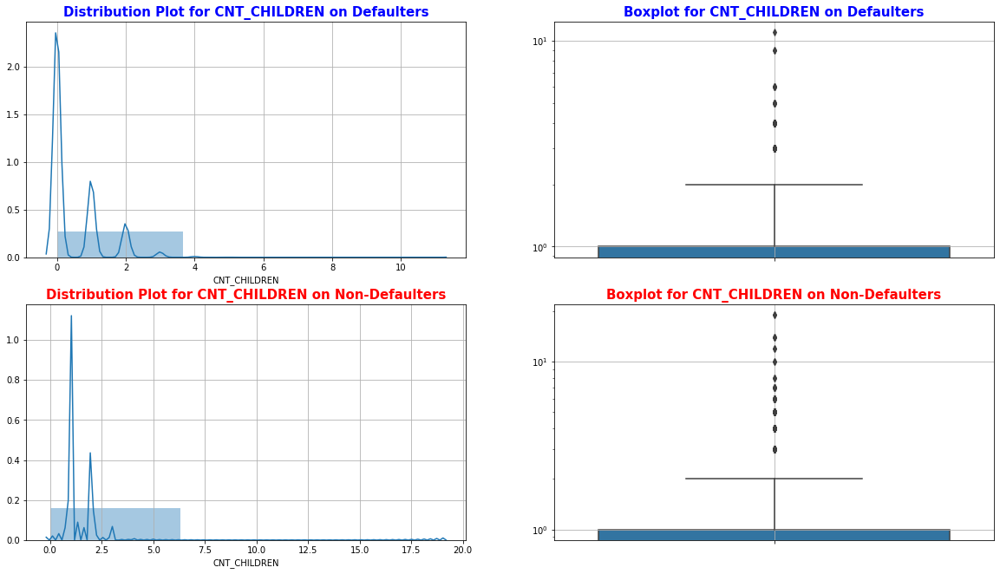

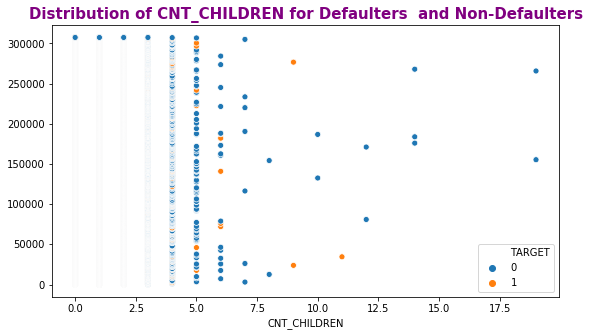

In [133]:
#Children count analysis
univariate_numerical('CNT_CHILDREN')

**`Inference`** : Most of people have 1 or 2 child. Also there are few outliers available.

## Bivariate and Multivariate Analysis


In [134]:
app_data.dtypes

AMT_ANNUITY                    float64 
AMT_CREDIT                     float64 
AMT_GOODS_PRICE                float64 
AMT_INCOME_TOTAL               category
AMT_REQ_CREDIT_BUREAU_DAY      float64 
AMT_REQ_CREDIT_BUREAU_HOUR     float64 
AMT_REQ_CREDIT_BUREAU_MON      float64 
AMT_REQ_CREDIT_BUREAU_QRT      float64 
AMT_REQ_CREDIT_BUREAU_WEEK     float64 
AMT_REQ_CREDIT_BUREAU_YEAR     float64 
CNT_CHILDREN                   int64   
CNT_FAM_MEMBERS                float64 
CODE_GENDER                    object  
YRS_EMPLOYED                   float64 
YRS_ID_PUBLISH                 float64 
YRS_REGISTRATION               float64 
FLAG_OWN_CAR                   object  
FLAG_OWN_REALTY                object  
HOUR_APPR_PROCESS_START        int64   
LIVE_CITY_NOT_WORK_CITY        int64   
LIVE_REGION_NOT_WORK_REGION    int64   
NAME_CONTRACT_TYPE             object  
NAME_EDUCATION_TYPE            object  
NAME_FAMILY_STATUS             object  
NAME_HOUSING_TYPE              object  


### Analysis Between Two Numeric Variables


In [135]:
def bivariate_numerical(column1, column2):
    plt.figure(figsize=[15,5])

    plt.subplot(1,2,1)
    sns.scatterplot(data=target_0, x=column1, y=column2)
    plt.title('%s' %column1 + ' vs '+ '%s' %column2 + ' for Non-Defaulter \n', 
              fontdict={'size':13, 'color':'red', 'fontweight':'bold'})
    plt.xticks(rotation=90)

    plt.subplot(1,2,2)
    sns.scatterplot(data=target_1, x=column1, y=column2)
    plt.title('%s' %column1 + ' vs '+ '%s' %column2 + ' for Defaulter \n', 
              fontdict={'size':13, 'color':'red', 'fontweight':'bold'})
    plt.xticks(rotation=90)

    plt.show()

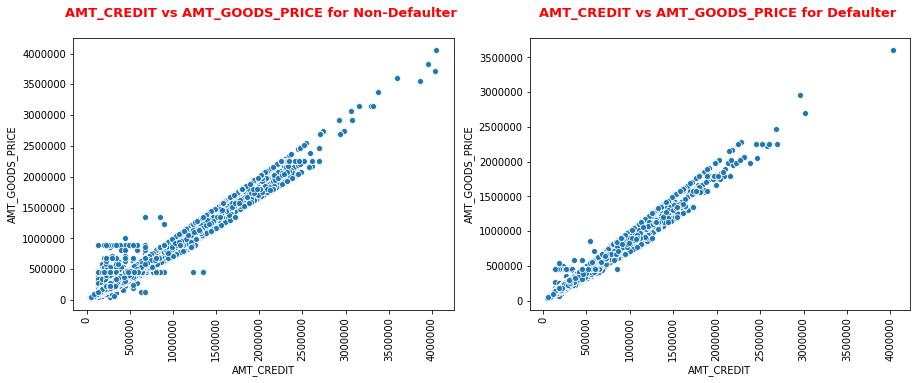

In [136]:
# Analysis between Credit and Good Price
bivariate_numerical('AMT_CREDIT', 'AMT_GOODS_PRICE')

**`Inference`** :
- The defaulter seems to be in less number whenever the price of goods is upto 50k and credit amount is even lesser than 50k.

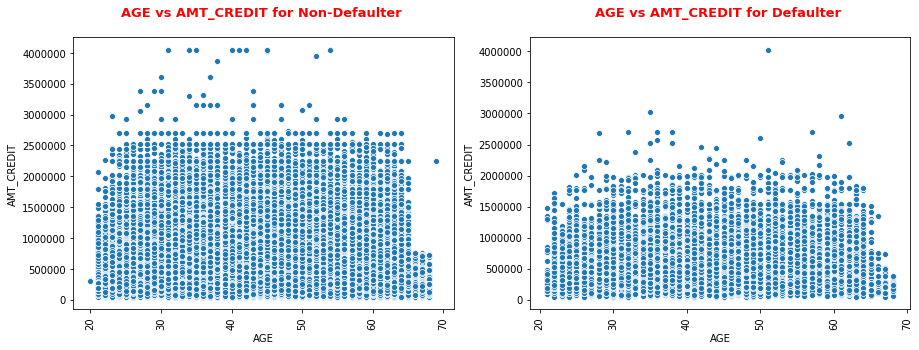

In [137]:
#Analysis between Age and Credit
bivariate_numerical('AGE', 'AMT_CREDIT')

**`Inference`** :
- In Non-Defaulter and Defaulter, the credit amount seems to be less i.e., 50k-100 in the age group of 60-70 while comparing to other age group.
- In defaulters, credit amount seems to be less around 300k in comparison to non- defaulter.

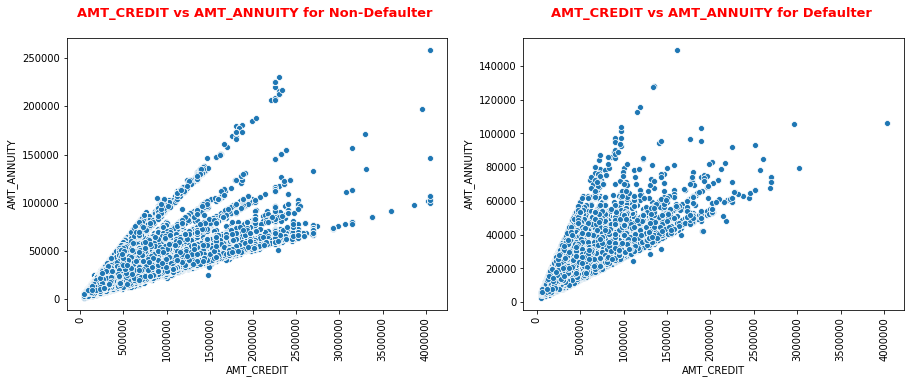

In [138]:
#Analysis between Credit and Annuity
bivariate_numerical('AMT_CREDIT', 'AMT_ANNUITY')

**`Inference`** :
- In the above scatter plot, credit amount increases with the increase in annuity amount. Slope seems to be bit higher in Defaulters.

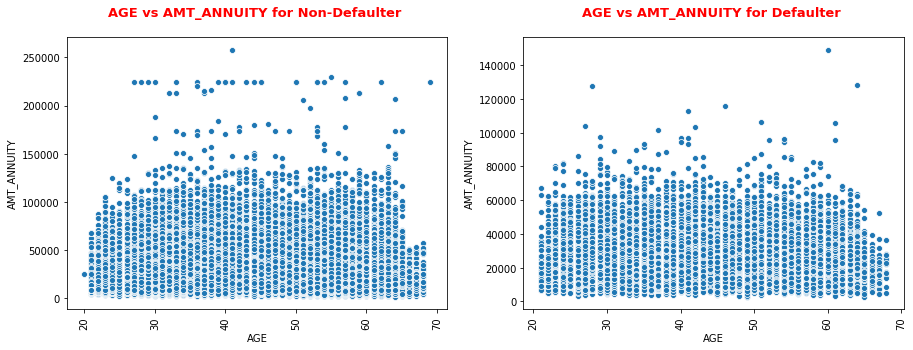

In [139]:
#Analysis between Age and Annuity
bivariate_numerical('AGE', 'AMT_ANNUITY')

**`Inference`** :
- People of age group 60-70 have less annuity amount in both cases.
- Annuity amount seems to be higher in Non-Defaulters.

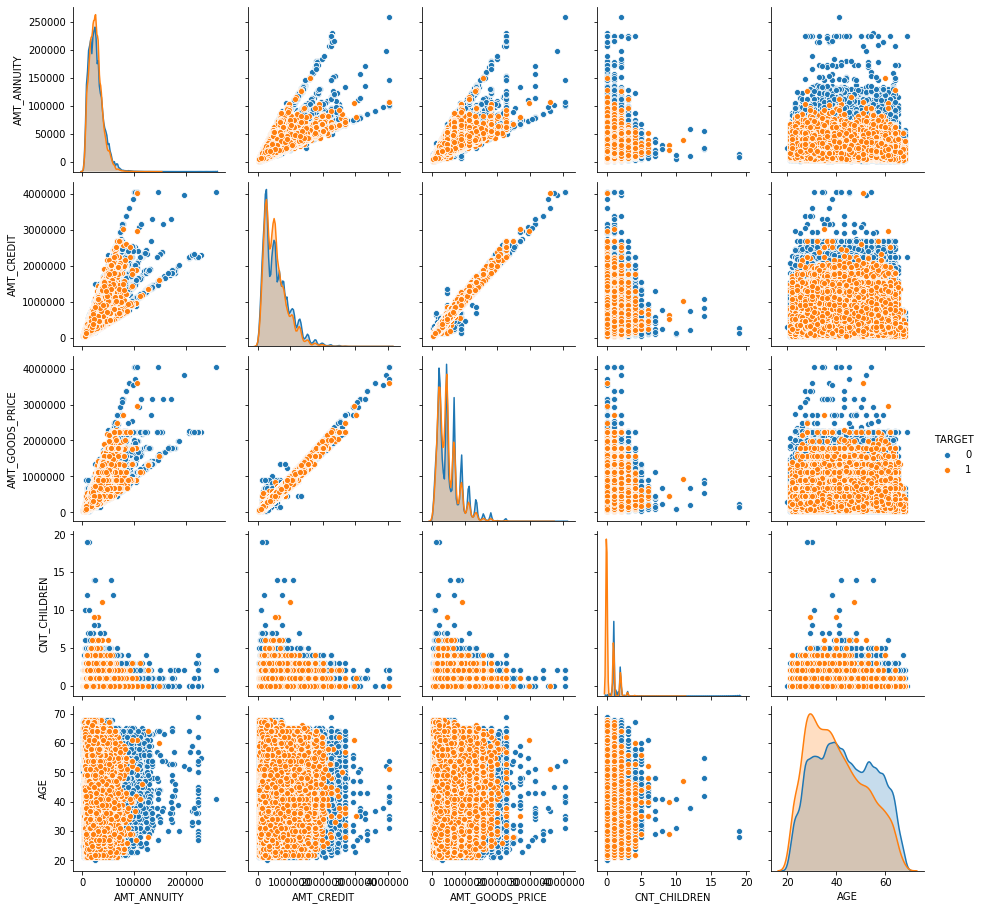

In [140]:
#Pairplot with hue as Target
sns.pairplot(data = app_data ,vars =[ "AMT_ANNUITY","AMT_CREDIT","AMT_GOODS_PRICE","CNT_CHILDREN","AGE"],hue='TARGET')
plt.show()

### Analysis Between Numeric and Categorical Variables


In [141]:
def bivariate_num_cat(column1, column2):
    plt.figure(figsize=[30,15])

    plt.subplot(1,3,1)

    sns.boxplot(data=target_0, x=column1, y=column2)
    plt.title('%s' %column1 + ' vs '+ '%s' %column2 + ' for Non-Defaulter \n', 
              fontdict={'size':20, 'color':'hotpink', 'fontweight':'bold'})

    plt.subplot(1,3,3)
    sns.boxplot(data=target_1, x=column1, y=column2)
    plt.title('%s' %column1 + ' vs '+ '%s' %column2 + ' for Defaulter \n', 
              fontdict={'size':20, 'color':'hotpink', 'fontweight':'bold'})

    plt.show()

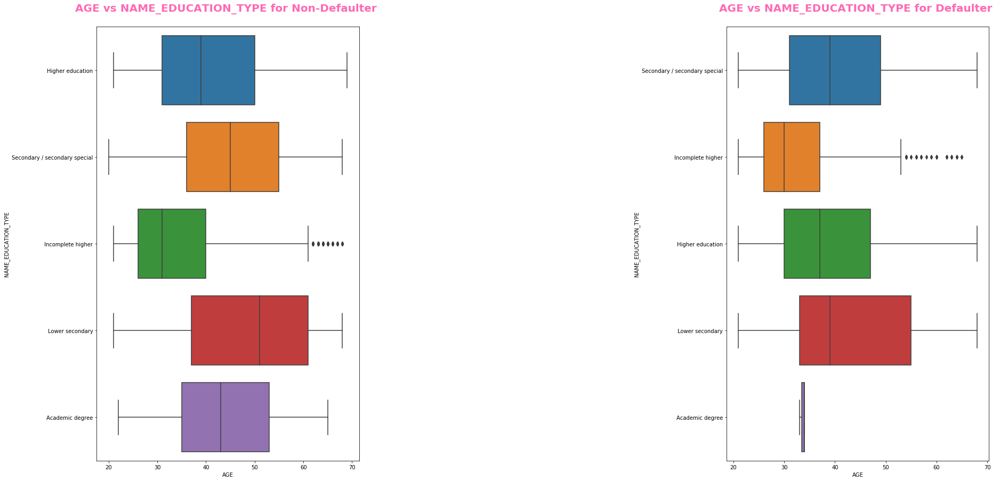

In [142]:
#Analysis between Age and Education Type
bivariate_num_cat('AGE','NAME_EDUCATION_TYPE')

**`Inference`** :

For Target = 0,
- There is an outliers in Incomplete higher in between age 60-70.
- Apart from Incomplete higher where first quartile lies on age 40,other education types aren't facing much difficulties in loan repayment.

For Taget = 1.
- There is a visibility of an outliers in Incomplete higher from the age group between 50-70.
- People with an age group 30-40 and education type as Academic degree and Incomplete higher seems to be facing difficulties in loan repaymet.

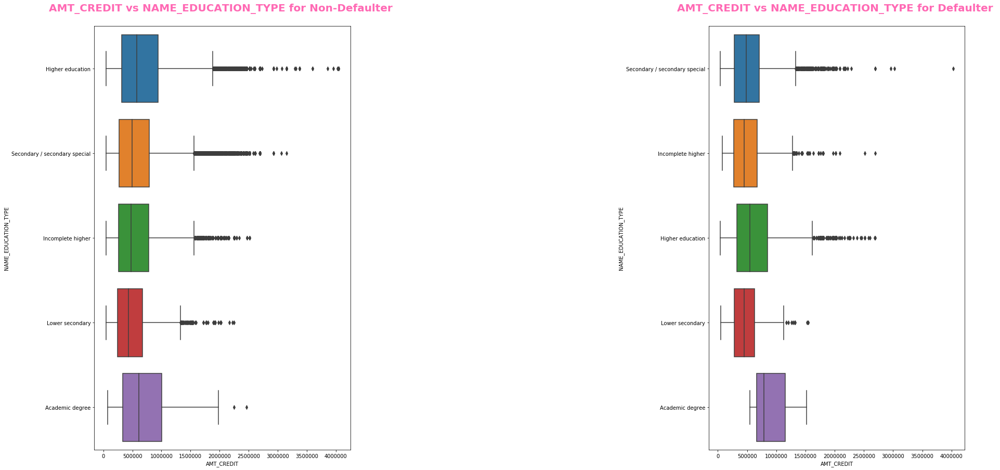

In [143]:
#Analysis between Credit and Education Type
bivariate_num_cat('AMT_CREDIT','NAME_EDUCATION_TYPE')

**`Inference for Non-Defaulter`**:
1. Academic degree education are having higher credit amount than others.
2. Higher education  are having more outliers.
3. Academic degree is having most of the credits .

**`Inference for Defaulter`**:
1. Academic degree education have higher credit amount than others.
2. Higher education seems to have more outliers.
3. Academic degree has most credit amount .
4. Academic education category has less number of defaulters.

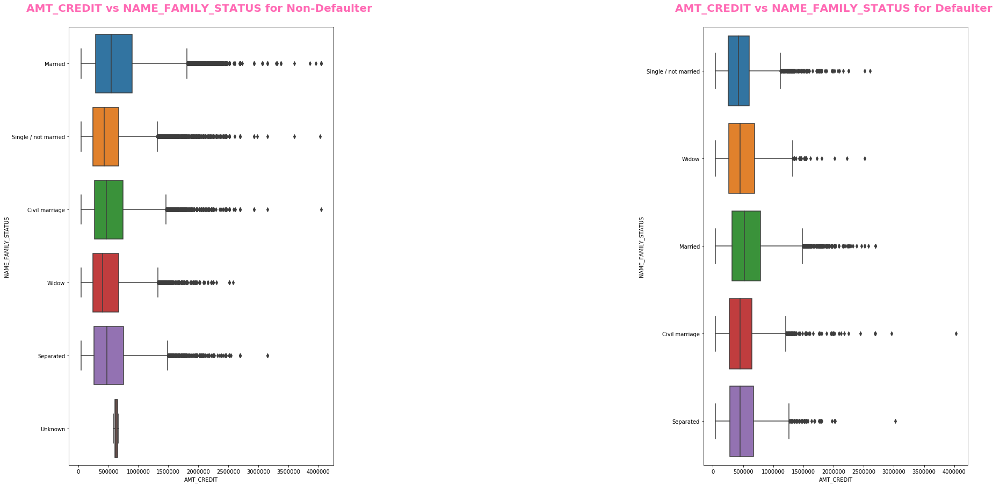

In [144]:
#Analysis between Credit and Family Status
bivariate_num_cat('AMT_CREDIT','NAME_FAMILY_STATUS')

**`Inference for Non-Defaulter`**:
1. Married are having higher credit amount than others.
2. widow are having less outliers.

**`Inference for Defaulter`**:
1. Married are having higher credit amount than others.
2. Civil Marriage seems to have more outliers.
3. Civil marriage has most credit amount .
4. Defaulters are almost equal to every category.

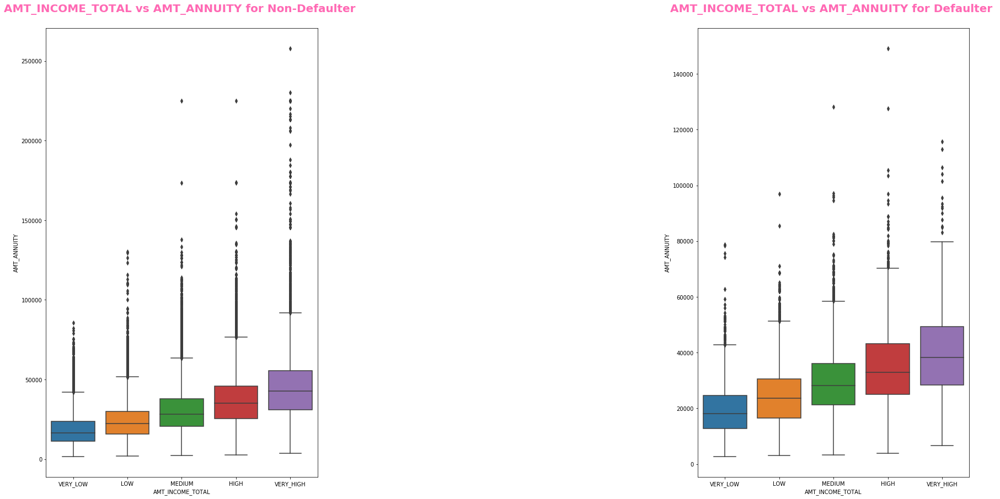

In [145]:
#Analysis between Income and Annuity
bivariate_num_cat('AMT_INCOME_TOTAL','AMT_ANNUITY')

**`Inference for Non-Defaulter`**:
1. Very High from the amount income total is having more annnuity compare to all reamaining catrgories.
2. The same category 'very high ' is having outiler which is greater than the others .


**`Inference for Defaulter`**:
1. Very High from the amount income total is having more annnuity compare to all reamaining catrgories.
2. The same category ' high ' is having outiler which is greater than the others .

## Correlation


In [146]:
app_data.columns

Index(['AMT_ANNUITY', 'AMT_CREDIT', 'AMT_GOODS_PRICE', 'AMT_INCOME_TOTAL',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_YEAR',
       'CNT_CHILDREN', 'CNT_FAM_MEMBERS', 'CODE_GENDER', 'YRS_EMPLOYED',
       'YRS_ID_PUBLISH', 'YRS_REGISTRATION', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'HOUR_APPR_PROCESS_START', 'LIVE_CITY_NOT_WORK_CITY',
       'LIVE_REGION_NOT_WORK_REGION', 'NAME_CONTRACT_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'NAME_INCOME_TYPE', 'NAME_TYPE_SUITE', 'ORGANIZATION_TYPE',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'SK_ID_CURR', 'TARGET', 'WEEKDAY_APPR_PROCESS_START', 'AGE',
       'AGE_GROUP', 'DAYS_ID_PUBLISH_ORIGINAL', 'DAYS_REGISTRATION_ORIGINAL'],
      dtype='object')

### Heatmap for Correlation of target 0


In [304]:
# Finding correlation for  target 0

corr_app_data_0 = target_0[['AMT_ANNUITY', 'AMT_CREDIT', 'AMT_GOODS_PRICE', 'AMT_INCOME_TOTAL',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_YEAR',
       'CNT_CHILDREN', 'CNT_FAM_MEMBERS', 'CODE_GENDER', 'YRS_EMPLOYED',
       'YRS_ID_PUBLISH', 'YRS_REGISTRATION', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'HOUR_APPR_PROCESS_START', 'LIVE_CITY_NOT_WORK_CITY',
       'LIVE_REGION_NOT_WORK_REGION', 'NAME_CONTRACT_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'NAME_INCOME_TYPE', 'NAME_TYPE_SUITE', 'ORGANIZATION_TYPE',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'SK_ID_CURR', 'WEEKDAY_APPR_PROCESS_START', 'AGE',
       'AGE_GROUP', 'DAYS_ID_PUBLISH_ORIGINAL', 'DAYS_REGISTRATION_ORIGINAL']].corr()
corr_app_data_0

,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,...,LIVE_CITY_NOT_WORK_CITY,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,SK_ID_CURR,AGE,DAYS_ID_PUBLISH_ORIGINAL,DAYS_REGISTRATION_ORIGINAL
AMT_ANNUITY,1.000000,0.771297,0.776421,0.002465,0.003220,0.036291,0.011660,0.012377,-0.005588,0.020909,...,0.010577,0.075464,-0.005679,0.001516,0.041983,0.080646,0.000071,-0.012247,-0.014111,-0.039435
AMT_CREDIT,0.771297,1.000000,0.987022,0.005135,-0.002267,0.055063,0.021825,0.000941,-0.027599,0.003081,...,0.002506,0.054250,-0.025036,-0.015703,0.024617,0.053735,-0.000342,0.047419,0.001464,-0.013477
AMT_GOODS_PRICE,0.776421,0.987022,1.000000,0.005520,-0.001698,0.056675,0.022134,0.001192,-0.029840,-0.000559,...,0.001285,0.054371,-0.024879,-0.016761,0.026738,0.054889,-0.000235,0.044684,0.003677,-0.015891
AMT_REQ_CREDIT_BUREAU_DAY,0.002465,0.005135,0.005520,1.000000,0.229543,-0.002351,-0.002028,0.220995,0.004233,0.001057,...,-0.002102,-0.001164,-0.002296,-0.002317,-0.001227,-0.001936,-0.001626,-0.001599,0.002199,0.000009
AMT_REQ_CREDIT_BUREAU_HOUR,0.003220,-0.002267,-0.001698,0.229543,1.000000,0.003431,-0.000037,0.006243,0.005047,0.000147,...,-0.000522,-0.001474,0.000019,0.000334,-0.001643,-0.002031,-0.001774,-0.002924,-0.001943,0.002514
AMT_REQ_CREDIT_BUREAU_MON,0.036291,0.055063,0.056675,-0.002351,0.003431,1.000000,0.004457,-0.007758,0.031754,-0.007640,...,-0.007898,0.008236,-0.013201,-0.013565,-0.002943,0.005962,-0.000037,0.001953,0.017382,0.010877
AMT_REQ_CREDIT_BUREAU_QRT,0.011660,0.021825,0.022134,-0.002028,-0.000037,0.004457,1.000000,-0.008105,0.110657,-0.004218,...,-0.006963,-0.005920,-0.003105,-0.007575,-0.003989,-0.006157,0.000963,0.015407,0.017089,0.000363
AMT_REQ_CREDIT_BUREAU_WEEK,0.012377,0.000941,0.001192,0.220995,0.006243,-0.007758,-0.008105,1.000000,0.038840,-0.000315,...,-0.003512,-0.001510,-0.002585,-0.003529,0.000784,-0.000916,0.002298,0.003637,0.006943,0.001268
AMT_REQ_CREDIT_BUREAU_YEAR,-0.005588,-0.027599,-0.029840,0.004233,0.005047,0.031754,0.110657,0.038840,1.000000,-0.030513,...,-0.012702,-0.017671,-0.014293,-0.016439,-0.019922,-0.023320,0.003517,0.077625,0.061619,0.022933
CNT_CHILDREN,0.020909,0.003081,-0.000559,0.001057,0.000147,-0.007640,-0.004218,-0.000315,-0.030513,1.000000,...,0.070988,0.017326,0.021587,0.072193,-0.012342,0.010857,-0.000716,-0.336896,0.028751,-0.185792


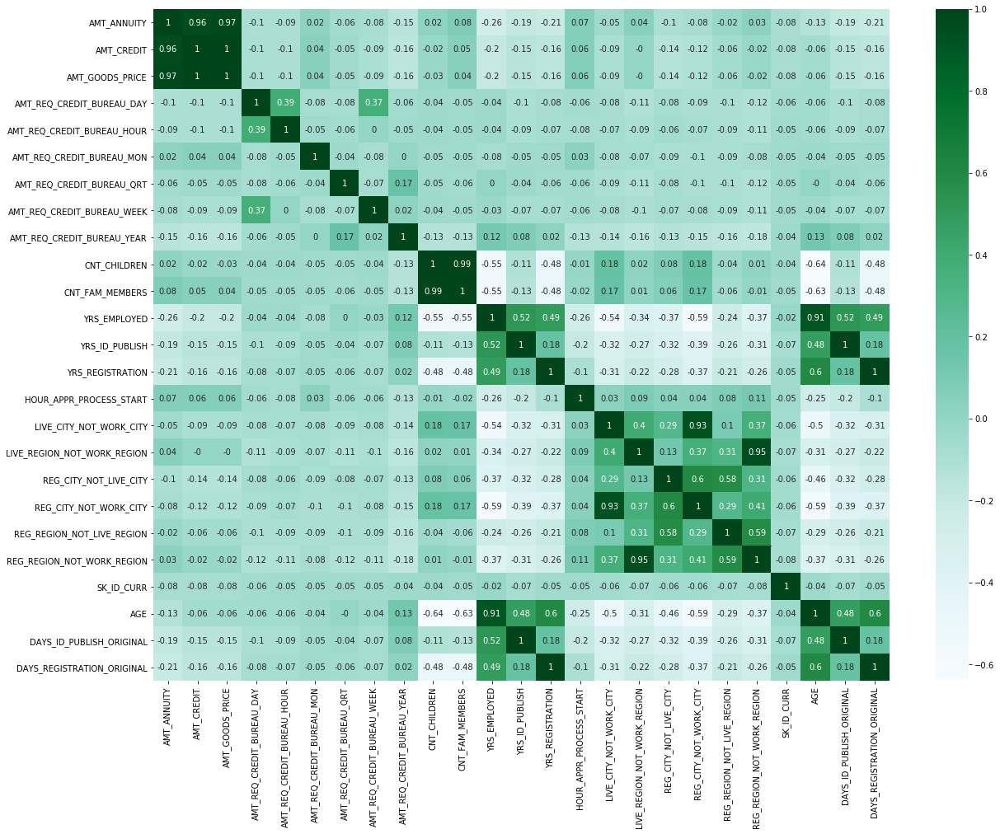

In [305]:
# heatmap for Correlation of target 0

plt.figure(figsize=[20,15])
sns.heatmap(round(corr_app_data_0.corr(),2),annot=True,cmap="BuGn");
plt.show()

In [306]:
corr_list = corr_app_data_0.corr().abs().unstack()
corr_list = corr_list.dropna()
corr_list = corr_list[corr_list != 1]
corr_list = corr_list.sort_values(ascending=False)
corr_list.head(10)

AMT_GOODS_PRICE              AMT_CREDIT                     0.999888
AMT_CREDIT                   AMT_GOODS_PRICE                0.999888
CNT_CHILDREN                 CNT_FAM_MEMBERS                0.989512
CNT_FAM_MEMBERS              CNT_CHILDREN                   0.989512
AMT_ANNUITY                  AMT_GOODS_PRICE                0.965741
AMT_GOODS_PRICE              AMT_ANNUITY                    0.965741
AMT_ANNUITY                  AMT_CREDIT                     0.964954
AMT_CREDIT                   AMT_ANNUITY                    0.964954
LIVE_REGION_NOT_WORK_REGION  REG_REGION_NOT_WORK_REGION     0.948528
REG_REGION_NOT_WORK_REGION   LIVE_REGION_NOT_WORK_REGION    0.948528
dtype: float64

In [307]:
for i in range(0,20,2):
    print(corr_list.index[i])

('AMT_GOODS_PRICE', 'AMT_CREDIT')
('CNT_CHILDREN', 'CNT_FAM_MEMBERS')
('AMT_ANNUITY', 'AMT_GOODS_PRICE')
('AMT_ANNUITY', 'AMT_CREDIT')
('LIVE_REGION_NOT_WORK_REGION', 'REG_REGION_NOT_WORK_REGION')
('REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY')
('AGE', 'YRS_EMPLOYED')
('AGE', 'CNT_CHILDREN')
('CNT_FAM_MEMBERS', 'AGE')
('AGE', 'DAYS_REGISTRATION_ORIGINAL')


#### **`Top 10 Correlation for Non-Defaulter`**:
- ('AMT_GOODS_PRICE', 'AMT_CREDIT')
- ('CNT_CHILDREN', 'CNT_FAM_MEMBERS')
- ('AMT_ANNUITY', 'AMT_GOODS_PRICE') 
- ('AMT_ANNUITY', 'AMT_CREDIT')
- ('LIVE_REGION_NOT_WORK_REGION', 'REG_REGION_NOT_WORK_REGION')
- ('REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY')
- ('AGE', 'YRS_EMPLOYED')
- ('AGE', 'CNT_CHILDREN')
- ('CNT_FAM_MEMBERS', 'AGE')
- ('AGE', 'DAYS_REGISTRATION_ORIGINAL')

### Heatmap for Correlation of target 1


In [308]:
# Finding correlation for  target 1

corr_app_data_1 = target_1[['AMT_ANNUITY', 'AMT_CREDIT', 'AMT_GOODS_PRICE', 'AMT_INCOME_TOTAL',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_YEAR',
       'CNT_CHILDREN', 'CNT_FAM_MEMBERS', 'CODE_GENDER', 'YRS_EMPLOYED',
       'YRS_ID_PUBLISH', 'YRS_REGISTRATION', 'FLAG_OWN_CAR',
       'FLAG_OWN_REALTY', 'HOUR_APPR_PROCESS_START', 'LIVE_CITY_NOT_WORK_CITY',
       'LIVE_REGION_NOT_WORK_REGION', 'NAME_CONTRACT_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'NAME_INCOME_TYPE', 'NAME_TYPE_SUITE', 'ORGANIZATION_TYPE', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'REG_REGION_NOT_LIVE_REGION',
       'REG_REGION_NOT_WORK_REGION', 'SK_ID_CURR',
       'WEEKDAY_APPR_PROCESS_START', 'AGE', 'AGE_GROUP',
       'DAYS_ID_PUBLISH_ORIGINAL', 'DAYS_REGISTRATION_ORIGINAL']].corr()
corr_app_data_1

,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,CNT_CHILDREN,...,LIVE_CITY_NOT_WORK_CITY,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,SK_ID_CURR,AGE,DAYS_ID_PUBLISH_ORIGINAL,DAYS_REGISTRATION_ORIGINAL
AMT_ANNUITY,1.000000,0.752195,0.752295,0.000074,0.012968,0.049000,-0.007261,0.028784,-0.007090,0.031257,...,0.009902,0.064109,-0.005745,0.001997,0.034807,0.066565,-0.007578,0.014063,0.016767,-0.034279
AMT_CREDIT,0.752195,1.000000,0.982783,0.004346,-0.003771,0.056227,-0.007201,0.010598,-0.009317,-0.001675,...,-0.016509,0.033554,-0.033034,-0.037720,0.019540,0.033260,-0.001290,0.135166,0.052329,0.025854
AMT_GOODS_PRICE,0.752295,0.982783,1.000000,0.005457,-0.002451,0.059112,-0.006114,0.010793,-0.011593,-0.008111,...,-0.016703,0.035505,-0.034085,-0.038915,0.022406,0.036285,-0.001814,0.135630,0.056061,0.025661
AMT_REQ_CREDIT_BUREAU_DAY,0.000074,0.004346,0.005457,1.000000,0.247511,-0.008569,0.005961,0.185767,0.013652,-0.011255,...,-0.003573,-0.000039,-0.007109,-0.005402,-0.005953,-0.002213,-0.007388,0.007894,0.014249,0.007868
AMT_REQ_CREDIT_BUREAU_HOUR,0.012968,-0.003771,-0.002451,0.247511,1.000000,-0.003684,0.011895,0.008531,0.010624,0.000316,...,-0.009248,0.003028,-0.003581,-0.007374,-0.009515,-0.001497,-0.011106,-0.011478,-0.000481,0.004798
AMT_REQ_CREDIT_BUREAU_MON,0.049000,0.056227,0.059112,-0.008569,-0.003684,1.000000,0.019555,-0.002908,0.048119,-0.008852,...,-0.011560,0.016341,-0.004026,-0.012534,0.019086,0.011379,0.005180,0.010948,0.024159,-0.003401
AMT_REQ_CREDIT_BUREAU_QRT,-0.007261,-0.007201,-0.006114,0.005961,0.011895,0.019555,1.000000,0.001772,0.158174,-0.013029,...,-0.020756,-0.007069,0.004234,-0.012948,0.000991,-0.006024,-0.001614,0.022962,0.007979,0.012512
AMT_REQ_CREDIT_BUREAU_WEEK,0.028784,0.010598,0.010793,0.185767,0.008531,-0.002908,0.001772,1.000000,0.043787,-0.009316,...,-0.008834,-0.004830,-0.008640,-0.011406,-0.007457,-0.007627,-0.003075,0.008357,0.003732,-0.002278
AMT_REQ_CREDIT_BUREAU_YEAR,-0.007090,-0.009317,-0.011593,0.013652,0.010624,0.048119,0.158174,0.043787,1.000000,-0.021572,...,-0.013604,-0.014874,-0.018825,-0.023195,-0.024948,-0.023765,0.005442,0.087842,0.070891,0.014311
CNT_CHILDREN,0.031257,-0.001675,-0.008111,-0.011255,0.000316,-0.008852,-0.013029,-0.009316,-0.021572,1.000000,...,0.053515,-0.012073,-0.001174,0.046115,-0.024322,-0.020793,-0.005144,-0.259124,0.032299,-0.149154


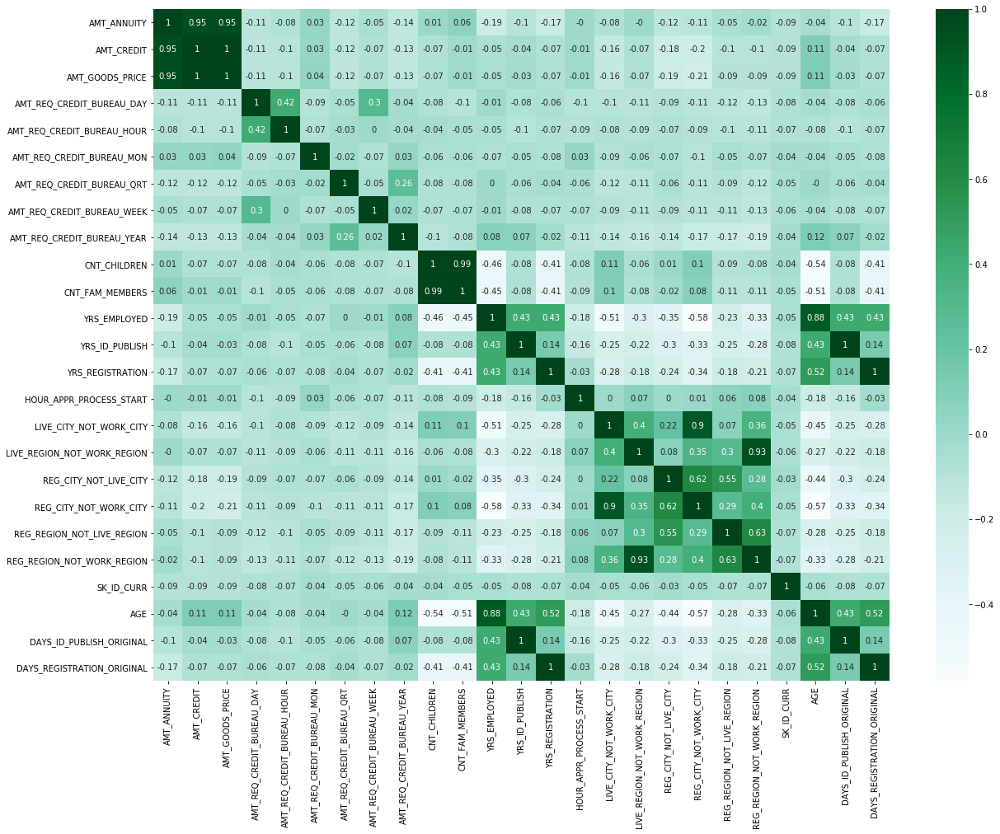

In [309]:
# heatmap for Correlation of target 1

plt.figure(figsize=[20,15])
sns.heatmap(round(corr_app_data_1.corr(),2),annot=True,cmap="BuGn");
plt.show()

In [310]:
corr_list = corr_app_data_1.corr().abs().unstack()
corr_list = corr_list.dropna()
corr_list = corr_list[corr_list != 1]
corr_list = corr_list.sort_values(ascending=False)
corr_list.head(10)

AMT_CREDIT                   AMT_GOODS_PRICE                0.999798
AMT_GOODS_PRICE              AMT_CREDIT                     0.999798
CNT_CHILDREN                 CNT_FAM_MEMBERS                0.990479
CNT_FAM_MEMBERS              CNT_CHILDREN                   0.990479
AMT_ANNUITY                  AMT_CREDIT                     0.950938
AMT_CREDIT                   AMT_ANNUITY                    0.950938
AMT_GOODS_PRICE              AMT_ANNUITY                    0.950521
AMT_ANNUITY                  AMT_GOODS_PRICE                0.950521
LIVE_REGION_NOT_WORK_REGION  REG_REGION_NOT_WORK_REGION     0.928645
REG_REGION_NOT_WORK_REGION   LIVE_REGION_NOT_WORK_REGION    0.928645
dtype: float64

In [311]:
for i in range(0,20,2):
    print(corr_list.index[i])

('AMT_CREDIT', 'AMT_GOODS_PRICE')
('CNT_CHILDREN', 'CNT_FAM_MEMBERS')
('AMT_ANNUITY', 'AMT_CREDIT')
('AMT_GOODS_PRICE', 'AMT_ANNUITY')
('LIVE_REGION_NOT_WORK_REGION', 'REG_REGION_NOT_WORK_REGION')
('LIVE_CITY_NOT_WORK_CITY', 'REG_CITY_NOT_WORK_CITY')
('YRS_EMPLOYED', 'AGE')
('REG_REGION_NOT_WORK_REGION', 'REG_REGION_NOT_LIVE_REGION')
('REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY')
('YRS_EMPLOYED', 'REG_CITY_NOT_WORK_CITY')


#### **`Top 10 Correlation for Defaulter`**:
- ('AMT_CREDIT', 'AMT_GOODS_PRICE')
- ('CNT_CHILDREN', 'CNT_FAM_MEMBERS')
- ('AMT_ANNUITY', 'AMT_CREDIT')
- AMT_GOODS_PRICE', 'AMT_ANNUITY')
- ('LIVE_REGION_NOT_WORK_REGION', 'REG_REGION_NOT_WORK_REGION')
- ('LIVE_CITY_NOT_WORK_CITY', 'REG_CITY_NOT_WORK_CITY')
- ('YRS_EMPLOYED', 'AGE')
- ('REG_REGION_NOT_WORK_REGION', 'REG_REGION_NOT_LIVE_REGION')
- ('REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY')
- ('YRS_EMPLOYED', 'REG_CITY_NOT_WORK_CITY')

### Multivariate Analysis


In [159]:
app_data.dtypes

AMT_ANNUITY                    float64 
AMT_CREDIT                     float64 
AMT_GOODS_PRICE                float64 
AMT_INCOME_TOTAL               category
AMT_REQ_CREDIT_BUREAU_DAY      float64 
AMT_REQ_CREDIT_BUREAU_HOUR     float64 
AMT_REQ_CREDIT_BUREAU_MON      float64 
AMT_REQ_CREDIT_BUREAU_QRT      float64 
AMT_REQ_CREDIT_BUREAU_WEEK     float64 
AMT_REQ_CREDIT_BUREAU_YEAR     float64 
CNT_CHILDREN                   int64   
CNT_FAM_MEMBERS                float64 
CODE_GENDER                    object  
YRS_EMPLOYED                   float64 
YRS_ID_PUBLISH                 float64 
YRS_REGISTRATION               float64 
FLAG_OWN_CAR                   object  
FLAG_OWN_REALTY                object  
HOUR_APPR_PROCESS_START        int64   
LIVE_CITY_NOT_WORK_CITY        int64   
LIVE_REGION_NOT_WORK_REGION    int64   
NAME_CONTRACT_TYPE             object  
NAME_EDUCATION_TYPE            object  
NAME_FAMILY_STATUS             object  
NAME_HOUSING_TYPE              object  


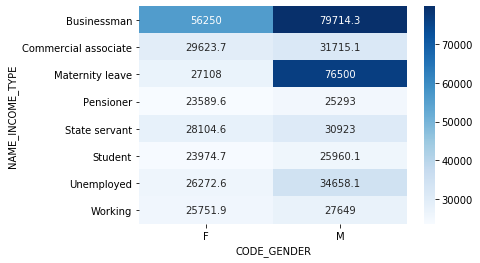

In [160]:
#Analysis between Income, Gender and Annuity
res = pd.pivot_table(data = app_data, index = "NAME_INCOME_TYPE", columns = "CODE_GENDER", values = "AMT_ANNUITY")
sns.heatmap(res , annot = True ,cmap = "Blues",fmt='g')
plt.show()

**`Inference`** 
Both Male and Female who are into Business have high annuity and comparetively Male have high annuity.
Both Male and Female who are students have very less annuity and comparetively Female has less annuity.

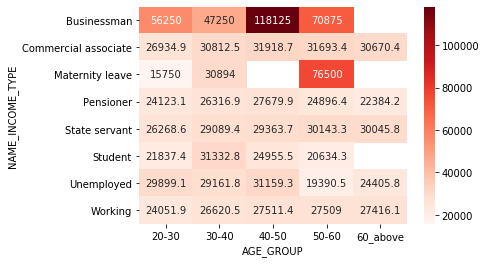

In [161]:
#Analysis between Income, Age and Annuity
res = pd.pivot_table(data = app_data, index = "NAME_INCOME_TYPE", columns = "AGE_GROUP", values = "AMT_ANNUITY")

sns.heatmap(res , annot = True ,cmap = "Reds",fmt='g',annot_kws={'size': 10})
plt.show()

**`Inference`** 
Age group of 40-50 years who are into business have very high annuity.

## Data Sourcing

### <font color = black> Importing the Previous Application data related to the case study </font>

In [162]:
#Importing data related to clients previous application 
prev_app_data = pd.read_csv('previous_application.csv')  
prev_app_data.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [163]:
# Check the summary for the numeric columns
prev_app_data.describe()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,...,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.670214e+06,1.670214e+06,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1.670214e+06,1.670214e+06,774370.000000,...,5951.000000,1.670214e+06,1.670214e+06,1.297984e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.923089e+06,2.783572e+05,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,1.248418e+01,9.964675e-01,0.079637,...,0.773503,-8.806797e+02,3.139511e+02,1.605408e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.325980e+05,1.028148e+05,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,3.334028e+00,5.932963e-02,0.107823,...,0.100879,7.790997e+02,7.127443e+03,1.456729e+01,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,...,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461857e+06,1.893290e+05,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,1.000000e+01,1.000000e+00,0.000000,...,0.715645,-1.300000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.923110e+06,2.787145e+05,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,1.200000e+01,1.000000e+00,0.051605,...,0.835095,-5.810000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384280e+06,3.675140e+05,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,1.500000e+01,1.000000e+00,0.108909,...,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,...,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


In [164]:
#Previous data info
prev_app_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [165]:
# Checking the number of rows and columns in the dataframe
prev_app_data.shape

(1670214, 37)

## Data Cleaning


In [166]:
#checking the data types in the previous application data
prev_app_data.dtypes

SK_ID_PREV                     int64  
SK_ID_CURR                     int64  
NAME_CONTRACT_TYPE             object 
AMT_ANNUITY                    float64
AMT_APPLICATION                float64
AMT_CREDIT                     float64
AMT_DOWN_PAYMENT               float64
AMT_GOODS_PRICE                float64
WEEKDAY_APPR_PROCESS_START     object 
HOUR_APPR_PROCESS_START        int64  
FLAG_LAST_APPL_PER_CONTRACT    object 
NFLAG_LAST_APPL_IN_DAY         int64  
RATE_DOWN_PAYMENT              float64
RATE_INTEREST_PRIMARY          float64
RATE_INTEREST_PRIVILEGED       float64
NAME_CASH_LOAN_PURPOSE         object 
NAME_CONTRACT_STATUS           object 
DAYS_DECISION                  int64  
NAME_PAYMENT_TYPE              object 
CODE_REJECT_REASON             object 
NAME_TYPE_SUITE                object 
NAME_CLIENT_TYPE               object 
NAME_GOODS_CATEGORY            object 
NAME_PORTFOLIO                 object 
NAME_PRODUCT_TYPE              object 
CHANNEL_TYPE             

## <font color = black> Fixing the rows and columns in the data :</font>


In [167]:
sorted(prev_app_data)

['AMT_ANNUITY',
 'AMT_APPLICATION',
 'AMT_CREDIT',
 'AMT_DOWN_PAYMENT',
 'AMT_GOODS_PRICE',
 'CHANNEL_TYPE',
 'CNT_PAYMENT',
 'CODE_REJECT_REASON',
 'DAYS_DECISION',
 'DAYS_FIRST_DRAWING',
 'DAYS_FIRST_DUE',
 'DAYS_LAST_DUE',
 'DAYS_LAST_DUE_1ST_VERSION',
 'DAYS_TERMINATION',
 'FLAG_LAST_APPL_PER_CONTRACT',
 'HOUR_APPR_PROCESS_START',
 'NAME_CASH_LOAN_PURPOSE',
 'NAME_CLIENT_TYPE',
 'NAME_CONTRACT_STATUS',
 'NAME_CONTRACT_TYPE',
 'NAME_GOODS_CATEGORY',
 'NAME_PAYMENT_TYPE',
 'NAME_PORTFOLIO',
 'NAME_PRODUCT_TYPE',
 'NAME_SELLER_INDUSTRY',
 'NAME_TYPE_SUITE',
 'NAME_YIELD_GROUP',
 'NFLAG_INSURED_ON_APPROVAL',
 'NFLAG_LAST_APPL_IN_DAY',
 'PRODUCT_COMBINATION',
 'RATE_DOWN_PAYMENT',
 'RATE_INTEREST_PRIMARY',
 'RATE_INTEREST_PRIVILEGED',
 'SELLERPLACE_AREA',
 'SK_ID_CURR',
 'SK_ID_PREV',
 'WEEKDAY_APPR_PROCESS_START']

### <font color = black>Deleting unnecessary columns from the Previous Application data </font>

In [168]:
#Columns to be excluded from the analysis from previous application data 
prev_app_del_data = prev_app_data[['CHANNEL_TYPE', 'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE',
 'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_TERMINATION', 'HOUR_APPR_PROCESS_START', 'NAME_PRODUCT_TYPE',
 'NFLAG_INSURED_ON_APPROVAL', 'SELLERPLACE_AREA']]
pd.set_option('max_rows', None)
pd.set_option('display.max_colwidth', -1)
prev_app_del_data.head()

,CHANNEL_TYPE,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_TERMINATION,HOUR_APPR_PROCESS_START,NAME_PRODUCT_TYPE,NFLAG_INSURED_ON_APPROVAL,SELLERPLACE_AREA
0,Country-wide,365243.0,-42.0,-42.0,300.0,-37.0,15,XNA,0.0,35
1,Contact center,365243.0,-134.0,365243.0,916.0,365243.0,11,x-sell,1.0,-1
2,Credit and cash offices,365243.0,-271.0,365243.0,59.0,365243.0,11,x-sell,1.0,-1
3,Credit and cash offices,365243.0,-482.0,-182.0,-152.0,-177.0,7,x-sell,1.0,-1
4,Credit and cash offices,NaN,NaN,NaN,NaN,NaN,9,walk-in,NaN,-1


In [169]:
#Final previous application data with columns relevant for our analysis
prev_app_data = prev_app_data[prev_app_data.columns.difference(prev_app_del_data.columns)]
pd.set_option('max_rows', None)
pd.set_option('display.max_colwidth', -1)
prev_app_data.head()

,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,CNT_PAYMENT,CODE_REJECT_REASON,DAYS_DECISION,FLAG_LAST_APPL_PER_CONTRACT,NAME_CASH_LOAN_PURPOSE,...,NAME_TYPE_SUITE,NAME_YIELD_GROUP,NFLAG_LAST_APPL_IN_DAY,PRODUCT_COMBINATION,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,SK_ID_CURR,SK_ID_PREV,WEEKDAY_APPR_PROCESS_START
0,1730.430,17145.0,17145.0,0.0,17145.0,12.0,XAP,-73,Y,XAP,...,NaN,middle,1,POS mobile with interest,0.0,0.182832,0.867336,271877,2030495,SATURDAY
1,25188.615,607500.0,679671.0,NaN,607500.0,36.0,XAP,-164,Y,XNA,...,Unaccompanied,low_action,1,Cash X-Sell: low,NaN,NaN,NaN,108129,2802425,THURSDAY
2,15060.735,112500.0,136444.5,NaN,112500.0,12.0,XAP,-301,Y,XNA,...,"Spouse, partner",high,1,Cash X-Sell: high,NaN,NaN,NaN,122040,2523466,TUESDAY
3,47041.335,450000.0,470790.0,NaN,450000.0,12.0,XAP,-512,Y,XNA,...,NaN,middle,1,Cash X-Sell: middle,NaN,NaN,NaN,176158,2819243,MONDAY
4,31924.395,337500.0,404055.0,NaN,337500.0,24.0,HC,-781,Y,Repairs,...,NaN,high,1,Cash Street: high,NaN,NaN,NaN,202054,1784265,THURSDAY


### <font color = black> Identifying & treating the Null values in the Previous Application data </font>

In [170]:
# Null values in previous application dataset
prev_app_data.isnull().sum()

AMT_ANNUITY                    372235 
AMT_APPLICATION                0      
AMT_CREDIT                     1      
AMT_DOWN_PAYMENT               895844 
AMT_GOODS_PRICE                385515 
CNT_PAYMENT                    372230 
CODE_REJECT_REASON             0      
DAYS_DECISION                  0      
FLAG_LAST_APPL_PER_CONTRACT    0      
NAME_CASH_LOAN_PURPOSE         0      
NAME_CLIENT_TYPE               0      
NAME_CONTRACT_STATUS           0      
NAME_CONTRACT_TYPE             0      
NAME_GOODS_CATEGORY            0      
NAME_PAYMENT_TYPE              0      
NAME_PORTFOLIO                 0      
NAME_SELLER_INDUSTRY           0      
NAME_TYPE_SUITE                820405 
NAME_YIELD_GROUP               0      
NFLAG_LAST_APPL_IN_DAY         0      
PRODUCT_COMBINATION            346    
RATE_DOWN_PAYMENT              895844 
RATE_INTEREST_PRIMARY          1664263
RATE_INTEREST_PRIVILEGED       1664263
SK_ID_CURR                     0      
SK_ID_PREV               

In [171]:
#Checking the percentage of null values in each column for previous application data
(prev_app_data.isnull().sum()/len(app_data)) * 100 

AMT_ANNUITY                    121.047702
AMT_APPLICATION                0.000000  
AMT_CREDIT                     0.000325  
AMT_DOWN_PAYMENT               291.320961
AMT_GOODS_PRICE                125.366247
CNT_PAYMENT                    121.046076
CODE_REJECT_REASON             0.000000  
DAYS_DECISION                  0.000000  
FLAG_LAST_APPL_PER_CONTRACT    0.000000  
NAME_CASH_LOAN_PURPOSE         0.000000  
NAME_CLIENT_TYPE               0.000000  
NAME_CONTRACT_STATUS           0.000000  
NAME_CONTRACT_TYPE             0.000000  
NAME_GOODS_CATEGORY            0.000000  
NAME_PAYMENT_TYPE              0.000000  
NAME_PORTFOLIO                 0.000000  
NAME_SELLER_INDUSTRY           0.000000  
NAME_TYPE_SUITE                266.788830
NAME_YIELD_GROUP               0.000000  
NFLAG_LAST_APPL_IN_DAY         0.000000  
PRODUCT_COMBINATION            0.112516  
RATE_DOWN_PAYMENT              291.320961
RATE_INTEREST_PRIMARY          541.204380
RATE_INTEREST_PRIVILEGED       541

In [172]:
# Drop columns which has more than 30% null values
prev_app_data = prev_app_data.loc[:, (prev_app_data.isnull().sum() / len(prev_app_data) * 100) <= 30]
(prev_app_data.isnull().sum()/len(prev_app_data)) * 100 

AMT_ANNUITY                    22.286665
AMT_APPLICATION                0.000000 
AMT_CREDIT                     0.000060 
AMT_GOODS_PRICE                23.081773
CNT_PAYMENT                    22.286366
CODE_REJECT_REASON             0.000000 
DAYS_DECISION                  0.000000 
FLAG_LAST_APPL_PER_CONTRACT    0.000000 
NAME_CASH_LOAN_PURPOSE         0.000000 
NAME_CLIENT_TYPE               0.000000 
NAME_CONTRACT_STATUS           0.000000 
NAME_CONTRACT_TYPE             0.000000 
NAME_GOODS_CATEGORY            0.000000 
NAME_PAYMENT_TYPE              0.000000 
NAME_PORTFOLIO                 0.000000 
NAME_SELLER_INDUSTRY           0.000000 
NAME_YIELD_GROUP               0.000000 
NFLAG_LAST_APPL_IN_DAY         0.000000 
PRODUCT_COMBINATION            0.020716 
SK_ID_CURR                     0.000000 
SK_ID_PREV                     0.000000 
WEEKDAY_APPR_PROCESS_START     0.000000 
dtype: float64

#### AMT_ANNUITY


In [173]:
prev_app_data['AMT_ANNUITY'].dtype

dtype('float64')

In [174]:
prev_app_data['AMT_ANNUITY'].isnull().sum()


372235

In [175]:
round(prev_app_data['AMT_ANNUITY'].describe())


count    1297979.0
mean     15955.0  
std      14782.0  
min      0.0      
25%      6322.0   
50%      11250.0  
75%      20658.0  
max      418058.0 
Name: AMT_ANNUITY, dtype: float64

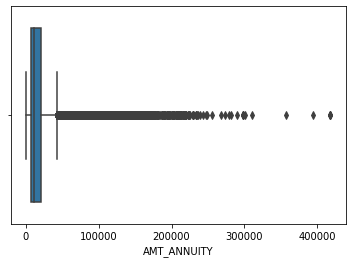

In [176]:
sns.boxplot(prev_app_data['AMT_ANNUITY'])
plt.show()

**Inference** : By observing the graph , mean value is falls in outlier range , so median is used for filling the null values instead of mean.


In [177]:
# fill null values with median value of AMT_ANNUITY
prev_app_data['AMT_ANNUITY'].fillna(value=prev_app_data['AMT_ANNUITY'].median(), inplace=True)

In [178]:
#Checking if the null values in AMT_ANNUITY are deleted
prev_app_data['AMT_ANNUITY'].isnull().sum()

0

#### AMT_CREDIT                     


In [179]:
prev_app_data['AMT_CREDIT'].dtype


dtype('float64')

In [180]:
prev_app_data['AMT_CREDIT'].isnull().sum()


1

In [181]:
round(prev_app_data['AMT_CREDIT'].describe())


count    1670213.0
mean     196114.0 
std      318575.0 
min      0.0      
25%      24160.0  
50%      80541.0  
75%      216418.0 
max      6905160.0
Name: AMT_CREDIT, dtype: float64

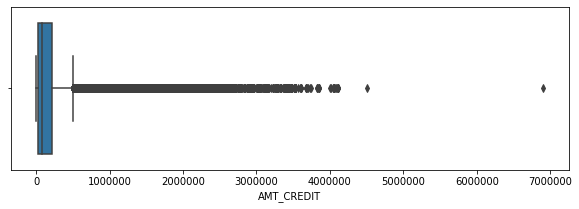

In [182]:
plt.figure(figsize=[10,3])
sns.boxplot(prev_app_data['AMT_CREDIT'])
plt.show()

In [183]:
# fill null values with median value of AMT_CREDIT
prev_app_data['AMT_CREDIT'].fillna(value=prev_app_data['AMT_CREDIT'].median(), inplace=True)


In [184]:
#Checking if the null values in AMT_CREDIT are deleted
prev_app_data['AMT_ANNUITY'].isnull().sum()

0

#### AMT_GOODS_PRICE                



In [185]:
prev_app_data['AMT_GOODS_PRICE'].dtype


dtype('float64')

In [186]:
prev_app_data['AMT_GOODS_PRICE'].isnull().sum()


385515

In [187]:
round(prev_app_data['AMT_GOODS_PRICE'].describe())


count    1284699.0
mean     227847.0 
std      315397.0 
min      0.0      
25%      50841.0  
50%      112320.0 
75%      234000.0 
max      6905160.0
Name: AMT_GOODS_PRICE, dtype: float64

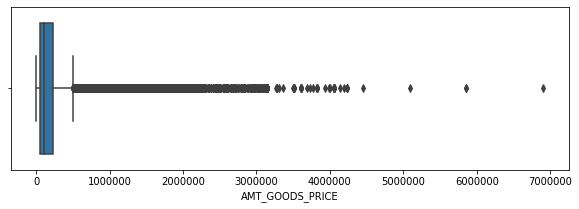

In [188]:
plt.figure(figsize=[10,3])
sns.boxplot(prev_app_data['AMT_GOODS_PRICE'])
plt.show()

In [189]:
# fill null values with median value of AMT_GOODS_PRICE
prev_app_data['AMT_GOODS_PRICE'].fillna(value=prev_app_data['AMT_GOODS_PRICE'].median(), inplace=True)


In [190]:
#Checking if the null values in AMT_GOODS_PRICE are deleted
prev_app_data['AMT_ANNUITY'].isnull().sum()

0

#### CNT_PAYMENT                    



In [191]:
prev_app_data['CNT_PAYMENT'].dtype


dtype('float64')

In [192]:
prev_app_data['CNT_PAYMENT'].isnull().sum()


372230

In [193]:
round(prev_app_data['CNT_PAYMENT'].describe())


count    1297984.0
mean     16.0     
std      15.0     
min      0.0      
25%      6.0      
50%      12.0     
75%      24.0     
max      84.0     
Name: CNT_PAYMENT, dtype: float64

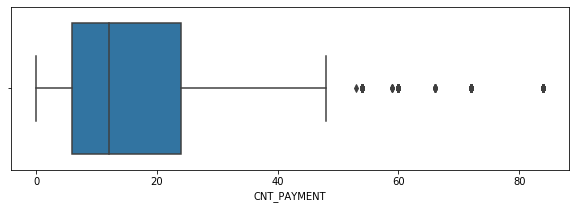

In [194]:
plt.figure(figsize=[10,3])
sns.boxplot(prev_app_data['CNT_PAYMENT'])
plt.show()

In [195]:
# fill null values with mean value of CNT_PAYMENT
prev_app_data['CNT_PAYMENT'].fillna(value=prev_app_data['CNT_PAYMENT'].mean(), inplace=True)


In [196]:
#Checking if the null values in CNT_PAYMENT are deleted
prev_app_data['AMT_ANNUITY'].isnull().sum()


0

#### PRODUCT_COMBINATION            


In [197]:
prev_app_data['PRODUCT_COMBINATION'].dtype


dtype('O')

In [198]:
prev_app_data['PRODUCT_COMBINATION'].isnull().sum()


346

In [199]:
prev_app_data['PRODUCT_COMBINATION'].describe()


count     1669868
unique    17     
top       Cash   
freq      285990 
Name: PRODUCT_COMBINATION, dtype: object

In [200]:
prev_app_data['PRODUCT_COMBINATION'].value_counts(normalize = True)


Cash                              0.171265
POS household with interest       0.157870
POS mobile with interest          0.132148
Cash X-Sell: middle               0.086164
Cash X-Sell: low                  0.077999
Card Street                       0.067420
POS industry with interest        0.059186
POS household without interest    0.049649
Card X-Sell                       0.048257
Cash Street: high                 0.035715
Cash X-Sell: high                 0.035512
Cash Street: middle               0.020755
Cash Street: low                  0.020261
POS mobile without interest       0.014421
POS other with interest           0.014300
POS industry without interest     0.007547
POS others without interest       0.001530
Name: PRODUCT_COMBINATION, dtype: float64

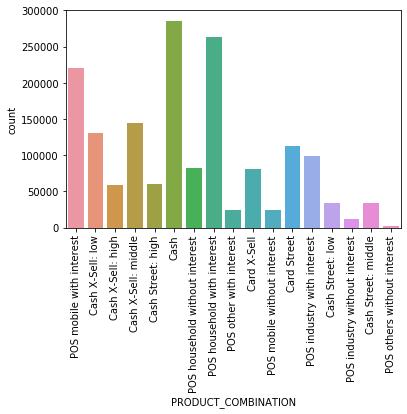

In [201]:
sns.countplot(data=prev_app_data,x='PRODUCT_COMBINATION')
plt.xticks(rotation=90);

In [202]:
prev_app_data['PRODUCT_COMBINATION'].mode()


0    Cash
dtype: object

In [203]:
# fill null values with mode value of PRODUCT_COMBINATION
prev_app_data['PRODUCT_COMBINATION'].fillna(prev_app_data['PRODUCT_COMBINATION'].mode, inplace=True)

In [204]:
#Checking if the null values in PRODUCT_COMBINATION  are deleted
prev_app_data['PRODUCT_COMBINATION'].isnull().sum()

0

In [205]:
# checking Null values in application dataset are cleared
prev_app_data.isnull().sum()

AMT_ANNUITY                    0
AMT_APPLICATION                0
AMT_CREDIT                     0
AMT_GOODS_PRICE                0
CNT_PAYMENT                    0
CODE_REJECT_REASON             0
DAYS_DECISION                  0
FLAG_LAST_APPL_PER_CONTRACT    0
NAME_CASH_LOAN_PURPOSE         0
NAME_CLIENT_TYPE               0
NAME_CONTRACT_STATUS           0
NAME_CONTRACT_TYPE             0
NAME_GOODS_CATEGORY            0
NAME_PAYMENT_TYPE              0
NAME_PORTFOLIO                 0
NAME_SELLER_INDUSTRY           0
NAME_YIELD_GROUP               0
NFLAG_LAST_APPL_IN_DAY         0
PRODUCT_COMBINATION            0
SK_ID_CURR                     0
SK_ID_PREV                     0
WEEKDAY_APPR_PROCESS_START     0
dtype: int64

### Imputing the values in previous application data


In [206]:
prev_app_data.dtypes


AMT_ANNUITY                    float64
AMT_APPLICATION                float64
AMT_CREDIT                     float64
AMT_GOODS_PRICE                float64
CNT_PAYMENT                    float64
CODE_REJECT_REASON             object 
DAYS_DECISION                  int64  
FLAG_LAST_APPL_PER_CONTRACT    object 
NAME_CASH_LOAN_PURPOSE         object 
NAME_CLIENT_TYPE               object 
NAME_CONTRACT_STATUS           object 
NAME_CONTRACT_TYPE             object 
NAME_GOODS_CATEGORY            object 
NAME_PAYMENT_TYPE              object 
NAME_PORTFOLIO                 object 
NAME_SELLER_INDUSTRY           object 
NAME_YIELD_GROUP               object 
NFLAG_LAST_APPL_IN_DAY         int64  
PRODUCT_COMBINATION            object 
SK_ID_CURR                     int64  
SK_ID_PREV                     int64  
WEEKDAY_APPR_PROCESS_START     object 
dtype: object

#### FLAG_LAST_APPL_PER_CONTRACT


In [207]:
prev_app_data['FLAG_LAST_APPL_PER_CONTRACT'].value_counts(normalize=True) * 100

Y    99.49258
N    0.50742 
Name: FLAG_LAST_APPL_PER_CONTRACT, dtype: float64

#### NAME_CASH_LOAN_PURPOSE


In [208]:
prev_app_data['NAME_CASH_LOAN_PURPOSE'].value_counts(normalize=True) * 100


XAP                                 55.242083
XNA                                 40.588691
Repairs                             1.422872 
Other                               0.934491 
Urgent needs                        0.503648 
Buying a used car                   0.172912 
Building a house or an annex        0.161237 
Everyday expenses                   0.144652 
Medicine                            0.130163 
Payments on other loans             0.115614 
Education                           0.094180 
Journey                             0.074182 
Purchase of electronic equipment    0.063525 
Buying a new car                    0.060591 
Wedding / gift / holiday            0.057597 
Buying a home                       0.051790 
Car repairs                         0.047718 
Furniture                           0.044845 
Buying a holiday home / land        0.031912 
Business development                0.025506 
Gasification / water supply         0.017962 
Buying a garage                   

In [209]:
# replace XNA with Other
prev_app_data['NAME_CASH_LOAN_PURPOSE'] = prev_app_data['NAME_CASH_LOAN_PURPOSE'].replace('XNA', 'Other')

In [210]:
# replace XAP with Other
prev_app_data['NAME_CASH_LOAN_PURPOSE'] = prev_app_data['NAME_CASH_LOAN_PURPOSE'].replace('XAP', 'Other')

In [211]:
##checking again the NAME_CASH_LOAN_PURPOSE 
prev_app_data['NAME_CASH_LOAN_PURPOSE'].value_counts(normalize=True) * 100

Other                               96.765265
Repairs                             1.422872 
Urgent needs                        0.503648 
Buying a used car                   0.172912 
Building a house or an annex        0.161237 
Everyday expenses                   0.144652 
Medicine                            0.130163 
Payments on other loans             0.115614 
Education                           0.094180 
Journey                             0.074182 
Purchase of electronic equipment    0.063525 
Buying a new car                    0.060591 
Wedding / gift / holiday            0.057597 
Buying a home                       0.051790 
Car repairs                         0.047718 
Furniture                           0.044845 
Buying a holiday home / land        0.031912 
Business development                0.025506 
Gasification / water supply         0.017962 
Buying a garage                     0.008143 
Hobby                               0.003293 
Money for a third person          

#### NAME_CLIENT_TYPE


In [212]:
prev_app_data['NAME_CLIENT_TYPE'].value_counts(normalize=True) * 100


Repeater     73.718757
New          18.043376
Refreshed    8.121654 
XNA          0.116213 
Name: NAME_CLIENT_TYPE, dtype: float64

In [213]:
# replace XNA with Repeater     
prev_app_data['NAME_CLIENT_TYPE'] = prev_app_data['NAME_CLIENT_TYPE'].replace('XNA', 'Repeater')

In [214]:
##checking again the NAME_CLIENT_TYPE 
prev_app_data['NAME_CLIENT_TYPE'].value_counts(normalize=True) * 100


Repeater     73.834970
New          18.043376
Refreshed    8.121654 
Name: NAME_CLIENT_TYPE, dtype: float64

#### NAME_CONTRACT_TYPE


In [215]:
prev_app_data['NAME_CONTRACT_TYPE'].value_counts(normalize=True) * 100


Cash loans         44.757917
Consumer loans     43.656142
Revolving loans    11.565225
XNA                0.020716 
Name: NAME_CONTRACT_TYPE, dtype: float64

In [216]:
# replace XNA with Cash loans     
prev_app_data['NAME_CONTRACT_TYPE'] = prev_app_data['NAME_CONTRACT_TYPE'].replace('XNA', 'Cash loans')


In [217]:
##checking again the NAME_CONTRACT_TYPE 
prev_app_data['NAME_CONTRACT_TYPE'].value_counts(normalize=True) * 100


Cash loans         44.778633
Consumer loans     43.656142
Revolving loans    11.565225
Name: NAME_CONTRACT_TYPE, dtype: float64

#### NAME_GOODS_CATEGORY


In [218]:
prev_app_data['NAME_GOODS_CATEGORY'].value_counts(normalize=True) * 100


XNA                         56.927376
Mobile                      13.453845
Consumer Electronics        7.279067 
Computers                   6.332662 
Audio/Video                 5.953788 
Furniture                   3.212522 
Photo / Cinema Equipment    1.498072 
Construction Materials      1.496515 
Clothing and Accessories    1.410238 
Auto Accessories            0.441919 
Jewelry                     0.376598 
Homewares                   0.300740 
Medical Supplies            0.230090 
Vehicles                    0.201771 
Sport and Leisure           0.178480 
Gardening                   0.159740 
Other                       0.152915 
Office Appliances           0.139683 
Tourism                     0.099329 
Medicine                    0.092802 
Direct Sales                0.026703 
Fitness                     0.012513 
Additional Service          0.007664 
Education                   0.006406 
Weapon                      0.004610 
Insurance                   0.003832 
House Constr

In [219]:
# replace XNA with Mobile   
prev_app_data['NAME_GOODS_CATEGORY'] = prev_app_data['NAME_GOODS_CATEGORY'].replace('XNA', 'Mobile')


In [220]:
##checking again the NAME_GOODS_CATEGORY 
prev_app_data['NAME_GOODS_CATEGORY'].value_counts(normalize=True) * 100


Mobile                      70.381221
Consumer Electronics        7.279067 
Computers                   6.332662 
Audio/Video                 5.953788 
Furniture                   3.212522 
Photo / Cinema Equipment    1.498072 
Construction Materials      1.496515 
Clothing and Accessories    1.410238 
Auto Accessories            0.441919 
Jewelry                     0.376598 
Homewares                   0.300740 
Medical Supplies            0.230090 
Vehicles                    0.201771 
Sport and Leisure           0.178480 
Gardening                   0.159740 
Other                       0.152915 
Office Appliances           0.139683 
Tourism                     0.099329 
Medicine                    0.092802 
Direct Sales                0.026703 
Fitness                     0.012513 
Additional Service          0.007664 
Education                   0.006406 
Weapon                      0.004610 
Insurance                   0.003832 
House Construction          0.000060 
Animals     

#### NAME_PAYMENT_TYPE


In [221]:
prev_app_data['NAME_PAYMENT_TYPE'].value_counts(normalize=True) * 100


Cash through the bank                        61.881412
XNA                                          37.563091
Non-cash from your account                   0.490536 
Cashless from the account of the employer    0.064962 
Name: NAME_PAYMENT_TYPE, dtype: float64

In [222]:
# replace XNA with Cash through the bank   
prev_app_data['NAME_PAYMENT_TYPE'] = prev_app_data['NAME_PAYMENT_TYPE'].replace('XNA', 'Cash through the bank')


In [223]:
##checking again the NAME_PAYMENT_TYPE 
prev_app_data['NAME_PAYMENT_TYPE'].value_counts(normalize=True) * 100


Cash through the bank                        99.444502
Non-cash from your account                   0.490536 
Cashless from the account of the employer    0.064962 
Name: NAME_PAYMENT_TYPE, dtype: float64

#### NAME_PORTFOLIO


In [224]:
prev_app_data['NAME_PORTFOLIO'].value_counts(normalize=True) * 100


POS      41.372603
Cash     27.634962
XNA      22.286366
Cards    8.680624 
Cars     0.025446 
Name: NAME_PORTFOLIO, dtype: float64

In [225]:

# replace XNA with POS        
prev_app_data['NAME_PORTFOLIO'] = prev_app_data['NAME_PORTFOLIO'].replace('XNA', 'POS')


In [226]:
##checking again the NAME_PORTFOLIO 
prev_app_data['NAME_PORTFOLIO'].value_counts(normalize=True) * 100

POS      63.658968
Cash     27.634962
Cards    8.680624 
Cars     0.025446 
Name: NAME_PORTFOLIO, dtype: float64

#### NAME_SELLER_INDUSTRY


In [227]:
prev_app_data['NAME_SELLER_INDUSTRY'].value_counts(normalize=True) * 100


XNA                     51.234153
Consumer electronics    23.845148
Connectivity            16.526565
Furniture               3.463568 
Construction            1.783065 
Clothing                1.433888 
Industry                1.149194 
Auto technology         0.298764 
Jewelry                 0.162195 
MLM partners            0.072745 
Tourism                 0.030715 
Name: NAME_SELLER_INDUSTRY, dtype: float64

In [228]:
# replace XNA with Consumer electronics         
prev_app_data['NAME_SELLER_INDUSTRY'] = prev_app_data['NAME_SELLER_INDUSTRY'].replace('XNA', 'Consumer electronics')


In [229]:
#checking again the NAME_SELLER_INDUSTRY 
prev_app_data['NAME_SELLER_INDUSTRY'].value_counts(normalize=True) * 100


Consumer electronics    75.079301
Connectivity            16.526565
Furniture               3.463568 
Construction            1.783065 
Clothing                1.433888 
Industry                1.149194 
Auto technology         0.298764 
Jewelry                 0.162195 
MLM partners            0.072745 
Tourism                 0.030715 
Name: NAME_SELLER_INDUSTRY, dtype: float64

#### NAME_YIELD_GROUP


In [230]:
prev_app_data['NAME_YIELD_GROUP'].value_counts(normalize=True) * 100


XNA           30.966990
middle        23.082791
high          21.154834
low_normal    19.284655
low_action    5.510731 
Name: NAME_YIELD_GROUP, dtype: float64

In [231]:
# replace XNA with middle               
prev_app_data['NAME_YIELD_GROUP'] = prev_app_data['NAME_YIELD_GROUP'].replace('XNA', 'middle')


In [232]:

#checking again the NAME_YIELD_GROUP 
prev_app_data['NAME_YIELD_GROUP'].value_counts(normalize=True) * 100

middle        54.049780
high          21.154834
low_normal    19.284655
low_action    5.510731 
Name: NAME_YIELD_GROUP, dtype: float64

### <font color = black>Handling Outliers in  Previous Application Data :</font>


In [233]:
round(prev_app_data.describe())


,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,CNT_PAYMENT,DAYS_DECISION,NFLAG_LAST_APPL_IN_DAY,SK_ID_CURR,SK_ID_PREV
count,1670214.0,1670214.0,1670214.0,1670214.0,1670214.0,1670214.0,1670214.0,1670214.0,1670214.0
mean,14907.0,175234.0,196114.0,201182.0,16.0,-881.0,1.0,278357.0,1923089.0
std,13178.0,292780.0,318575.0,280863.0,13.0,779.0,0.0,102815.0,532598.0
min,0.0,0.0,0.0,0.0,0.0,-2922.0,0.0,100001.0,1000001.0
25%,7547.0,18720.0,24160.0,67500.0,10.0,-1300.0,1.0,189329.0,1461857.0
50%,11250.0,71046.0,80541.0,112320.0,12.0,-581.0,1.0,278714.0,1923110.0
75%,16824.0,180360.0,216418.0,180405.0,16.0,-280.0,1.0,367514.0,2384280.0
max,418058.0,6905160.0,6905160.0,6905160.0,84.0,-1.0,1.0,456255.0,2845382.0


In [234]:
prev_app_data.dtypes

AMT_ANNUITY                    float64
AMT_APPLICATION                float64
AMT_CREDIT                     float64
AMT_GOODS_PRICE                float64
CNT_PAYMENT                    float64
CODE_REJECT_REASON             object 
DAYS_DECISION                  int64  
FLAG_LAST_APPL_PER_CONTRACT    object 
NAME_CASH_LOAN_PURPOSE         object 
NAME_CLIENT_TYPE               object 
NAME_CONTRACT_STATUS           object 
NAME_CONTRACT_TYPE             object 
NAME_GOODS_CATEGORY            object 
NAME_PAYMENT_TYPE              object 
NAME_PORTFOLIO                 object 
NAME_SELLER_INDUSTRY           object 
NAME_YIELD_GROUP               object 
NFLAG_LAST_APPL_IN_DAY         int64  
PRODUCT_COMBINATION            object 
SK_ID_CURR                     int64  
SK_ID_PREV                     int64  
WEEKDAY_APPR_PROCESS_START     object 
dtype: object

#### AMT_ANNUITY


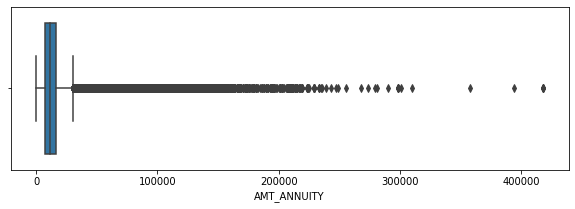

In [235]:
#Analysing the outliers in prev_app_data table (AMT_ANNUITY)

plt.figure(figsize=[10,3])
sns.boxplot(prev_app_data['AMT_ANNUITY'])
plt.show()

**Inference** : Here, in the coloumn 'AMT_ANNUITY' which tells the loan annuity. We observe a values which are greater than 200000 which are surely an outliers.

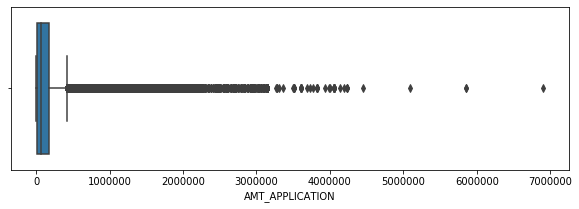

In [236]:
#Analysing the outliers in prev_app_data table (AMT_APPLICATION)

plt.figure(figsize=[10,3])
sns.boxplot(prev_app_data['AMT_APPLICATION'])
plt.show()

**Inference** : Here, in the coloumn 'AMT_APPLICATION' which tells the loan annuity. We observe a values which are greater than 3000000 which are surely an outliers.

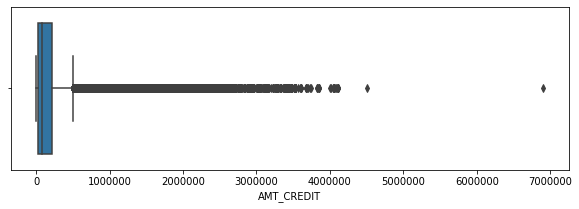

In [237]:
#Analysing the outliers in prev_app_data table (AMT_CREDIT)

plt.figure(figsize=[10,3])
sns.boxplot(prev_app_data['AMT_CREDIT'])
plt.show()

**Inference** : Here, in the coloumn 'AMT_CREDIT' which tells the loan annuity. We observe a values which are greater than 4000000 which are surely an outliers.

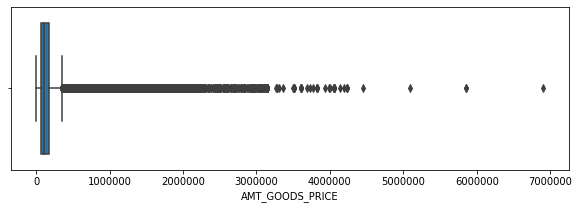

In [238]:
#Analysing the outliers in prev_app_data table (AMT_GOODS_PRICE)

plt.figure(figsize=[10,3])
sns.boxplot(prev_app_data['AMT_GOODS_PRICE'])
plt.show()

**Inference** : Here, in the coloumn 'AMT_GOODS_PRICE' which tells the loan annuity. We observe a values which are greater than 3000000 which are surely an outliers.

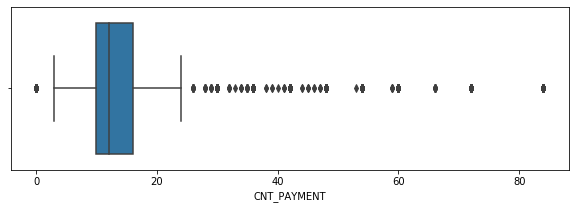

In [239]:
#Analysing the outliers in prev_app_data table (CNT_PAYMENT)

plt.figure(figsize=[10,3])
sns.boxplot(prev_app_data['CNT_PAYMENT'])
plt.show()

**Inference** : Here, in the coloumn 'CNT_PAYMENT' which tells the loan annuity. We observe a values which are greater than 20 which are surely an outliers.

### <font color = black>Standardising Values in Previous Application data :</font>


In [240]:
sorted(prev_app_data.columns)


['AMT_ANNUITY',
 'AMT_APPLICATION',
 'AMT_CREDIT',
 'AMT_GOODS_PRICE',
 'CNT_PAYMENT',
 'CODE_REJECT_REASON',
 'DAYS_DECISION',
 'FLAG_LAST_APPL_PER_CONTRACT',
 'NAME_CASH_LOAN_PURPOSE',
 'NAME_CLIENT_TYPE',
 'NAME_CONTRACT_STATUS',
 'NAME_CONTRACT_TYPE',
 'NAME_GOODS_CATEGORY',
 'NAME_PAYMENT_TYPE',
 'NAME_PORTFOLIO',
 'NAME_SELLER_INDUSTRY',
 'NAME_YIELD_GROUP',
 'NFLAG_LAST_APPL_IN_DAY',
 'PRODUCT_COMBINATION',
 'SK_ID_CURR',
 'SK_ID_PREV',
 'WEEKDAY_APPR_PROCESS_START']

#### DAYS_DECISION


In [241]:
prev_app_data.DAYS_DECISION.head()


0   -73 
1   -164
2   -301
3   -512
4   -781
Name: DAYS_DECISION, dtype: int64

In [242]:
# remove sign (-) from DAYS_DECISION
prev_app_data['DAYS_DECISION'] = prev_app_data['DAYS_DECISION'].apply(lambda x: abs(x))
prev_app_data.DAYS_DECISION.head()


0    73 
1    164
2    301
3    512
4    781
Name: DAYS_DECISION, dtype: int64

In [243]:

prev_app_data.head()

,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,CNT_PAYMENT,CODE_REJECT_REASON,DAYS_DECISION,FLAG_LAST_APPL_PER_CONTRACT,NAME_CASH_LOAN_PURPOSE,NAME_CLIENT_TYPE,...,NAME_GOODS_CATEGORY,NAME_PAYMENT_TYPE,NAME_PORTFOLIO,NAME_SELLER_INDUSTRY,NAME_YIELD_GROUP,NFLAG_LAST_APPL_IN_DAY,PRODUCT_COMBINATION,SK_ID_CURR,SK_ID_PREV,WEEKDAY_APPR_PROCESS_START
0,1730.430,17145.0,17145.0,17145.0,12.0,XAP,73,Y,Other,Repeater,...,Mobile,Cash through the bank,POS,Connectivity,middle,1,POS mobile with interest,271877,2030495,SATURDAY
1,25188.615,607500.0,679671.0,607500.0,36.0,XAP,164,Y,Other,Repeater,...,Mobile,Cash through the bank,Cash,Consumer electronics,low_action,1,Cash X-Sell: low,108129,2802425,THURSDAY
2,15060.735,112500.0,136444.5,112500.0,12.0,XAP,301,Y,Other,Repeater,...,Mobile,Cash through the bank,Cash,Consumer electronics,high,1,Cash X-Sell: high,122040,2523466,TUESDAY
3,47041.335,450000.0,470790.0,450000.0,12.0,XAP,512,Y,Other,Repeater,...,Mobile,Cash through the bank,Cash,Consumer electronics,middle,1,Cash X-Sell: middle,176158,2819243,MONDAY
4,31924.395,337500.0,404055.0,337500.0,24.0,HC,781,Y,Repairs,Repeater,...,Mobile,Cash through the bank,Cash,Consumer electronics,high,1,Cash Street: high,202054,1784265,THURSDAY


In [244]:
#Checking if the data is balance or imbalance for prev_app_data
(prev_app_data['NAME_CONTRACT_STATUS'].value_counts(normalize=True))*100

Approved        62.074740
Canceled        18.938831
Refused         17.403638
Unused offer    1.582791 
Name: NAME_CONTRACT_STATUS, dtype: float64

##  Merge Previous Application Dataset with Application Dataset 


In [245]:
# merge dataset using inner join on SK_ID_CURR
both_datasets = pd.merge(app_data, prev_app_data, how='inner', on=['SK_ID_CURR'])
both_datasets.shape

(1413701, 60)

In [246]:
both_datasets.head()

,AMT_ANNUITY_x,AMT_CREDIT_x,AMT_GOODS_PRICE_x,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,...,NAME_CONTRACT_TYPE_y,NAME_GOODS_CATEGORY,NAME_PAYMENT_TYPE,NAME_PORTFOLIO,NAME_SELLER_INDUSTRY,NAME_YIELD_GROUP,NFLAG_LAST_APPL_IN_DAY,PRODUCT_COMBINATION,SK_ID_PREV,WEEKDAY_APPR_PROCESS_START_y
0,24700.5,406597.5,351000.0,MEDIUM,0.0,0.0,0.0,0.0,0.0,1.0,...,Consumer loans,Vehicles,Cash through the bank,POS,Auto technology,low_normal,1,POS other with interest,1038818,SATURDAY
1,35698.5,1293502.5,1129500.0,HIGH,0.0,0.0,0.0,0.0,0.0,0.0,...,Cash loans,Mobile,Cash through the bank,Cash,Consumer electronics,low_normal,1,Cash X-Sell: low,1810518,FRIDAY
2,35698.5,1293502.5,1129500.0,HIGH,0.0,0.0,0.0,0.0,0.0,0.0,...,Consumer loans,Furniture,Cash through the bank,POS,Furniture,middle,1,POS industry with interest,2636178,SUNDAY
3,35698.5,1293502.5,1129500.0,HIGH,0.0,0.0,0.0,0.0,0.0,0.0,...,Consumer loans,Consumer Electronics,Cash through the bank,POS,Consumer electronics,middle,1,POS household with interest,2396755,SATURDAY
4,6750.0,135000.0,135000.0,VERY_LOW,0.0,0.0,0.0,0.0,0.0,0.0,...,Consumer loans,Mobile,Cash through the bank,POS,Connectivity,middle,1,POS mobile without interest,1564014,FRIDAY


In [247]:
both_datasets.dtypes

AMT_ANNUITY_x                   float64 
AMT_CREDIT_x                    float64 
AMT_GOODS_PRICE_x               float64 
AMT_INCOME_TOTAL                category
AMT_REQ_CREDIT_BUREAU_DAY       float64 
AMT_REQ_CREDIT_BUREAU_HOUR      float64 
AMT_REQ_CREDIT_BUREAU_MON       float64 
AMT_REQ_CREDIT_BUREAU_QRT       float64 
AMT_REQ_CREDIT_BUREAU_WEEK      float64 
AMT_REQ_CREDIT_BUREAU_YEAR      float64 
CNT_CHILDREN                    int64   
CNT_FAM_MEMBERS                 float64 
CODE_GENDER                     object  
YRS_EMPLOYED                    float64 
YRS_ID_PUBLISH                  float64 
YRS_REGISTRATION                float64 
FLAG_OWN_CAR                    object  
FLAG_OWN_REALTY                 object  
HOUR_APPR_PROCESS_START         int64   
LIVE_CITY_NOT_WORK_CITY         int64   
LIVE_REGION_NOT_WORK_REGION     int64   
NAME_CONTRACT_TYPE_x            object  
NAME_EDUCATION_TYPE             object  
NAME_FAMILY_STATUS              object  
NAME_HOUSING_TYP

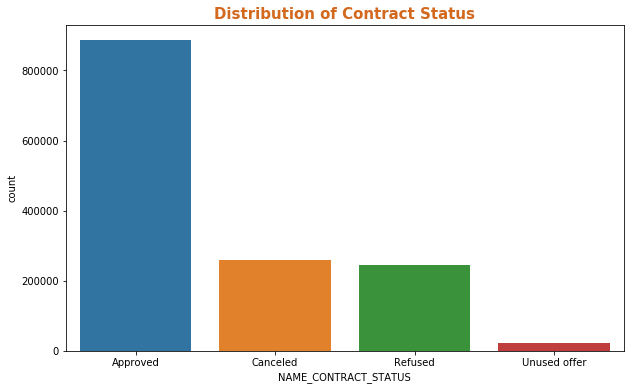

In [248]:
# Plotting the Distribution of Contract Status

plt.figure(figsize=[10, 6])
sns.countplot(both_datasets['NAME_CONTRACT_STATUS'])
plt.title("Distribution of Contract Status", 
          fontdict={'size':15, 'color':'chocolate', 'fontweight':'bold'})
plt.show()

**`Inference`** : In the above plot, approved applications are high.

In [249]:
#Pivot table of contract type, contract status
contract_type_pivot_x = both_datasets.pivot_table(values="SK_ID_PREV",index='NAME_CONTRACT_TYPE_x',columns=['TARGET','NAME_CONTRACT_STATUS'],aggfunc='count')
contract_type_pivot_x

TARGET                      0                                      1           \
NAME_CONTRACT_STATUS Approved Canceled Refused Unused offer Approved Canceled   
NAME_CONTRACT_TYPE_x                                                            
Cash loans            752793   218803   200096  18894        63778    22749     
Revolving loans       66063    16838    15856   1998         3465     1051      

TARGET                                     
NAME_CONTRACT_STATUS Refused Unused offer  
NAME_CONTRACT_TYPE_x                       
Cash loans            28255   1747         
Revolving loans       1183    132

In [250]:
#Pivot table of contract type, contract status
contract_type_pivot_y = both_datasets.pivot_table(values="SK_ID_PREV",index='NAME_CONTRACT_TYPE_y',columns=['TARGET','NAME_CONTRACT_STATUS'],aggfunc='count')
contract_type_pivot_y

TARGET                       0                                         1  \
NAME_CONTRACT_STATUS  Approved  Canceled   Refused Unused offer Approved   
NAME_CONTRACT_TYPE_y                                                       
Cash loans            246265.0  201129.0  122031.0  392.0        20116.0   
Consumer loans        497628.0  1158.0    57767.0   20496.0      39682.0   
Revolving loans       74963.0   33354.0   36154.0   4.0          7445.0    

TARGET                                               
NAME_CONTRACT_STATUS Canceled  Refused Unused offer  
NAME_CONTRACT_TYPE_y                                 
Cash loans            19538.0  17566.0  40.0         
Consumer loans        171.0    6515.0   1839.0       
Revolving loans       4091.0   5357.0  NaN

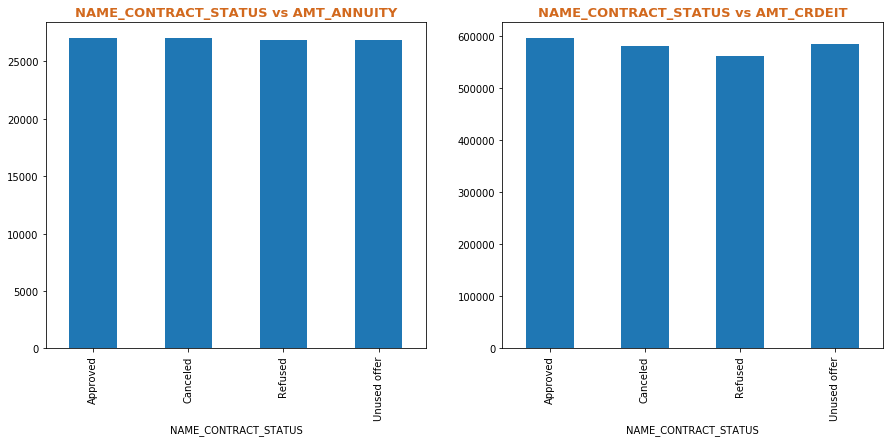

In [251]:
#Analyis of contract status vs Annuity and contract status vs Credit
plt.figure(figsize=[15, 6])

plt.subplot(1,2,1)
both_datasets.groupby('NAME_CONTRACT_STATUS')['AMT_ANNUITY_x'].mean().plot.bar()
plt.title('NAME_CONTRACT_STATUS vs AMT_ANNUITY', 
         fontdict={'size':13, 'color':'chocolate', 'fontweight':'bold'})

plt.subplot(1,2,2)
both_datasets.groupby('NAME_CONTRACT_STATUS')['AMT_CREDIT_x'].mean().plot.bar()
plt.title('NAME_CONTRACT_STATUS vs AMT_CRDEIT', 
         fontdict={'size':13, 'color':'chocolate', 'fontweight':'bold'})

plt.show()

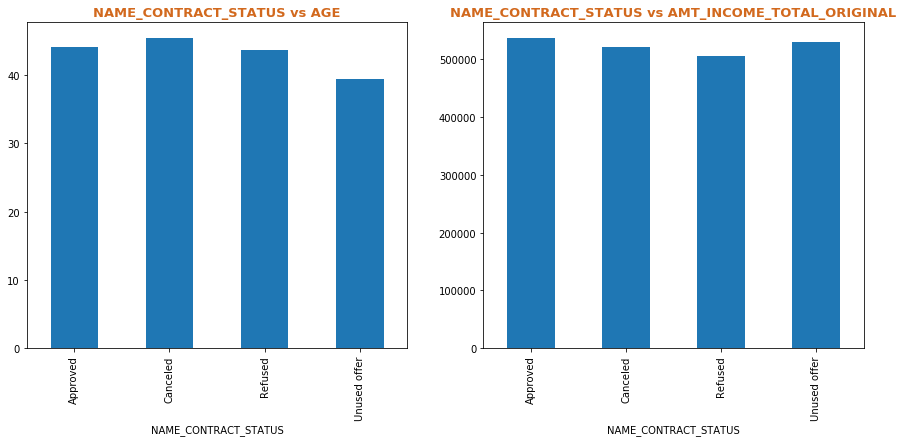

In [252]:
#Analysis of contract status Vs Age and Contract Status Vs Income
plt.figure(figsize=[15, 6])

plt.subplot(1,2,1)
both_datasets.groupby('NAME_CONTRACT_STATUS')['AGE'].mean().plot.bar()
plt.title('NAME_CONTRACT_STATUS vs AGE', 
         fontdict={'size':13, 'color':'chocolate', 'fontweight':'bold'})

plt.subplot(1,2,2)
both_datasets.groupby('NAME_CONTRACT_STATUS')['AMT_GOODS_PRICE_x'].mean().plot.bar()
plt.title('NAME_CONTRACT_STATUS vs AMT_INCOME_TOTAL_ORIGINAL', 
         fontdict={'size':13, 'color':'chocolate', 'fontweight':'bold'})

plt.show()

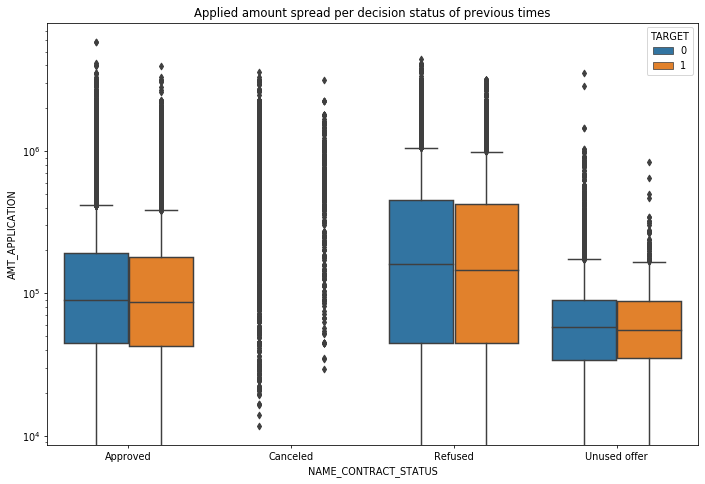

In [253]:
#Applied amounts of previous application
plt.figure(num=None,figsize=(12,8),dpi=70,edgecolor='y')
sns.boxplot(x='NAME_CONTRACT_STATUS',y='AMT_APPLICATION',hue='TARGET',data=both_datasets)
plt.yscale('log')
plt.title("Applied amount spread per decision status of previous times")
plt.show()

**`Inference`** : 
We see that we have heavily populated values as outliers in the canceled applications. The applied amounts were largely unusual and that could be one of the reasons why they were canceled. In refused applications, varied magnitude of amounts were applied and also high compared to the applied amounts in approved applications. Generally amounts that were applied but applications were canceled at a later stage had usually low application amount (Unused offer). By and large, there is no difference in the applications there were or are prone to default risk and are not prone to default risk

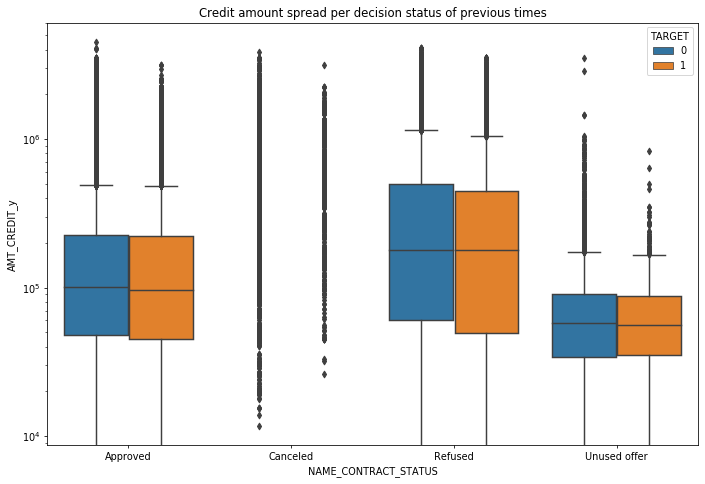

In [254]:
#Credit given of previous applications
plt.figure(num=None,figsize=(12,8),dpi=70,edgecolor='y')
sns.boxplot(x='NAME_CONTRACT_STATUS',y='AMT_CREDIT_y',hue='TARGET',data=both_datasets)
plt.yscale('log')
plt.title("Credit amount spread per decision status of previous times")
plt.show()

**`Inference`** :
- We see that we have heavily populated values as outliers in the canceled applications. The applied amounts were largely unusual and that could be one of the reasons why they were canceled. In refused applications, varied magnitude of amounts were given as credit and also high compared to the credit amounts in approved applications. Generally amounts that were given as credit but applications were canceled at a later stage had usually low credit amount (Unused offer). By and large, there is no difference in the applications there were or are prone to default risk and are not prone to default risk. Also, we can see that data spread of applied amounts and credited amounts for approved applications and all other types are same.
- To dig more into canceled applications, we have largely 0 amount with surprisingly high values as well. This could be a question to check, why there are application records of applied amount as 0 which would make no sense.


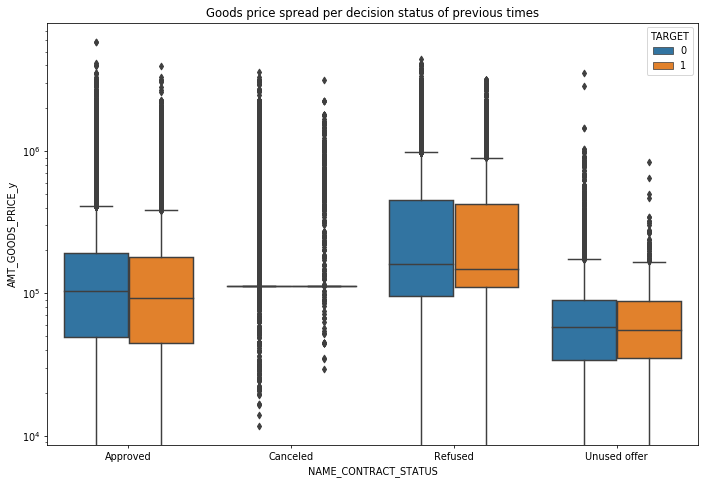

In [255]:
#Goods price of previous applications
plt.figure(num=None,figsize=(12,8),dpi=70,edgecolor='y')
sns.boxplot(x='NAME_CONTRACT_STATUS',y='AMT_GOODS_PRICE_y',hue='TARGET',data=both_datasets)
plt.yscale('log')
plt.title("Goods price spread per decision status of previous times")
plt.show()

In [256]:
#Type of payment of previous applications
payment_type_pivot = both_datasets.pivot_table(values="SK_ID_PREV",index='NAME_PAYMENT_TYPE',columns=['TARGET','NAME_CONTRACT_STATUS'],aggfunc='count')
payment_type_pivot

TARGET                                           0                   \
NAME_CONTRACT_STATUS                      Approved Canceled Refused   
NAME_PAYMENT_TYPE                                                     
Cash through the bank                      812625   235598   214873   
Cashless from the account of the employer  695      14       152      
Non-cash from your account                 5536     29       927      

TARGET                                                        1           \
NAME_CONTRACT_STATUS                      Unused offer Approved Canceled   
NAME_PAYMENT_TYPE                                                          
Cash through the bank                      20863        66720    23797     
Cashless from the account of the employer  4            56       1         
Non-cash from your account                 25           467      2         

TARGET                                                          
NAME_CONTRACT_STATUS                      Refused Unused offer  
NAME_PAYMENT_TYPE                                               
Cash through the bank                      29311   1873         
Cashless from the account of the employer  17      2            
Non-cash from your account                 110     4

* We have just shown a pivot table here, since apart from cash through bank, other categories of payment do not have any high numbers. We can see that more than 810000 of the approved applications that are not at default risk, had a mode of payment as : cash from bank. Approx more than 210000 applications that did not have default risk and were refused, had similar mode of payment. Approx more than 60000 of the approved applications that are at default risk, had similar mode of payment. We can see approx 5000 applications that were approved and are not prone to default risk, had non cash mode of payment too. 

In [257]:
#Goods category types in previous applications
goods_catg_pivot = both_datasets.pivot_table(values="SK_ID_PREV",index='NAME_GOODS_CATEGORY',columns=['TARGET','NAME_CONTRACT_STATUS'],aggfunc='count')
goods_catg_pivot

TARGET                           0                                         1  \
NAME_CONTRACT_STATUS      Approved  Canceled   Refused Unused offer Approved   
NAME_GOODS_CATEGORY                                                            
Additional Service        93.0     NaN        9.0      NaN           4.0       
Animals                   1.0      NaN       NaN       NaN          NaN        
Audio/Video               71216.0   23.0      6929.0    783.0        5714.0    
Auto Accessories          5055.0    2.0       502.0     104.0        484.0     
Clothing and Accessories  16900.0  NaN        1505.0    68.0         964.0     
Computers                 69147.0   22.0      10221.0   3245.0       5705.0    
Construction Materials    17911.0   4.0       1906.0    47.0         1273.0    
Consumer Electronics      89698.0   18.0      6896.0    768.0        6572.0    
Direct Sales              258.0    NaN        44.0      1.0          19.0      
Education                 71.0     NaN        13.0     NaN           4.0       
Fitness                   157.0    NaN        2.0      NaN           7.0       
Furniture                 39301.0   8.0       3293.0    179.0        2327.0    
Gardening                 2011.0   NaN        146.0     9.0          136.0     
Homewares                 3684.0   NaN        326.0     13.0         242.0     
Insurance                 43.0     NaN        8.0       1.0          5.0       
Jewelry                   4294.0    1.0       411.0     13.0         396.0     
Medical Supplies          2836.0    1.0       219.0     2.0          160.0     
Medicine                  1143.0   NaN        79.0     NaN           76.0      
Mobile                    468486.0  235555.0  180783.0  14551.0      41097.0   
Office Appliances         1626.0   NaN        187.0     8.0          150.0     
Other                     2098.0   NaN        105.0    NaN           128.0     
Photo / Cinema Equipment  17177.0   6.0       1792.0    1076.0       1333.0    
Sport and Leisure         2158.0   NaN        188.0     10.0         158.0     
Tourism                   1128.0    1.0       134.0     5.0          49.0      
Vehicles                  2309.0   NaN        249.0     9.0          236.0     
Weapon                    55.0     NaN        5.0      NaN           4.0       

TARGET                                                   
NAME_CONTRACT_STATUS     Canceled  Refused Unused offer  
NAME_GOODS_CATEGORY                                      
Additional Service       NaN       3.0     NaN           
Animals                  NaN      NaN      NaN           
Audio/Video               1.0      790.0    46.0         
Auto Accessories         NaN       67.0     14.0         
Clothing and Accessories NaN       149.0    4.0          
Computers                 4.0      1272.0   307.0        
Construction Materials    1.0      210.0    4.0          
Consumer Electronics      3.0      785.0    45.0         
Direct Sales             NaN       8.0     NaN           
Education                NaN       1.0     NaN           
Fitness                  NaN      NaN      NaN           
Furniture                NaN       320.0    11.0         
Gardening                NaN       20.0    NaN           
Homewares                NaN       43.0     1.0          
Insurance                NaN       1.0     NaN           
Jewelry                  NaN       72.0     1.0          
Medical Supplies         NaN       22.0    NaN           
Medicine                 NaN       4.0     NaN           
Mobile                    23790.0  25353.0  1337.0       
Office Appliances        NaN       13.0     1.0          
Other                    NaN       6.0     NaN           
Photo / Cinema Equipment  1.0      219.0    103.0        
Sport and Leisure        NaN       24.0     2.0          
Tourism                  NaN       7.0     NaN           
Vehicles                 NaN       48.0     3.0          
Weapon                   NaN       1.0     NaN

#### Due to high number of categories, we have just shown pivot table. As,we can see that mobile phone are maximum for which loans were approved and these loan applications are also not at risk of default, followed by consumer electronics, audio/video and computers. Same is evident for those applications which are at risk of default

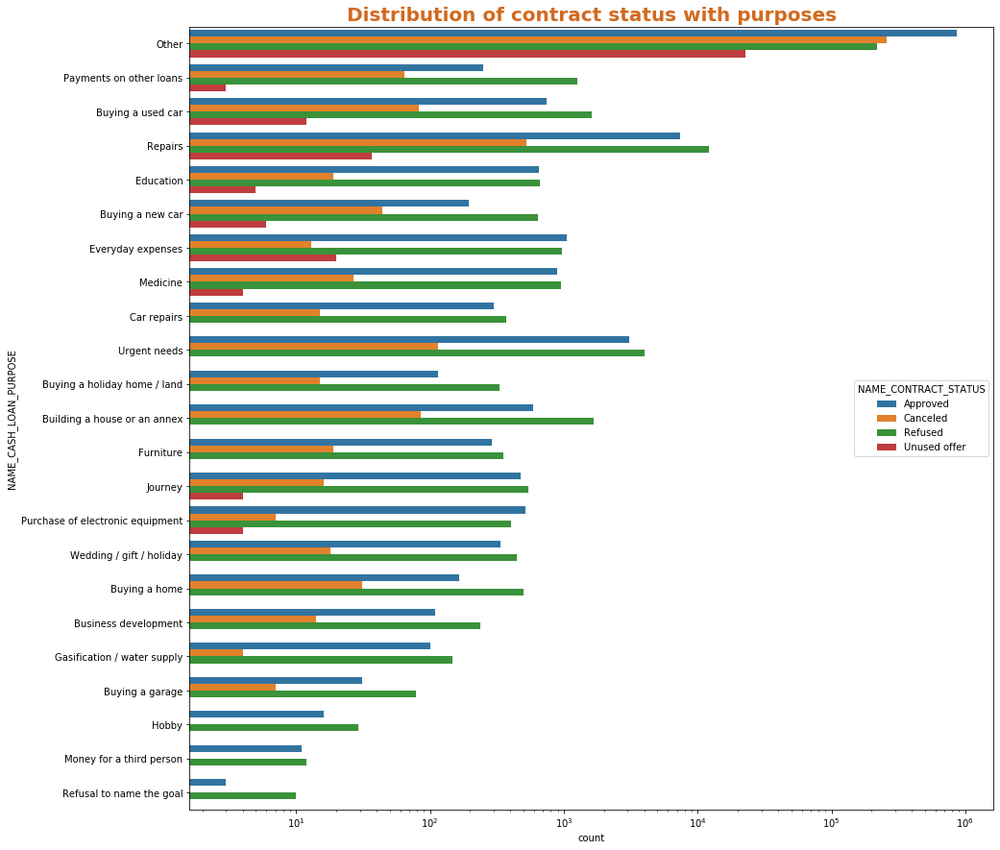

In [258]:
#Analysis of contract status with purposes
plt.figure(figsize=[15,15])
sns.countplot(data = both_datasets, y= 'NAME_CASH_LOAN_PURPOSE', hue='NAME_CONTRACT_STATUS')
plt.title('Distribution of contract status with purposes', 
          fontdict={'size':20, 'color':'chocolate', 'fontweight':'bold'})
plt.xscale('log')
plt.show()

**`Inference`** :
- Most of the refused applications is from Repairs.
- In purchase of electronic equipment and everyday expenses, approved application status is more than refused one.
- Approved and Refused status seems to be almost equal in education.

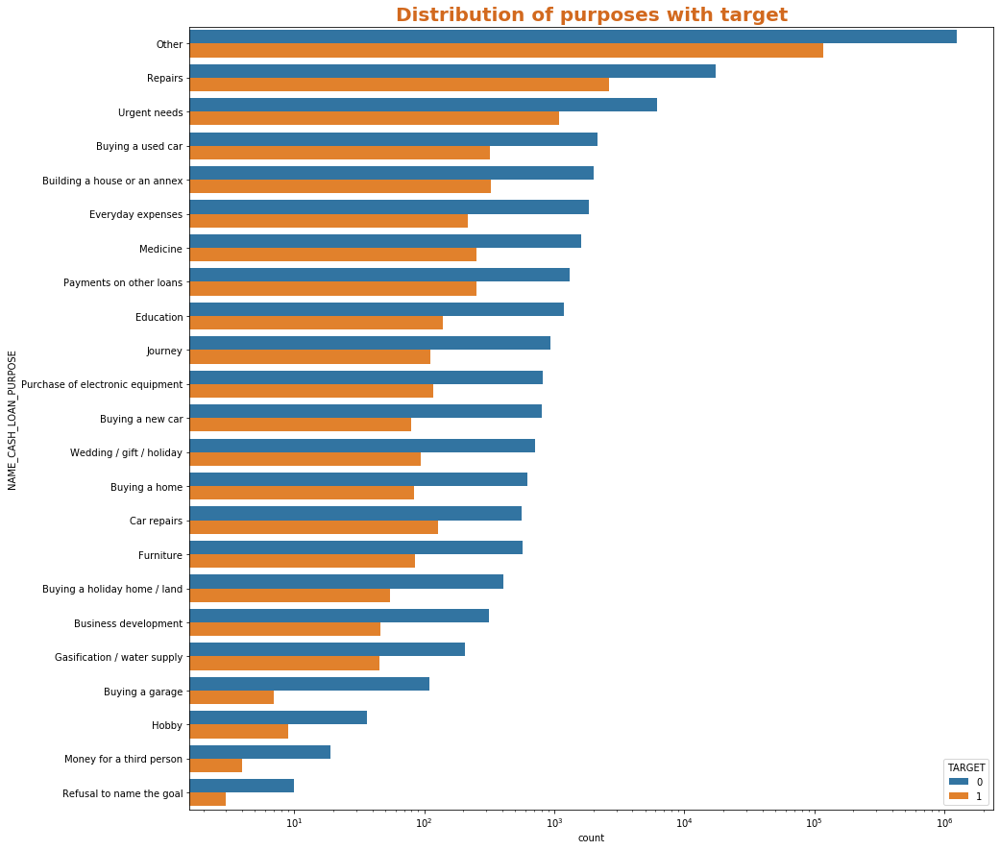

In [259]:
#Analysis of distribution purpose with target
plt.figure(figsize=[15,15])

sns.countplot(data = both_datasets, y= 'NAME_CASH_LOAN_PURPOSE',
              order=both_datasets['NAME_CASH_LOAN_PURPOSE'].value_counts().index,
              hue = 'TARGET')

plt.title('Distribution of purposes with target', 
          fontdict={'size':20, 'color':'chocolate', 'fontweight':'bold'})

plt.xscale('log')
plt.show()

**`Inference`** :
1. Loan payment is significant higher than facing difficulties in some scenarios i.e, 'Buying a garage', 'Business developemt', 'Buying land','Buying a new car' and 'Education'.
2. Loan purposes with 'Repairs' are facing more difficulites in payment on time.

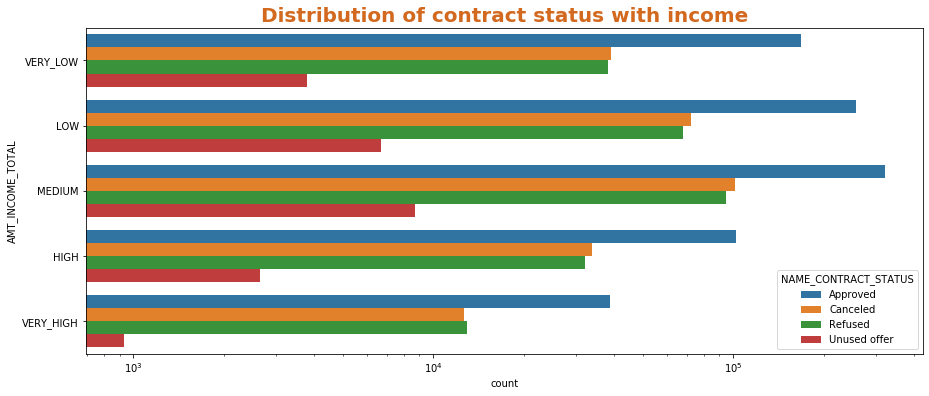

In [260]:
#Analysis of contract status and income
plt.figure(figsize=[15,6])
sns.countplot(data = both_datasets, y= 'AMT_INCOME_TOTAL', hue='NAME_CONTRACT_STATUS')
plt.title('Distribution of contract status with income', 
          fontdict={'size':20, 'color':'chocolate', 'fontweight':'bold'})
plt.xscale('log')
plt.show()

**`Inference`** :
People having high income have most of the applications approved.
People having very high income have same number of canceled or refused status.

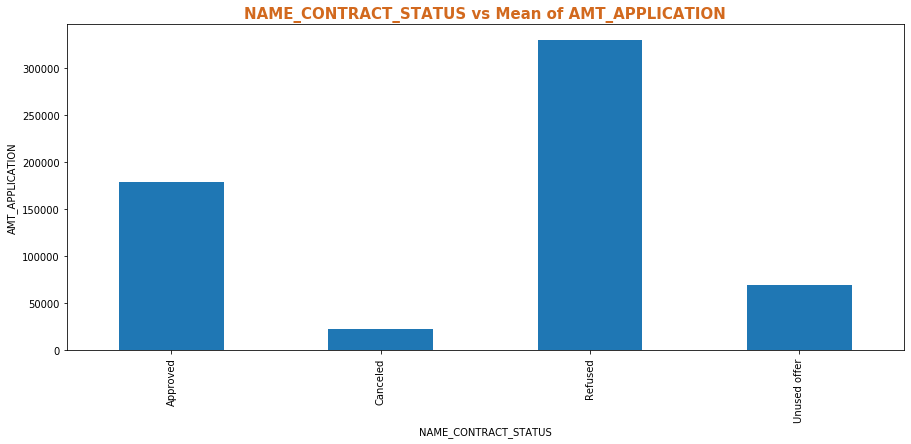

In [261]:
#Analysis of contract status and mean amount application
plt.figure(figsize=[15, 6])

both_datasets.groupby('NAME_CONTRACT_STATUS')['AMT_APPLICATION'].mean().plot.bar()
plt.title('NAME_CONTRACT_STATUS vs Mean of AMT_APPLICATION', 
         fontdict={'size':15, 'color':'chocolate', 'fontweight':'bold'})

plt.ylabel('AMT_APPLICATION')

plt.show()

**`Inference`** : In the above plot, application amount is quite high (300k) in the loan application status that are refused.

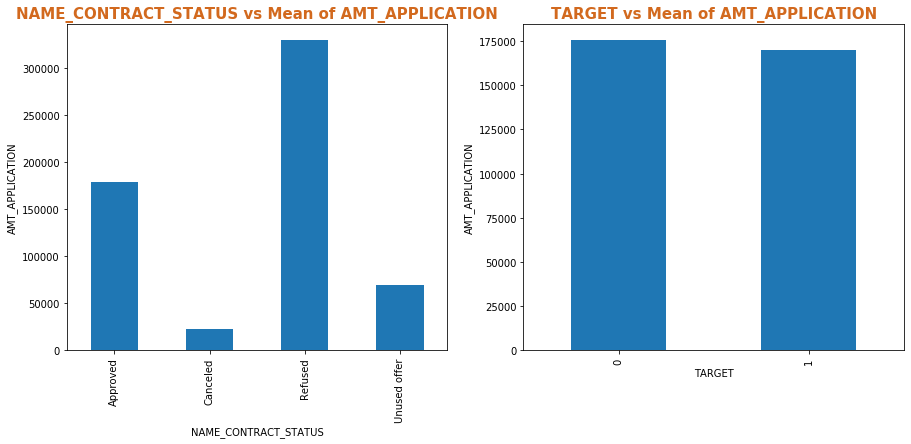

In [262]:
# Analysis of contract status and amount application
plt.figure(figsize=[15, 6])
plt.subplot(1,2,1)

both_datasets.groupby('NAME_CONTRACT_STATUS')['AMT_APPLICATION'].mean().plot.bar()
plt.title('NAME_CONTRACT_STATUS vs Mean of AMT_APPLICATION', 
         fontdict={'size':15, 'color':'chocolate', 'fontweight':'bold'})

plt.ylabel('AMT_APPLICATION')

plt.subplot(1,2,2)

both_datasets.groupby('TARGET')['AMT_APPLICATION'].mean().plot.bar()
plt.title('TARGET vs Mean of AMT_APPLICATION', 
         fontdict={'size':15, 'color':'chocolate', 'fontweight':'bold'})

plt.ylabel('AMT_APPLICATION')

plt.show()

**`Inference`** :
As high the amount application, more the refused applications.


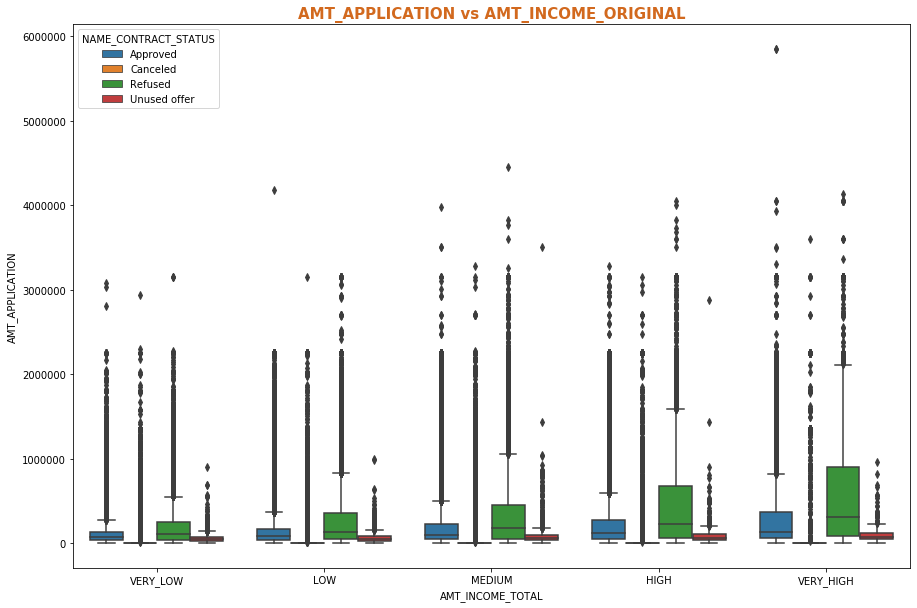

In [263]:
#Amount application and income analysis
plt.figure(figsize=[15,10])
plt.title('AMT_APPLICATION vs AMT_INCOME_ORIGINAL',
         fontdict={'size':15, 'color':'chocolate', 'fontweight':'bold'})

sns.boxplot(data = both_datasets, x='AMT_INCOME_TOTAL',y= 'AMT_APPLICATION', hue='NAME_CONTRACT_STATUS')
plt.show()

**`Inference`** : 

As high the amount application, a greater number of refused applications.
There are a smaller number of rejected applications for Income category very low.

## Insights

Bank should refuse loan application if loan amount is higher than 300k and income is less than 100k.

Banks should focus less on income type ‘Working’ as they are having the greatest number of unsuccessful payments.

Loan purpose ‘Repair’ is having higher number of unsuccessful payments on time.

Bank should refuse loan application of Labors because they found as most defaulter.

Banks should focus more on contract type ‘Student’ , ’pensioner’ and ‘Businessman’ with housing ‘type other than ‘Co-op apartment’ for successful payments.